In [31]:
import os
import matplotlib.pyplot as plt
import re
import numpy as np

In [2]:
def get(filename):
    with open(filename) as f:
        x = []
        y_valid = []
        y_train = []
        for line in f:
            if not line.startswith('{'):
                continue

            try:
                dic = eval(line)
                #print(dic)
                #break
                if "valid_ppl" in dic:
                    y_valid.append(float(dic["valid_ppl"]))
                elif "ppl" in dic:
                    x.append(float(dic["num_updates"]))
                    y_train.append(float(dic["ppl"]))
            except:
                print(dic)
            
    return np.array(x), np.array(y_valid), np.array(y_train)

rundir = '/checkpoint/antares/experiments/librispeech_lms/fl_lm'
job_1g_path = 'fl_lm_training_convlm_sgd_gpu1.fp16.fconv_lm.sgd.lr0.5.lrs=fixed.clip0.1.emb128.layers_0_1024_5_0_4096_1_3.drop0.1.wd1e-07.mxtk2048.smptk2048.bm=none.crt=adaptive_loss.adap=60000_160000.seed42.ngpu1'
job_8g_path = 'fl_lm_training_convlm_sgd_gpu8.fp16.fconv_lm.sgd.lr0.5.lrs=fixed.clip0.1.emb128.layers_0_1024_5_0_4096_1_3.drop0.1.wd1e-07.mxtk2048.smptk2048.bm=none.crt=adaptive_loss.adap=60000_160000.seed42.ngpu8'
job_8g_fp32_path = 'fl_lm_training_convlm_sgd_gpu8_fp32.fconv_lm.sgd.lr0.5.lrs=fixed.clip0.1.emb128.layers_0_1024_5_0_4096_1_3.drop0.1.wd1e-07.mxtk2048.smptk2048.bm=none.crt=adaptive_loss.adap=60000_160000.seed42.ngpu8'
job_1g_10k50k_path = 'fl_lm_training_convlm_sgd_gpu1.fp16.fconv_lm.sgd.lr0.5.lrs=fixed.clip0.1.emb128.layers_0_1024_5_0_4096_1_3.drop0.1.wd1e-07.mxtk2048.smptk2048.bm=none.crt=adaptive_loss.adap=10000_50000_200000.seed42.ngpu1'
job_8g_10k50k_path = 'fl_lm_training_convlm_sgd_gpu8.fp16.fconv_lm.sgd.lr0.5.lrs=fixed.clip0.1.emb128.layers_0_1024_5_0_4096_1_3.drop0.1.wd1e-07.mxtk2048.smptk2048.bm=none.crt=adaptive_loss.adap=10000_50000_200000.seed42.ngpu8'
job_8g_nown_path = 'fl_lm_training_convlm_sgd_gpu8_fp32_no_wn.fconv_lm.sgd.lr0.5.lrs=fixed.clip0.1.emb128.layers_0_1024_5_0_4096_1_3.drop0.1.wd1e-07.mxtk2048.smptk2048.bm=none.crt=adaptive_loss.adap=10000_50000_200000.seed42.ngpu8'


x_1g, y_1g_valid, y_1g_train = get(os.path.join(rundir, job_1g_path, 'train.log'))
x_8g, y_8g_valid, y_8g_train = get(os.path.join(rundir, job_8g_path, 'train.log'))
x_8g_fp32, y_8g_fp32_valid, y_8g_fp32_train = get(os.path.join(rundir, job_8g_fp32_path, 'train.log'))
x_1g_10k50k, y_1g_10k50k_valid, y_1g_10k50k_train = get(os.path.join(rundir, job_1g_10k50k_path, 'train.log'))
x_8g_10k50k, y_8g_10k50k_valid, y_8g_10k50k_train = get(os.path.join(rundir, job_8g_10k50k_path, 'train.log'))
x_8g_nown, y_8g_nown_valid, y_8g_nown_train = get(os.path.join(rundir, job_8g_nown_path, 'train.log'))



{'epoch': 21, 'update': 20.942, 'loss': '7.070', 'nll_loss': '7.070', 'ppl': '134.33', 'wps': '36676', 'ups': '2', 'wpb': '16383.971', 'bsz': '8.000', 'num_updates': '1.07802e+06', 'lr': '0.5', 'gnorm': '1.097', 'clip': '1.000', 'oom': '0.000', 'loss_scale': '128.000', 'wall': '3045', 'train_wall': '373624'}
{'epoch': 21, 'update': 20.961, 'loss': '7.070', 'nll_loss': '7.070', 'ppl': '134.32', 'wps': '39215', 'ups': '2', 'wpb': '16383.971', 'bsz': '8.000', 'num_updates': '1.07902e+06', 'lr': '0.5', 'gnorm': '1.097', 'clip': '1.000', 'oom': '0.000', 'loss_scale': '64.000', 'wall': '1762', 'train_wall': '373883'}
{'epoch': 21, 'update': 20.967, 'loss': '7.070', 'nll_loss': '7.070', 'ppl': '134.32', 'wps': '36630', 'ups': '2', 'wpb': '16383.971', 'bsz': '8.000', 'num_updates': '1.07932e+06', 'lr': '0.5', 'gnorm': '1.097', 'clip': '1.000', 'oom': '0.000', 'loss_scale': '64.000', 'wall': '3630', 'train_wall': '374110'}
{'epoch': 21, 'update': 20.988, 'loss': '7.069', 'nll_loss': '7.069', 'p

In [3]:
print(len(x_1g))
print(len(y_1g_valid))
print(len(x_8g))
print(len(y_8g_valid))
print(len(x_8g_fp32))
print(len(y_8g_fp32_valid))

print(len(x_1g_10k50k))
print(len(y_1g_10k50k_valid))
print(len(x_8g_10k50k))
print(len(y_8g_10k50k_valid))
print(len(x_8g_nown))
print(len(y_8g_nown_valid))

12480
12485
11740
11744
4627
4643
19843
19848
4966
4980
1534
1537


In [5]:
def get_log(filename):
    with open(filename) as f:
        fl_x = []
        fl_y_valid = []
        fl_y_train = []
        for line in f:
            if not "progress:" in line:
                continue
                
            m = re.search('.*epoch=(.+?) .*', line)
            epoch = int(m.group(1)) - 1
            m = re.search('.*/(.+?)].*', line)
            bpe = int(m.group(1))
            offset = epoch * bpe

            m = re.search('.*batch=(.+?)/.*', line)
            fl_x.append(int(m.group(1)) + offset)
            m = re.search('.* PPL=(.+?) .*', line)
            fl_y_train.append(float(m.group(1)))
            m = re.search('.* PPL=(.+?)$', line)
            fl_y_valid.append(float(m.group(1)))
    
    return np.array(fl_x), np.array(fl_y_valid), np.array(fl_y_train)

rundir = '/private/home/qiantong/tmp/lm_logs/'

fl_x_1g, fl_y_1g_valid, fl_y_1g_train = get_log(os.path.join(rundir, 'test_1g.log')) ## x2088899127
fl_x_1g_10k50k, fl_y_1g_10k50k_valid, fl_y_1g_10k50k_train = get_log(os.path.join(rundir, 'test_1g_10k50k.log')) ## x2088782690

fl_x_8g, fl_y_8g_valid, fl_y_8g_train = get_log(os.path.join(rundir, 'test_8g.log')) ## x2088898966
fl_x_8g_10k50k, fl_y_8g_10k50k_valid, fl_y_8g_10k50k_train = get_log(os.path.join(rundir, 'test_8g_10k50k.log')) ## x2088661756


In [6]:
print(len(fl_x_1g))
print(len(fl_x_1g_10k50k))
print(len(fl_x_8g))
print(len(fl_x_8g_10k50k))


3632
4584
3483
4272


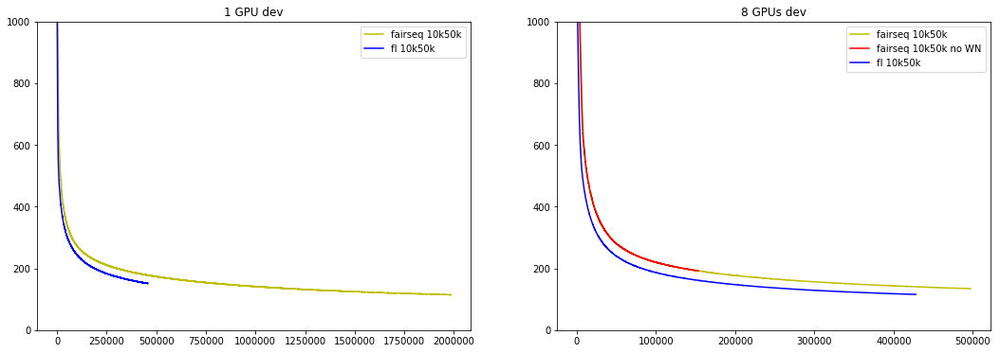

In [8]:
plt.figure(figsize=(18, 6))

## 1 GPU
plt.subplot(121)
# plt.plot(x_1g, y_1g_valid[:len(x_1g)], 'r', label='fairseq 60k160k')
# plt.plot(fl_x_1g, fl_y_1g_valid, 'g', label='fl 60k160k')

plt.plot(x_1g_10k50k, y_1g_10k50k_valid[:len(x_1g_10k50k)], 'y', label='fairseq 10k50k')
plt.plot(fl_x_1g_10k50k, fl_y_1g_10k50k_valid, 'b', label='fl 10k50k')

plt.ylim(0,1000)
plt.title('1 GPU dev')
plt.legend()

## 8 GPU
plt.subplot(122)
# plt.plot(x_8g, y_8g_valid[:len(x_8g)], 'r', label='fairseq 60k160k')
# plt.plot(x_8g_fp32, y_8g_fp32_valid[:len(x_8g_fp32)], 'black', label='fairseq 60k160k fp 32')
# plt.plot(fl_x_8g, fl_y_8g_valid, 'g', label='fl 60k160k')

plt.plot(x_8g_10k50k, y_8g_10k50k_valid[:len(x_8g_10k50k)], 'y', label='fairseq 10k50k')
plt.plot(x_8g_nown, y_8g_nown_valid[:len(x_8g_nown)], 'r', label='fairseq 10k50k no WN')
plt.plot(fl_x_8g_10k50k, fl_y_8g_10k50k_valid, 'b', label='fl 10k50k')

plt.ylim(0,1000)
plt.title('8 GPUs dev')
plt.legend()

plt.show()

In [17]:
def get_log(filename):
    with open(filename) as f:
        fl_x = []
        fl_y_valid = []
        fl_y_train = []
        for line in f:
            if not "PPL" in line:
                continue

            try:
                m = re.search('.*batch=(.+?)/.*', line)
                fl_x.append(int(m.group(1)))
                m = re.search('.* PPL: (.+?) .*', line)
                fl_y_train.append(float(m.group(1)))
                m = re.search('.* PPL: (.+?)$', line)
                fl_y_valid.append(float(m.group(1)))
            except:
                print(line)
    
    return np.array(fl_x), np.array(fl_y_valid), np.array(fl_y_train)

rundir = '/private/home/qiantong/tmp/lm_logs/'

wn_x, wn_y_valid, wn_y_train = get_log(os.path.join(rundir, '8g_wn.log'))
nown_x, nown_y_valid, nown_y_train = get_log(os.path.join(rundir, '8g_nown.log'))


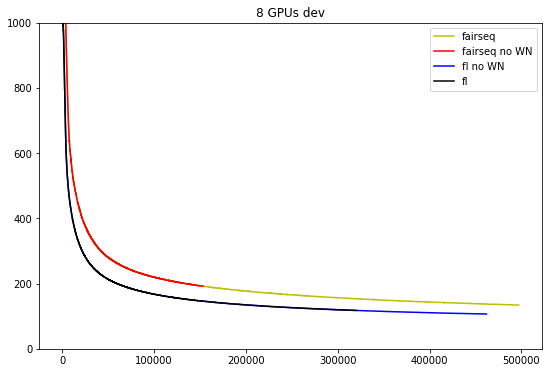

In [18]:
plt.figure(figsize=(9, 6))



plt.plot(x_8g_10k50k, y_8g_10k50k_valid[:len(x_8g_10k50k)], 'y', label='fairseq')
plt.plot(x_8g_nown, y_8g_nown_valid[:len(x_8g_nown)], 'r', label='fairseq no WN')

plt.plot(nown_x, nown_y_valid, 'blue', label='fl no WN')
plt.plot(wn_x, wn_y_valid, 'black', label='fl')


plt.ylim(0,1000)
plt.title('8 GPUs dev')
plt.legend()

plt.show()

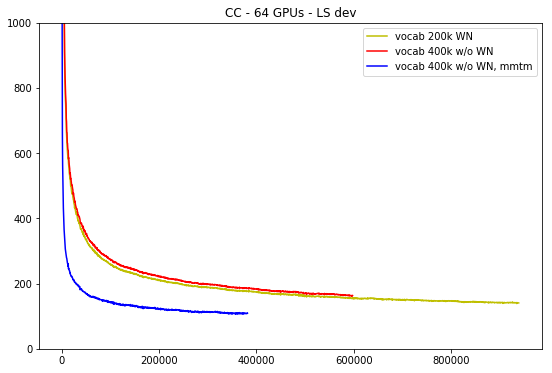

In [65]:
cc_1_x, cc_1_y_valid, cc_1_y_train = get_log('/checkpoint/qiantong/fl_lm/test/test-1/log')
cc_3_x, cc_3_y_valid, cc_3_y_train = get_log('/checkpoint/qiantong/fl_lm/test/test-3/log')
cc_4_x, cc_4_y_valid, cc_4_y_train = get_log('/checkpoint/qiantong/fl_lm/test/test-4/log')

plt.figure(figsize=(9, 6))


plt.plot(cc_1_x, cc_1_y_valid[:len(cc_1_x)], 'y', label='vocab 200k WN')
plt.plot(cc_3_x, cc_3_y_valid[:len(cc_3_x)], 'r', label='vocab 400k w/o WN')
plt.plot(cc_4_x, cc_4_y_valid[:len(cc_4_x)], 'b', label='vocab 400k w/o WN, mmtm')


plt.ylim(0,1000)
plt.title('CC - 64 GPUs - LS dev')
plt.legend()

plt.show()

In [68]:
dic = {}
with open('/private/home/qiantong/tmp/test.txt') as f:
    for line in f:
        words = line.strip().split()
        for w in words:
            if not w in dic:
                dic[w] = 0
            dic[w] += 1

sorted_d = sorted(dic.items(), key=lambda x: x[1])
print(len(sorted_d))
for item in sorted_d[::-1]:
    print(item)

4859
('the', 1143)
('and', 637)
('of', 626)
('to', 503)
('a', 440)
('in', 341)
('he', 267)
('i', 246)
('was', 245)
('his', 226)
('that', 205)
('it', 194)
('with', 160)
('is', 149)
('for', 147)
('had', 134)
('as', 133)
('you', 133)
('on', 118)
('but', 114)
('at', 114)
('she', 114)
('her', 113)
('him', 108)
('be', 102)
('not', 101)
('by', 100)
('this', 94)
('from', 91)
('have', 88)
('they', 84)
('all', 81)
('one', 78)
('so', 76)
('which', 75)
('if', 69)
('an', 65)
('there', 62)
('my', 62)
('their', 62)
('me', 61)
('would', 61)
('who', 61)
('said', 60)
('or', 60)
('what', 60)
('no', 59)
('them', 57)
('up', 57)
('were', 57)
('we', 55)
('are', 54)
('been', 50)
('out', 50)
('when', 49)
('then', 46)
('very', 38)
('could', 36)
('some', 35)
('do', 35)
('now', 34)
('into', 34)
('like', 34)
('than', 34)
('upon', 33)
('will', 33)
('more', 33)
('about', 32)
('time', 32)
('down', 31)
('man', 30)
('good', 30)
('little', 30)
('great', 29)
('while', 28)
('other', 27)
('our', 27)
('any', 27)
('much', 27

('stop', 1)
('urged', 1)
('cameron', 1)
('awoke', 1)
('nurse', 1)
('notion', 1)
('content', 1)
('christ', 1)
('railroads', 1)
('couples', 1)
('bridal', 1)
('instruction', 1)
('sincerity', 1)
('enlightened', 1)
('hearted', 1)
('community', 1)
('seldom', 1)
('persuaded', 1)
('stowe', 1)
('colvin', 1)
('woke', 1)
('bud', 1)
('unfolding', 1)
('matured', 1)
('fulfilled', 1)
('youthful', 1)
('pinnacle', 1)
('papacy', 1)
('protracted', 1)
('speculations', 1)
('campaign', 1)
('interval', 1)
('stir', 1)
('tremendous', 1)
('europe', 1)
('throughout', 1)
('produced', 1)
('decree', 1)
('dependencies', 1)
("england's", 1)
('rule', 1)
('respected', 1)
('introduction', 1)
('ogre', 1)
('treves', 1)
('bernard', 1)
('wondered', 1)
('suit', 1)
('bloodshot', 1)
('nose', 1)
('bulgy', 1)
('bloated', 1)
("captain's", 1)
("pit's", 1)
('ccliv', 1)
('staggering', 1)
('ted', 1)
('collars', 1)
('horrid', 1)
('wearing', 1)
('impulsively', 1)
('collapse', 1)
('total', 1)
('crashes', 1)
('stopping', 1)
('swung', 1)


In [49]:
root = "/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140"

lm_score = []
am_score = []
wer = []

for i in range(64):
    with open("{}/{}.lst".format(root, i)) as f:
        print("{}/{}.lst".format(root, i))
        for line in f:
            sp = line.split('|')
            scores = sp[-1].strip().split()
            lm_score.append(float(scores[0]))
            am_score.append(float(scores[1]))
            wer.append(float(scores[2]))
            
print(len(x))

/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/0.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/1.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/2.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/3.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/4.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/5.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/6.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/7.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/8.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/9.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/10.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/11.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/12.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_140/13.lst
/checkpoint/qiantong/ls_200M/100h/698/generated_pl/epoch_1

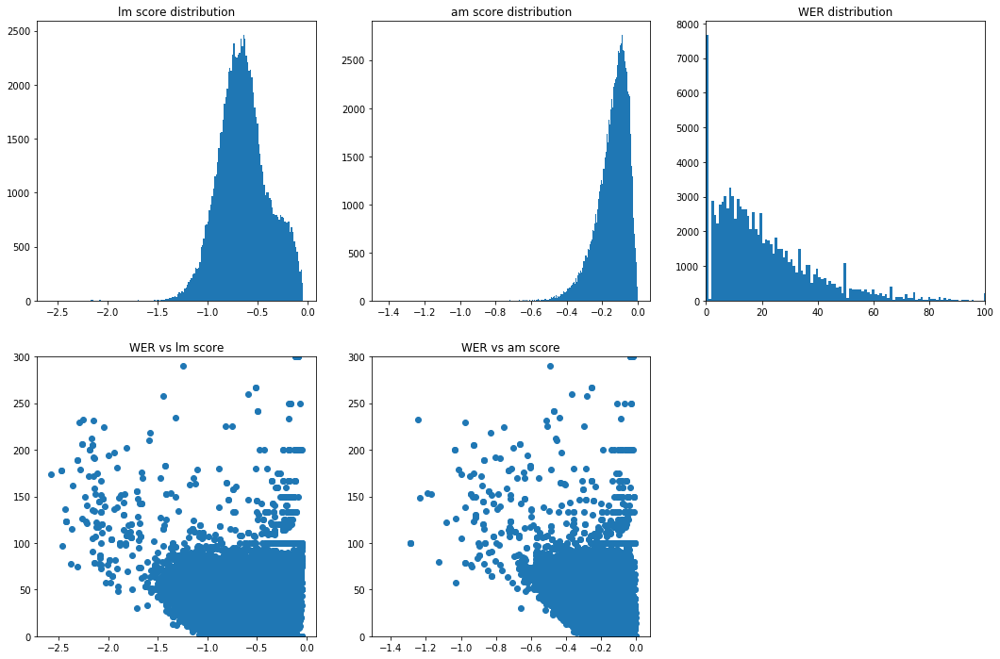

In [52]:
plt.figure(figsize=(18, 12))
n_sample = 100000

plt.subplot(231)
plt.title('lm score distribution')
plt.hist(lm_score[:n_sample], bins='auto')

plt.subplot(232)
plt.title('am score distribution')
plt.hist(am_score[:n_sample], bins='auto')

plt.subplot(233)
plt.title('WER distribution')
plt.hist(wer[:n_sample], bins='auto')
plt.xlim(0, 100)

plt.subplot(234)
plt.title('WER vs lm score')
plt.scatter(lm_score[:n_sample], wer[:n_sample])
plt.ylim(0,300)

plt.subplot(235)
plt.title('WER vs am score')
plt.scatter(am_score[:n_sample], wer[:n_sample])
plt.ylim(0,300)

plt.show()

/checkpoint/qiantong/ls_200M/100h/714/generated_pl/epoch_240


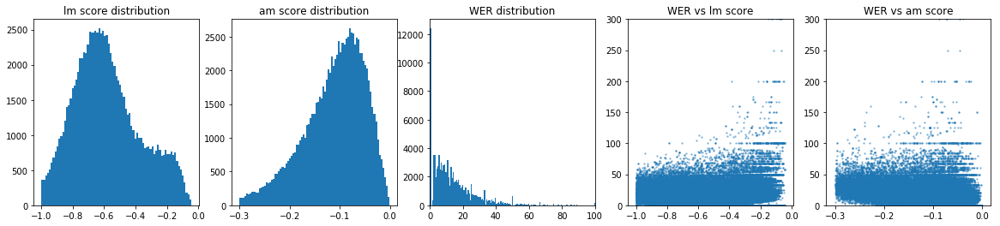

/checkpoint/qiantong/ls_200M/100h/714/generated_pl/epoch_250


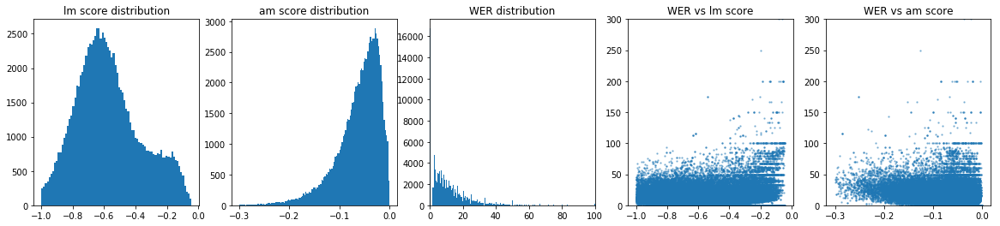

/checkpoint/qiantong/ls_200M/100h/714/generated_pl/epoch_260


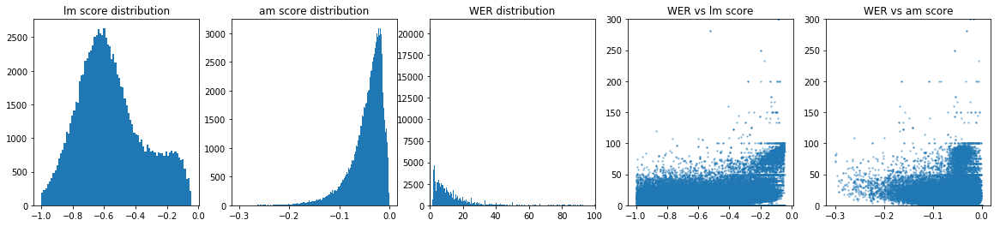

/checkpoint/qiantong/ls_200M/100h/714/generated_pl/epoch_280


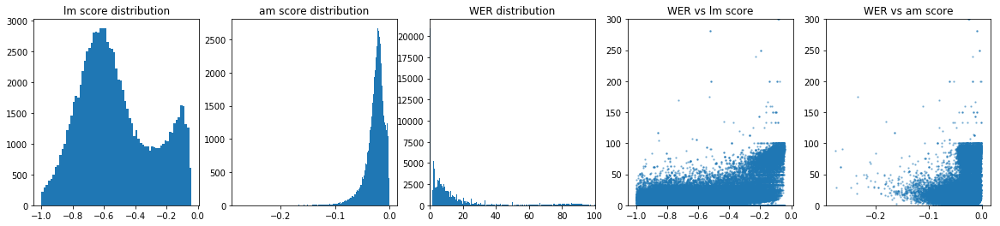

/checkpoint/qiantong/ls_200M/100h/714/generated_pl/epoch_300


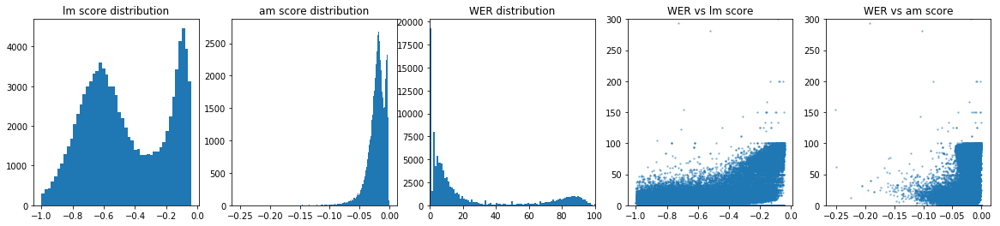

/checkpoint/qiantong/ls_200M/100h/714/generated_pl/epoch_320


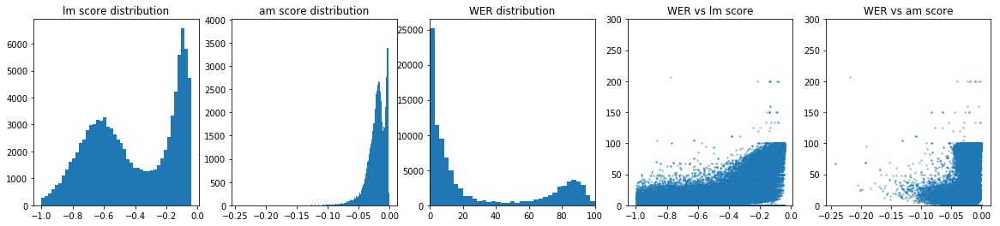

In [75]:
root_t = "/checkpoint/qiantong/ls_200M/100h/714/generated_pl/epoch_{}"

for epoch in [240, 250, 260, 280, 300, 320]:
    root = root_t.format(epoch)
    print(root)
    lm_score = []
    am_score = []
    wer = []

    for i in range(64):
        with open("{}/{}.lst".format(root, i)) as f:
            # print("{}/{}.lst".format(root, i))
            for line in f:
                sp = line.split('|')
                scores = sp[-1].strip().split()
                lm_score.append(float(scores[0]))
                am_score.append(float(scores[1]))
                wer.append(float(scores[2]))
            
    plt.figure(figsize=(20, 4))
    n_sample = 100000

    plt.subplot(151)
    plt.title('lm score distribution')
    plt.hist(lm_score[:n_sample], bins='auto')

    plt.subplot(152)
    plt.title('am score distribution')
    plt.hist(am_score[:n_sample], bins='auto')

    plt.subplot(153)
    plt.title('WER distribution')
    plt.hist(wer[:n_sample], bins='auto')
    plt.xlim(0, 100)

    plt.subplot(154)
    plt.title('WER vs lm score')
    plt.scatter(lm_score[:n_sample], wer[:n_sample], alpha=0.4, s=2)
    plt.ylim(0,300)

    plt.subplot(155)
    plt.title('WER vs am score')
    plt.scatter(am_score[:n_sample], wer[:n_sample], alpha=0.4, s=2)
    plt.ylim(0,300)

    plt.show()

In [68]:
root_t = "/checkpoint/qiantong/ls_200M/100h/714/generated_pl/epoch_{}"

for epoch in [240]:#, 250, 260, 280, 300, 320]:
    root = root_t.format(epoch)
    print(root)
    lm_score = []
    am_score = []
    wer = []

    for i in range(64):
        with open("{}/{}.lst".format(root, i)) as f:
            # print("{}/{}.lst".format(root, i))
            for line in f:
                sp = line.split('|')
                scores = sp[-1].strip().split()
                lm_score.append(float(scores[0]))
                am_score.append(float(scores[1]))
                w = float(scores[2])
                wer.append(w)
                
                if w > 100:
                    print(line)

/checkpoint/qiantong/ls_200M/100h/714/generated_pl/epoch_240
train-other-500-780-126736-0033 /datasets01/librispeech/062419/train-other-500/780/126736/780-126736-0033.flac 1650.0 this is the englishman | -0.0719563 -0.0562051 133.333

train-other-500-7376-96150-0034 /datasets01/librispeech/062419/train-other-500/7376/96150/7376-96150-0034.flac 2560.0 it has an articles taught to me | -0.151689 -0.126718 116.667

train-other-500-1614-141486-0035 /datasets01/librispeech/062419/train-other-500/1614/141486/1614-141486-0035.flac 3225.0 to be neglected with a flavy defends and caresses | -0.275039 -0.133491 116.667

train-other-500-6548-39672-0015 /datasets01/librispeech/062419/train-other-500/6548/39672/6548-39672-0015.flac 3415.0 that is not so sure of such a love and done | -0.190086 -0.105783 114.286

train-other-500-2792-144136-0042 /datasets01/librispeech/062419/train-other-500/2792/144136/2792-144136-0042.flac 3915.0 how she thought she wouldn't be a mazines my god she cried | -0.2982

train-clean-360-986-129388-0082 /datasets01/librispeech/062419/train-clean-360/986/129388/986-129388-0082.flac 1995.0 think i am going | -0.0745672 -0.0699945 400

train-clean-360-6727-10344-0005 /datasets01/librispeech/062419/train-clean-360/6727/10344/6727-10344-0005.flac 2009.9999999999998 further dying a few days | -0.124151 -0.0891688 200

train-clean-360-28-12332-0094 /datasets01/librispeech/062419/train-clean-360/28/12332/28-12332-0094.flac 2180.0 yes none was said | -0.117208 -0.0472512 150

train-other-500-3647-134419-0010 /datasets01/librispeech/062419/train-other-500/3647/134419/3647-134419-0010.flac 2300.0 and i am contented to go | -0.0996598 -0.0990197 125

train-other-500-133-142924-0011 /datasets01/librispeech/062419/train-other-500/133/142924/133-142924-0011.flac 2830.0 dubbed like a bit don't you get up | -0.186515 -0.13623 160

train-other-500-3796-16815-0031 /datasets01/librispeech/062419/train-other-500/3796/16815/3796-16815-0031.flac 4170.0 synams dejected and mas

train-other-500-5468-55142-0029 /datasets01/librispeech/062419/train-other-500/5468/55142/5468-55142-0029.flac 2845.0 boasts that clad all lain boldly | -0.227148 -0.043015 125

train-other-500-127-129385-0094 /datasets01/librispeech/062419/train-other-500/127/129385/127-129385-0094.flac 3850.0 was the dining at bung couple | -0.231988 -0.102267 120

train-other-500-4189-274546-0010 /datasets01/librispeech/062419/train-other-500/4189/274546/4189-274546-0010.flac 4054.9999999999995 of delegates see also blend a visit to dervish the end of us | -0.337846 -0.168387 142.857

train-other-500-7848-275149-0006 /datasets01/librispeech/062419/train-other-500/7848/275149/7848-275149-0006.flac 5105.0 she answered this is the woman missus fishermen missus spencer to be glad | -0.26901 -0.163066 142.857

train-other-500-7492-105653-0015 /datasets01/librispeech/062419/train-other-500/7492/105653/7492-105653-0015.flac 6020.0 had a quiet and no sours him on the thighs root equal thomas flamma to ohio 

train-clean-360-3927-6556-0063 /datasets01/librispeech/062419/train-clean-360/3927/6556/3927-6556-0063.flac 1365.0 first day | -0.0612631 -0.0116962 200

train-clean-360-210-129396-0160 /datasets01/librispeech/062419/train-clean-360/210/129396/210-129396-0160.flac 1535.0 brought it | -0.0646836 -0.0153108 200

train-other-500-8328-280925-0139 /datasets01/librispeech/062419/train-other-500/8328/280925/8328-280925-0139.flac 2765.0 i am in a little period of arms | -0.137393 -0.124288 120

train-other-500-6962-47545-0047 /datasets01/librispeech/062419/train-other-500/6962/47545/6962-47545-0047.flac 2810.0 that they are freshness a sign of food | -0.170023 -0.0870976 175

train-other-500-2792-152929-0021 /datasets01/librispeech/062419/train-other-500/2792/152929/2792-152929-0021.flac 3600.0 the sun was slipping sing up like eights and muses | -0.265802 -0.16569 112.5

train-other-500-202-129387-0064 /datasets01/librispeech/062419/train-other-500/202/129387/202-129387-0064.flac 1870.0 ex co

/checkpoint/qiantong/ls_200M/100h/716/generated_pl/epoch_140


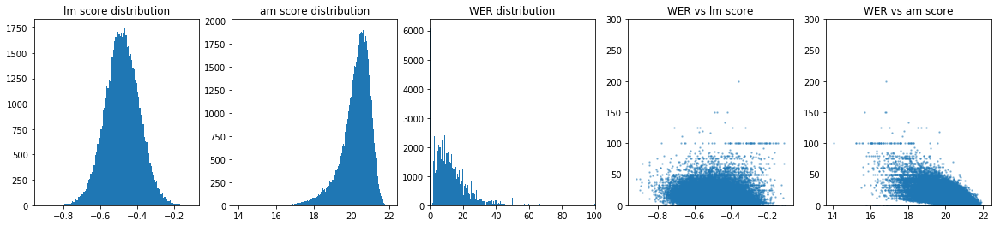

/checkpoint/qiantong/ls_200M/100h/716/generated_pl/epoch_150


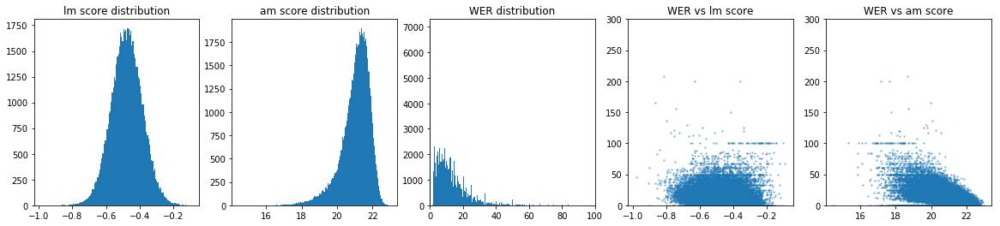

/checkpoint/qiantong/ls_200M/100h/716/generated_pl/epoch_160


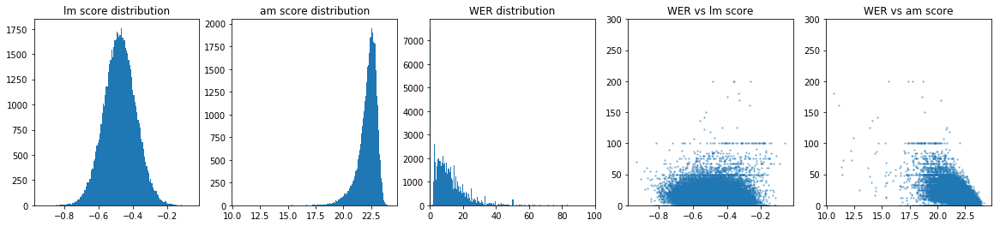

/checkpoint/qiantong/ls_200M/100h/716/generated_pl/epoch_170


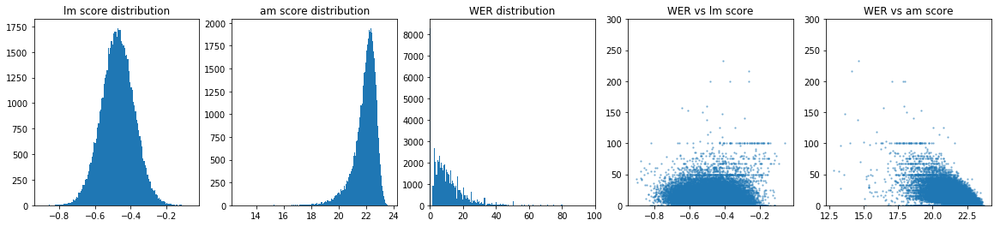

In [74]:
root_t = "/checkpoint/qiantong/ls_200M/100h/716/generated_pl/epoch_{}"

for epoch in [140, 150, 160, 170]:
    root = root_t.format(epoch)
    print(root)
    lm_score = []
    am_score = []
    wer = []

    for i in range(64):
        with open("{}/{}.lst".format(root, i)) as f:
            # print("{}/{}.lst".format(root, i))
            for line in f:
                sp = line.split('|')
                scores = sp[-1].strip().split()
                lm_score.append(float(scores[0]))
                am_score.append(float(scores[1]))
                wer.append(float(scores[2]))
            
    plt.figure(figsize=(20, 4))
    n_sample = 100000

    plt.subplot(151)
    plt.title('lm score distribution')
    plt.hist(lm_score[:n_sample], bins='auto')

    plt.subplot(152)
    plt.title('am score distribution')
    plt.hist(am_score[:n_sample], bins='auto')

    plt.subplot(153)
    plt.title('WER distribution')
    plt.hist(wer[:n_sample], bins='auto')
    plt.xlim(0, 100)

    plt.subplot(154)
    plt.title('WER vs lm score')
    plt.scatter(lm_score[:n_sample], wer[:n_sample], alpha=0.4, s=2)
    plt.ylim(0,300)

    plt.subplot(155)
    plt.title('WER vs am score')
    plt.scatter(am_score[:n_sample], wer[:n_sample], alpha=0.4, s=2)
    plt.ylim(0,300)

    plt.show()

/checkpoint/qiantong/ls_200M/100h/715/generated_pl/epoch_240


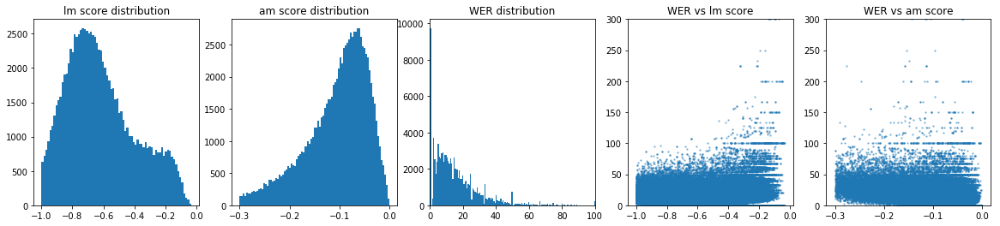

/checkpoint/qiantong/ls_200M/100h/715/generated_pl/epoch_250


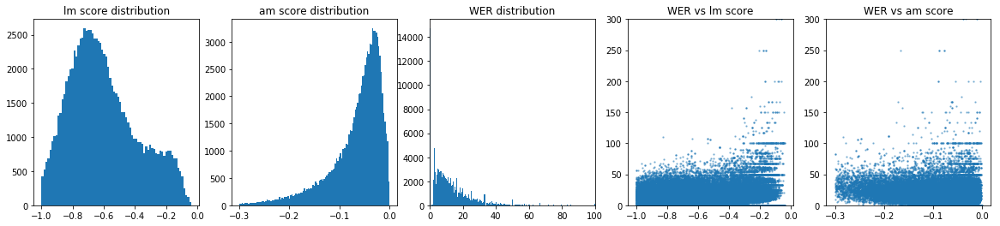

/checkpoint/qiantong/ls_200M/100h/715/generated_pl/epoch_260


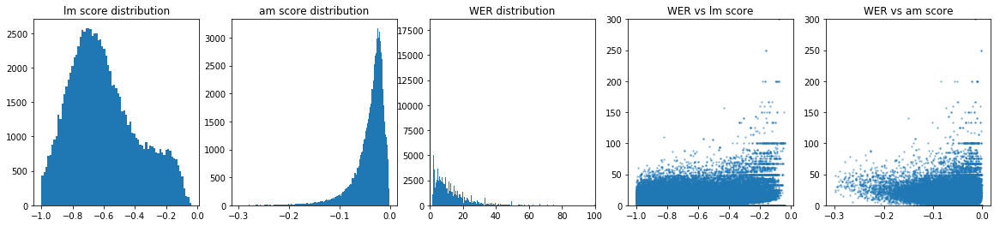

/checkpoint/qiantong/ls_200M/100h/715/generated_pl/epoch_280


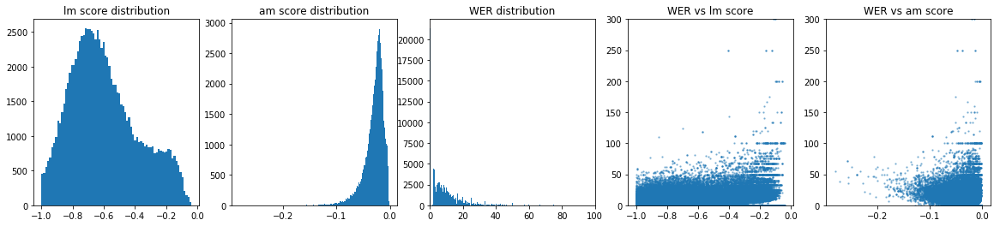

/checkpoint/qiantong/ls_200M/100h/715/generated_pl/epoch_300


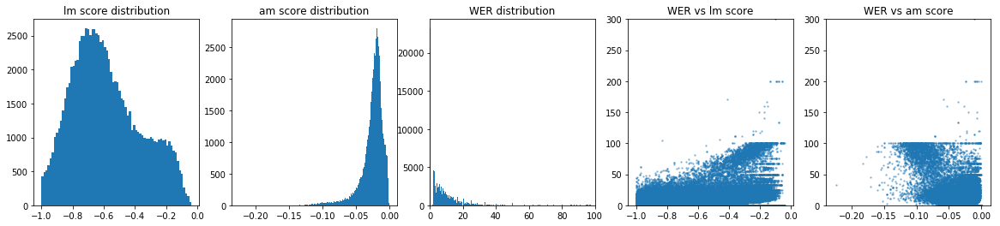

/checkpoint/qiantong/ls_200M/100h/715/generated_pl/epoch_320


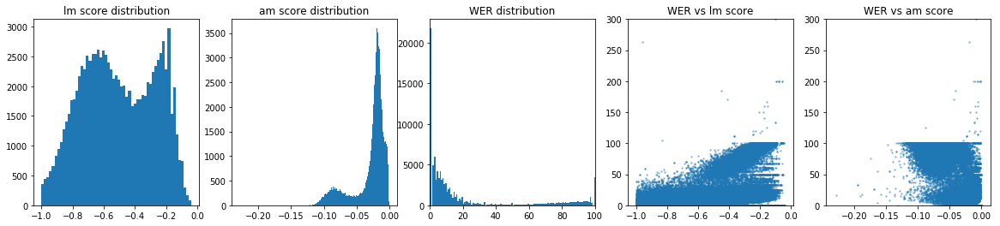

In [73]:
root_t = "/checkpoint/qiantong/ls_200M/100h/715/generated_pl/epoch_{}"

for epoch in [240, 250, 260, 280, 300, 320]:
    root = root_t.format(epoch)
    print(root)
    lm_score = []
    am_score = []
    wer = []

    for i in range(64):
        with open("{}/{}.lst".format(root, i)) as f:
            # print("{}/{}.lst".format(root, i))
            for line in f:
                sp = line.split('|')
                scores = sp[-1].strip().split()
                lm_score.append(float(scores[0]))
                am_score.append(float(scores[1]))
                wer.append(float(scores[2]))
            
    plt.figure(figsize=(20, 4))
    n_sample = 100000

    plt.subplot(151)
    plt.title('lm score distribution')
    plt.hist(lm_score[:n_sample], bins='auto')

    plt.subplot(152)
    plt.title('am score distribution')
    plt.hist(am_score[:n_sample], bins='auto')

    plt.subplot(153)
    plt.title('WER distribution')
    plt.hist(wer[:n_sample], bins='auto')
    plt.xlim(0, 100)

    plt.subplot(154)
    plt.title('WER vs lm score')
    plt.scatter(lm_score[:n_sample], wer[:n_sample], alpha=0.4, s=2)
    plt.ylim(0,300)

    plt.subplot(155)
    plt.title('WER vs am score')
    plt.scatter(am_score[:n_sample], wer[:n_sample], alpha=0.4, s=2)
    plt.ylim(0,300)

    plt.show()

## speaker

In [4]:
speakers_file = '/datasets01/librispeech/062419/SPEAKERS.TXT'


with open(speakers_file) as f:
    valid_speakers = set([])
    test_speakers = set([])
    train_speakers = set([])
    for line in f:
        if line[0] == ';':
            continue
            
        sp = line.split('|')
        if 'train' in sp[2]:
            train_speakers.add(sp[0].strip())
        elif 'dev' in sp[2]:
            valid_speakers.add(sp[0].strip())
        elif 'test' in sp[2]:
            test_speakers.add(sp[0].strip())
        else:
            print('WTF', line)

In [5]:
print(len(valid_speakers), valid_speakers)
print(len(test_speakers), test_speakers)
print(len(train_speakers), train_speakers)

73 {'1630', '3660', '8254', '116', '3576', '3000', '4570', '1686', '5849', '5694', '8842', '5895', '6295', '2078', '2428', '6841', '1988', '6345', '8288', '251', '3752', '4153', '2035', '8297', '174', '4515', '7697', '84', '6599', '2902', '2277', '6123', '1673', '4572', '1462', '5338', '1272', '1651', '4323', '422', '6241', '7641', '3915', '6319', '700', '4831', '1255', '1919', '2506', '5543', '7601', '7976', '1701', '2086', '1993', '3170', '3536', '7850', '6313', '5536', '652', '777', '3663', '3853', '1650', '2412', '6267', '3081', '6467', '1585', '6455', '8173', '2803'}
73 {'6070', '6930', '7018', '4507', '2094', '4294', '7729', '1284', '3538', '3331', '61', '3997', '7021', '533', '8224', '7902', '7105', '1089', '2300', '4198', '5105', '2609', '2033', '2414', '3575', '5442', '6128', '672', '1995', '8555', '2830', '908', '4446', '5484', '8455', '7975', '2961', '3005', '1688', '3080', '4970', '4852', '6829', '1580', '5142', '5639', '3764', '5683', '8280', '5764', '8463', '3729', '237',

In [7]:
a = "{'1630', '3660', '8254', '116', '3576', '3000', '4570', '1686', '5849', '5694', '8842', '5895', '6295', '2078', '2428', '6841', '1988', '6345', '8288', '251', '3752', '4153', '2035', '8297', '174', '4515', '7697', '84', '6599', '2902', '2277', '6123', '1673', '4572', '1462', '5338', '1272', '1651', '4323', '422', '6241', '7641', '3915', '6319', '700', '4831', '1255', '1919', '2506', '5543', '7601', '7976', '1701', '2086', '1993', '3170', '3536', '7850', '6313', '5536', '652', '777', '3663', '3853', '1650', '2412', '6267', '3081', '6467', '1585', '6455', '8173', '2803'}"
b = eval(a)
print(b)
print('116' in b)

{'1630', '3660', '8254', '116', '3576', '3000', '4570', '1686', '5849', '5694', '8842', '5895', '6295', '2428', '6841', '2078', '1988', '6345', '8288', '251', '3752', '4153', '2035', '8297', '174', '4515', '7697', '84', '6599', '2902', '2277', '6123', '1673', '4572', '1462', '5338', '1272', '1651', '4323', '422', '6241', '7641', '3915', '6319', '700', '4831', '1255', '1919', '2506', '5543', '7601', '7976', '1701', '2086', '1993', '3170', '3536', '7850', '6313', '5536', '652', '777', '3663', '3853', '1650', '2412', '6267', '3081', '6467', '1585', '6455', '8173', '2803'}
True


In [4]:
with open('/checkpoint/antares/datasets/librispeech/lists/dev-other.lst') as f:
    maxl = 0
    for line in f:
        sp = line.split()
        maxl = max(maxl, len(sp) - 3)
    print(maxl)

77


In [2]:
ids = []
with open('/private/home/qiantong/tmp/decoder_sweep/jobs/rs_815') as f:
    for line in f:
        sp = line.strip().split()
        ids.append(sp[-1])

In [3]:
print(len(ids))

500


In [4]:
def parse_decoder_file(log_file):
    with open(log_file) as f:
        lines = f.readlines()
    lines = [line.strip()[3:] for line in lines][1:]
    flags = ''
    for line in lines:
        if line[0] == 'I':
            break
        flags += line
    summary = lines[-1]
#     print(flags)
#     print(summary)
    m = re.search('.*--lmweight=(.+?);.*', flags)
    lmweight = float(m.group(1))
    m = re.search('.*--wordscore=(.+?);.*', flags)
    wordscore = float(m.group(1))
    m = re.search('.*--tr_lmwight=(.+?);.*', flags)
    tr_lmwight = float(m.group(1))
    m = re.search('.*--tr_wordscore=(.+?);.*', flags)
    tr_wordscore = float(m.group(1))
    
    m = re.search('.*WER: (.+?),.*', summary)
    wer = float(m.group(1))
    
    return lmweight, wordscore, tr_lmwight, tr_wordscore, wer
    

In [72]:
log_template = '/checkpoint/qiantong/decoder_sweep/decode_{}.err'

N = 10
wer_mat_10 = np.ones([N, N]) * 99
best_param = {}

for id in ids:
    log_file = log_template.format(id)
    try:
        lmweight, wordscore, tr_lmwight, tr_wordscore, wer = parse_decoder_file(log_file)
#         print(lmweight, wordscore, tr_lmwight, tr_wordscore, wer)

        x = int(lmweight * 5)
        y = int(tr_lmwight * 5)

        if wer > wer_mat_10[x][y]:
            continue
            
        wer_mat_10[x][y] = wer
        if x not in best_param:
            best_param[x] = {}
        best_param[x][y] = [lmweight, wordscore, tr_lmwight, tr_wordscore]
    except:
        print(log_file)
    
print(wer_mat_10)


N = 20
wer_mat_20 = np.ones([N, N]) * 99
best_param = {}

for id in ids:
    log_file = log_template.format(id)
    try:
        lmweight, wordscore, tr_lmwight, tr_wordscore, wer = parse_decoder_file(log_file)
#         print(lmweight, wordscore, tr_lmwight, tr_wordscore, wer)

        x = int(lmweight * 10)
        y = int(tr_lmwight * 10)

        if wer > wer_mat_20[x][y]:
            continue
            
        wer_mat_20[x][y] = wer
        if x not in best_param:
            best_param[x] = {}
        best_param[x][y] = [lmweight, wordscore, tr_lmwight, tr_wordscore]
    except:
        print(log_file)
    
print(wer_mat_20)

/checkpoint/qiantong/decoder_sweep/decode_27207241.err
/checkpoint/qiantong/decoder_sweep/decode_27207460.err
[[ 8.3281   7.98265  7.95713  7.98461  8.05331  8.12593  8.27118  8.45568
   8.66177  8.84431]
 [ 8.21033  8.04742  7.93162  7.91591  8.02779  8.15145  8.36932  8.46549
   8.62448  8.88553]
 [ 8.36539  7.99246  7.84525  7.9218   7.97284  8.12004  8.37717  8.50279
   8.75402  8.83646]
 [ 8.60289  7.99835  7.88058  7.86684  8.12201  8.38502  8.4125   8.66962
   8.92675  9.42137]
 [ 9.16425  7.94143  7.93358  7.91984  8.01994  8.18285  8.33202  8.80113
   9.01704  9.28201]
 [ 8.27707  8.03761  7.85703  7.9375   7.98854  8.18285  8.59896  8.8345
   9.18584  9.19761]
 [ 8.26333  7.99835  7.87077  7.88058  7.98854  8.45568  8.67748  8.99348
   9.29379  9.63531]
 [ 8.18089  7.93554  7.88647  7.99443  7.96498  8.27903  9.03078  9.26827
   9.29575 10.442  ]
 [ 9.60587  8.02976  7.92965  7.94339  8.03368  8.43213  9.09555  9.45278
   9.78252  9.78252]
 [ 8.69514  7.99835  7.91591  7.9905

In [84]:
print(wer_mat_20[5])

[9.97291 8.36539 8.20837 7.99246 7.94732 7.84525 7.93162 7.95713 7.97284
 8.18678 8.12004 8.71281 8.62055 8.47531 8.96993 8.60289 8.75402 8.83057
 9.52736 9.00526]


In [44]:
print(best_param[5])

{7: [0.585778409267, 1.28997833683, 0.782015058971, 1.92708832418], 13: [0.556778299756, 1.67046224459, 1.32694953772, 1.3839998127], 11: [0.526994820209, 0.0630695176202, 1.18891659164, 0.515096483515], 17: [0.59530727884, 2.76588508611, 1.7407107346, 0.0417942756251], 6: [0.514555490078, 0.139349069386, 0.657683849465, 1.70902777053], 3: [0.530024700684, 0.291053660085, 0.381169372986, 0.263109638463], 16: [0.546238301904, 1.56609994566, 1.65576685271, 2.40601625662], 1: [0.574586801415, 1.21407862746, 0.144474582671, 0.916097476342], 2: [0.540048842683, 2.87922107109, 0.219989380047, 1.19421939402], 12: [0.56627337299, 1.00697030397, 1.25968991936, 0.767869584825], 5: [0.562017568086, 1.31531349259, 0.518064866094, 1.03786114239], 9: [0.584566258945, 1.07237909813, 0.957896979642, 1.16268022509], 18: [0.542284468367, 0.171152709615, 1.86716543339, 1.12495255267], 19: [0.532561657135, 1.64134949439, 1.90785542008, 1.74426657972], 10: [0.571431615327, 2.06177665302, 1.00818200679, 2.5

In [49]:
tmp = """--tr_lmwight={} \
--tr_wordscore={}"""

for i in range(12):
    print(best_param[5][i])
    print(tmp.format(best_param[5][i][2],best_param[5][i][3]))

[0.569727012311, 1.82785761985, 0.0289389051373, 0.515854857535]
--tr_lmwight=0.0289389051373 --tr_wordscore=0.515854857535
[0.574586801415, 1.21407862746, 0.144474582671, 0.916097476342]
--tr_lmwight=0.144474582671 --tr_wordscore=0.916097476342
[0.540048842683, 2.87922107109, 0.219989380047, 1.19421939402]
--tr_lmwight=0.219989380047 --tr_wordscore=1.19421939402
[0.530024700684, 0.291053660085, 0.381169372986, 0.263109638463]
--tr_lmwight=0.381169372986 --tr_wordscore=0.263109638463
[0.588097036907, 2.3974305367, 0.407419515333, 1.91261680537]
--tr_lmwight=0.407419515333 --tr_wordscore=1.91261680537
[0.562017568086, 1.31531349259, 0.518064866094, 1.03786114239]
--tr_lmwight=0.518064866094 --tr_wordscore=1.03786114239
[0.514555490078, 0.139349069386, 0.657683849465, 1.70902777053]
--tr_lmwight=0.657683849465 --tr_wordscore=1.70902777053
[0.585778409267, 1.28997833683, 0.782015058971, 1.92708832418]
--tr_lmwight=0.782015058971 --tr_wordscore=1.92708832418
[0.563679031626, 0.353157131474

In [96]:
wer_tr860 = np.ones([12, 1]) * 99
for i in range(12):
    summary = ''
    
    with open('/checkpoint/qiantong/decoder_sweep/tr_rescore_{}.err'.format(str(i).zfill(2))) as f:
        for line in f:
            if not line.startswith('0: [Decode train-860.lst'):
                continue
            m = re.search('.*\((.+?) samples\).*', line)
            nsample = float(m.group(1))
            m = re.search('.*WER: (.+?),.*', line)
            wer = float(m.group(1))
            summary = '{}, {}'.format(nsample, wer)
            wer_tr860[i] = wer
    print(summary)
print(wer_tr860)

252702.0, 8.34134
252702.0, 6.87432
252702.0, 6.82937
252702.0, 6.59348
252702.0, 6.82698
252702.0, 6.62876
252702.0, 6.68457
252702.0, 6.68205
252702.0, 6.73878
252702.0, 6.61023
252702.0, 6.72087
252702.0, 6.62443
[[8.34134]
 [6.87432]
 [6.82937]
 [6.59348]
 [6.82698]
 [6.62876]
 [6.68457]
 [6.68205]
 [6.73878]
 [6.61023]
 [6.72087]
 [6.62443]]


In [156]:
wer_tr860_25p = np.ones([12, 1]) * 99

with open('/private/home/qiantong/tmp/decoder_sweep/jobs/rs_815_train') as f:
    for line in f:
        sp = line.strip().split()
        id = sp[-1]
        log_file = log_template.format(id)
        try:
            lmweight, wordscore, tr_lmwight, tr_wordscore, wer = parse_decoder_file(log_file)

            y = int(tr_lmwight * 10)

            if wer > wer_tr860_25p[y]:
                continue

            wer_tr860_25p[y] = wer
        except:
            print(log_file)
            
print(wer_tr860_25p)

/checkpoint/qiantong/decoder_sweep/decode_27361838.err
[[8.51231]
 [6.39534]
 [6.41583]
 [6.27569]
 [6.30345]
 [6.10294]
 [6.16431]
 [6.21156]
 [6.17123]
 [6.14407]
 [6.19533]
 [6.17223]]


Text(0.87, 0.92, '(c)')

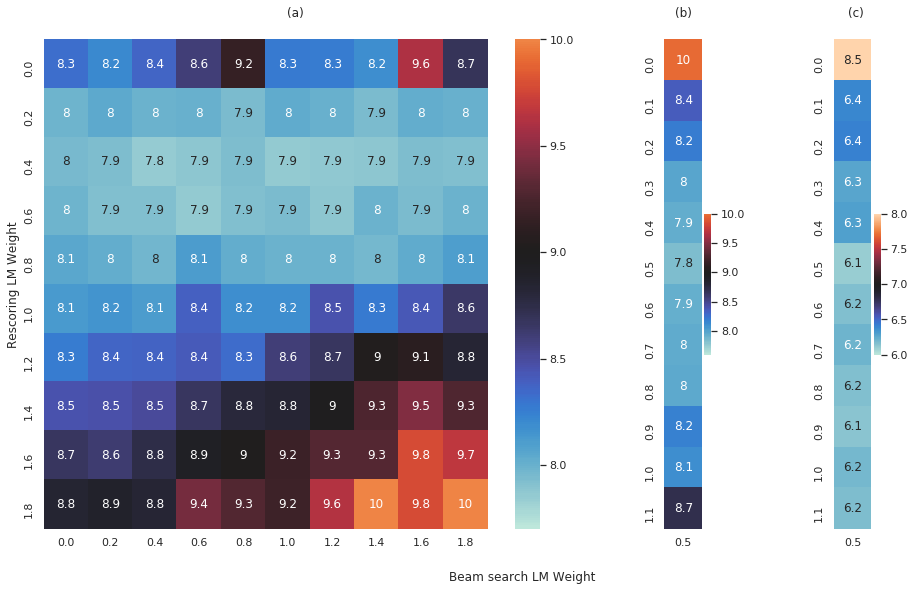

In [159]:
import seaborn as sns; sns.set()
import matplotlib.gridspec as gridspec

# Plot figure with subplots of different sizes
fig = plt.figure(figsize=(15, 9))
# set up subplot grid
gridspec.GridSpec(1,15)

# lmw vs tr_lmw
ax = plt.subplot2grid((1,15), (0,0), colspan=10, rowspan=1)

ticks = ['{0:.1f}'.format(2 / 10 * i) for i in range(10)]
ax = sns.heatmap(wer_mat_10.transpose(), vmin=7.7, vmax=10, annot=True, center=9)
ax.set(ylabel='Rescoring LM Weight', xticklabels=ticks, yticklabels=ticks)

# Dev
ticks = ['{0:.1f}'.format(0.1 * i) for i in range(12)]
ax = plt.subplot2grid((1,15), (0,11), colspan=1, rowspan=1)

ax = sns.heatmap(wer_mat_20[5][:12].reshape(12,1), vmin=7.6, vmax=10, annot=True, center=9)
ax.set(xticklabels=[0.5], yticklabels=ticks)

# Train
ax = plt.subplot2grid((1,15), (0,14), colspan=1, rowspan=1)

ax = sns.heatmap(wer_tr860_25p, vmin=6.0, vmax=8, annot=True, center=7)
ax.set(xticklabels=[0.5], yticklabels=ticks)

# plt.xlabel('BS LM Weight')
fig.text(0.5, 0.05, "Beam search LM Weight", va="center")
fig.text(0.35, 0.92, "(a)", va="center")
fig.text(0.71, 0.92, "(b)", va="center")
fig.text(0.87, 0.92, "(c)", va="center")


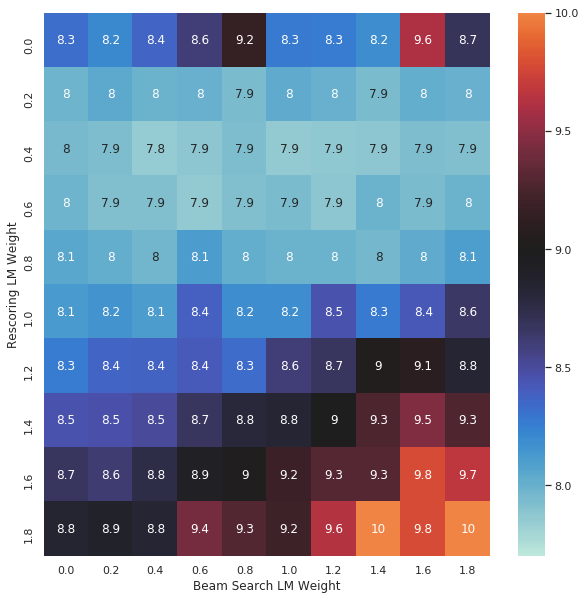

In [169]:
import seaborn as sns; sns.set()
import matplotlib.gridspec as gridspec

# Plot figure with subplots of different sizes
ticks = ['{0:.1f}'.format(2 / 10 * i) for i in range(10)]
fig = plt.figure(figsize=(10, 10))
ax = sns.heatmap(wer_mat_10.transpose(), vmin=7.7, vmax=10, annot=True, center=9)
ax.set(ylabel='Rescoring LM Weight', xlabel='Beam Search LM Weight', xticklabels=ticks, yticklabels=ticks)

# # Dev
# ticks = ['{0:.1f}'.format(0.1 * i) for i in range(12)]
# ax = plt.subplot2grid((1,15), (0,11), colspan=1, rowspan=1)

# ax = sns.heatmap(wer_mat_20[5][:12].reshape(12,1), vmin=7.6, vmax=10, annot=True, center=9)
# ax.set(xticklabels=[0.5], yticklabels=ticks)

# # Train
# ax = plt.subplot2grid((1,15), (0,14), colspan=1, rowspan=1)

# ax = sns.heatmap(wer_tr860_25p, vmin=6.0, vmax=8, annot=True, center=7)
# ax.set(xticklabels=[0.5], yticklabels=ticks)

# # plt.xlabel('BS LM Weight')
# fig.text(0.5, 0.05, "Beam search LM Weight", va="center")
# fig.text(0.35, 0.92, "(a)", va="center")
# fig.text(0.71, 0.92, "(b)", va="center")
# fig.text(0.87, 0.92, "(c)", va="center")

fig.savefig('/private/home/qiantong/tmp/hm.pdf')  

In [172]:
wer_poor_tr860_25p_train = np.ones([12, 1]) * 99

with open('/private/home/qiantong/tmp/decoder_sweep/jobs/rs_843_train') as f:
    for line in f:
        sp = line.strip().split()
        id = sp[-1]
        log_file = log_template.format(id)
        try:
            lmweight, wordscore, tr_lmwight, tr_wordscore, wer = parse_decoder_file(log_file)

            y = int(tr_lmwight * 10)

            if wer > wer_poor_tr860_25p_train[y]:
                continue

            wer_poor_tr860_25p_train[y] = wer
        except:
            print(log_file)
            
print(wer_poor_tr860_25p_train)

[[14.1558]
 [12.3416]
 [12.7944]
 [12.5453]
 [12.1852]
 [11.9624]
 [12.1226]
 [12.0241]
 [12.1735]
 [12.1154]
 [12.1212]
 [12.1214]]


In [173]:
wer_poor_tr860_25p_dev = np.ones([12, 1]) * 99

with open('/private/home/qiantong/tmp/decoder_sweep/jobs/rs_843_dev') as f:
    for line in f:
        sp = line.strip().split()
        id = sp[-1]
        log_file = log_template.format(id)
        try:
            lmweight, wordscore, tr_lmwight, tr_wordscore, wer = parse_decoder_file(log_file)

            y = int(tr_lmwight * 10)

            if wer > wer_poor_tr860_25p_dev[y]:
                continue

            wer_poor_tr860_25p_dev[y] = wer
        except:
            print(log_file)
            
print(wer_poor_tr860_25p_dev)

[[26.2719]
 [25.21  ]
 [21.7948]
 [20.8762]
 [20.7133]
 [20.7015]
 [20.6112]
 [20.5621]
 [20.727 ]
 [20.7702]
 [20.6819]
 [20.884 ]]


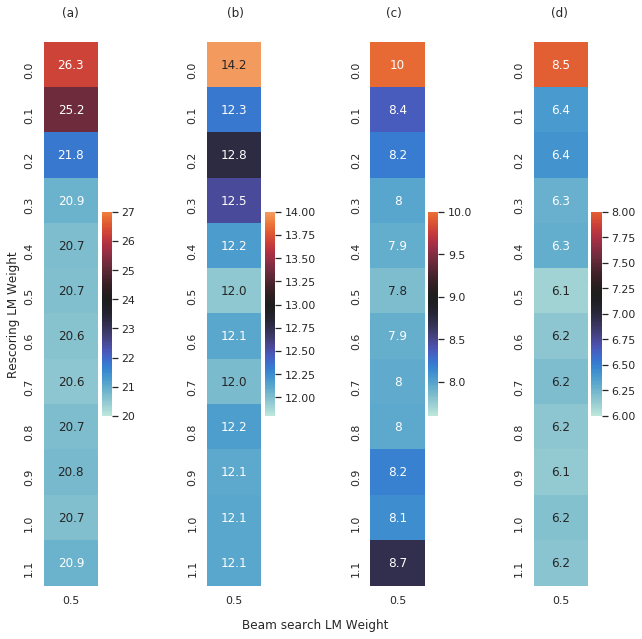

In [198]:
# Plot figure with subplots of different sizes
fig = plt.figure(figsize=(10, 10))
gridspec.GridSpec(1,15)

# Dev
ticks = ['{0:.1f}'.format(0.1 * i) for i in range(12)]
ax = plt.subplot2grid((1,7), (0,0), colspan=1, rowspan=1)

ax = sns.heatmap(wer_poor_tr860_25p_dev, vmin=20, vmax=27, annot=True, center=24, fmt=".1f")
ax.set(ylabel='Rescoring LM Weight', xticklabels=[0.5], yticklabels=ticks)

# Train
ax = plt.subplot2grid((1,7), (0,2), colspan=1, rowspan=1)

ax = sns.heatmap(wer_poor_tr860_25p_train, vmin=11.8, vmax=14, annot=True, center=13, fmt=".1f")
ax.set(xticklabels=[0.5], yticklabels=ticks)

# Dev
ticks = ['{0:.1f}'.format(0.1 * i) for i in range(12)]
ax = plt.subplot2grid((1,7), (0,4), colspan=1, rowspan=1)

ax = sns.heatmap(wer_mat_20[5][:12].reshape(12,1), vmin=7.6, vmax=10, annot=True, center=9)
ax.set(xticklabels=[0.5], yticklabels=ticks)

# Train
ax = plt.subplot2grid((1,7), (0,6), colspan=1, rowspan=1)

ax = sns.heatmap(wer_tr860_25p, vmin=6.0, vmax=8, annot=True, center=7.2)
ax.set(xticklabels=[0.5], yticklabels=ticks)

# plt.xlabel('BS LM Weight')
fig.text(0.4, 0.07, "Beam search LM Weight", va="center")
fig.text(0.15, 0.92, "(a)", va="center")
fig.text(0.38, 0.92, "(b)", va="center")
fig.text(0.60, 0.92, "(c)", va="center")
fig.text(0.83, 0.92, "(d)", va="center")

fig.savefig('/private/home/qiantong/tmp/param_match.pdf')  

In [4]:
with open('/private/home/qiantong/w2v/data/lexicon_ltr2.lst') as fin:
    with open('/private/home/qiantong/w2v/data/lexicon_low.lst', 'w') as fout:
        for line in fin:
            sp = line.strip().split()
            sp[0] = sp[0].lower()
            fout.write(' '.join(sp) + '\n')

In [6]:
with open('/private/home/qiantong/w2v/data/dev_other.wrd') as fin:
    with open('/private/home/qiantong/w2v/data/lower_case/dev_other.wrd', 'w') as fout:
        for line in fin:
            fout.write(line.lower())

In [10]:
nlines = 3655361
with open('/private/home/qiantong/w2v/data/librivox/train.ltr', 'w') as fout:
    for _ in range(nlines):
        fout.write('|\n')
        
nlines = 15963721
with open('/private/home/qiantong/w2v/data/librivox/train_36s.ltr', 'w') as fout:
    for _ in range(nlines):
        fout.write('|\n')

In [10]:
with open('/private/home/qiantong/w2v/data/lower_case/test_other.ltr') as f:
    with open('/private/home/qiantong/w2v/data/lower_case/test_other.wrd', 'w') as fout:
        for line in f:
            line = ''.join(line.strip().split()).split('|')
            line = ' '.join(line[:-1]).lower()
            fout.write(line + '\n')
            #break
            

In [16]:
!ls -l /checkpoint/qiantong/w2v/pl/vox2_3n_lv_ls_lv/stderr*  | sort -hr | head -n 58

-rw-rw-r-- 1 qiantong qiantong 6263 Jul 12 15:01 /checkpoint/qiantong/w2v/pl/vox2_3n_lv_ls_lv/stderr_28120170_31.log
-rw-rw-r-- 1 qiantong qiantong 6263 Jul 12 15:01 /checkpoint/qiantong/w2v/pl/vox2_3n_lv_ls_lv/stderr_28120170_30.log
-rw-rw-r-- 1 qiantong qiantong 6262 Jul 12 15:04 /checkpoint/qiantong/w2v/pl/vox2_3n_lv_ls_lv/stderr_28120170_54.log
-rw-rw-r-- 1 qiantong qiantong 6262 Jul 12 15:03 /checkpoint/qiantong/w2v/pl/vox2_3n_lv_ls_lv/stderr_28120170_55.log
-rw-rw-r-- 1 qiantong qiantong 6262 Jul 12 15:03 /checkpoint/qiantong/w2v/pl/vox2_3n_lv_ls_lv/stderr_28120170_49.log
-rw-rw-r-- 1 qiantong qiantong 6262 Jul 12 15:03 /checkpoint/qiantong/w2v/pl/vox2_3n_lv_ls_lv/stderr_28120170_48.log
-rw-rw-r-- 1 qiantong qiantong 6262 Jul 12 15:02 /checkpoint/qiantong/w2v/pl/vox2_3n_lv_ls_lv/stderr_28120170_53.log
-rw-rw-r-- 1 qiantong qiantong 6262 Jul 12 15:02 /checkpoint/qiantong/w2v/pl/vox2_3n_lv_ls_lv/stderr_28120170_52.log
-rw-rw-r-- 1 qiantong qiantong 6262 Jul 12 15:01 /checkpoint/qia

In [14]:
a = ['stderr_28120170_31.log','stderr_28120170_30.log','stderr_28120170_54.log','stderr_28120170_55.log','stderr_28120170_49.log','stderr_28120170_48.log','stderr_28120170_53.log','stderr_28120170_52.log','stderr_28120170_57.log','stderr_28120170_51.log','stderr_28120170_50.log','stderr_28120170_47.log','stderr_28120170_46.log','stderr_28120170_56.log','stderr_28120170_42.log','stderr_28120170_38.log','stderr_28120170_41.log','stderr_28120170_37.log','stderr_28120170_33.log','stderr_28120170_32.log','stderr_28120170_45.log','stderr_28120170_44.log','stderr_28120170_43.log','stderr_28120170_40.log','stderr_28120170_39.log','stderr_28120170_36.log','stderr_28120170_35.log','stderr_28120170_34.log','stderr_28120170_19.log','stderr_28120170_22.log','stderr_28120170_1.log','stderr_28120170_29.log','stderr_28120170_28.log','stderr_28120170_27.log','stderr_28120170_26.log','stderr_28120170_18.log','stderr_28120170_25.log','stderr_28120170_21.log','stderr_28120170_14.log','stderr_28120170_13.log','stderr_28120170_12.log','stderr_28120170_4.log','stderr_28120170_3.log','stderr_28120170_2.log','stderr_28120170_24.log','stderr_28120170_23.log','stderr_28120170_20.log','stderr_28120170_11.log','stderr_28120170_17.log','stderr_28120170_16.log','stderr_28120170_15.log','stderr_28120170_6.log','stderr_28120170_5.log','stderr_28120170_10.log','stderr_28120170_9.log','stderr_28120170_8.log','stderr_28120170_7.log']
print(len(a))
print('---')
res = [0] * len(a)
for aa in a:
    id = int(aa[:-4].split('_')[-1])
    if id > len(a): continue
    res[id-1] = 1
    #print(id)
print(res)

57
---
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


In [3]:
import os
root = '/checkpoint/qiantong/w2v/pl/10m_vox_pl_round2/{}_hypo.word-10m_vox.pt-train_36s_real.txt'

trans = {}
for i in range(400):
    if not os.path.exists(root.format(i)):
        continue
    with open(root.format(i)) as f:
        for line in f:
            line = line.strip()
            try:
                if line.startswith('(None-'):
                    sp = line[:-1].split('-')
                    trans[int(sp[1])] = ''
                else:
                    sp = line[:-1].split(' (None-')
                    trans[int(sp[1])] = sp[0]
            except:
                print(line)
                print(sp)
               
print(len(trans))

15863906


In [4]:
print(len(trans))
sorted_items = sorted(trans.items()) # 15863907

15863906


In [5]:
def w2l(word):
    return " ".join(list(word) + ['|'])

min_duration = 48000
max_duration = 576000

out_dir = "/private/home/qiantong/w2v/data/train_36s_short_10m_rescore_rd2/"

with open('/private/home/qiantong/w2v/data/librivox/train_36s_real.tsv') as ftsv:
    lines = ftsv.readlines()
    with open(out_dir + 'train.tsv', 'w') as fout, open(out_dir + 'train.ltr', 'w') as fltr:
        fout.write(lines[0])
        for i, line in sorted_items:
            line = line.strip()
            if len(line) == 0:
                continue
                
            duration = int(lines[i + 1].split('\t')[-1])
            if duration < min_duration:
                continue
            if duration > max_duration:
                continue

            out_line = ""
            for word in line.upper().split():
                out_line += " " + w2l(word)
            fltr.write(out_line[1:] + '\n')
            fout.write(lines[i + 1])

In [6]:
with open(out_dir + 'train.ltr') as fltr:
    with open(out_dir + 'train.tsv') as ftsv:
        with open('/private/home/qiantong/push_numbers/lists/librivox.cut.sub36s.w2v_pl_10m_rescore_rd2.lst', 'w') as fout:
            lines = ftsv.readlines()
            root = lines[0].strip() + '/'
            for i, line in enumerate(fltr):
                meta = lines[i + 1].strip()
                duration = int(meta.split('\t')[-1]) / 16
                meta = meta.split('\t')[0]
                trans = ' '.join(''.join(line.split(' ')).split('|')).lower()
                #print('\t'.join([str(i), root + meta, str(duration), trans]))
                #break
                fout.write('\t'.join([str(i), root + meta, str(duration), trans]))

In [ ]:
trans_dic = {}
with open('/checkpoint/jacobkahn/icml_2020/pseudo-labeling/lists/librivox.cut.sub36s.no_overlap_lm.lst') as f:
    for line in f:
        line = line.strip().split(' ')
        key = line[1].strip()
        trans_dic[key] = {}
        trans_dic[key]["w2l"] = line[3:]

In [94]:
with open('/private/home/qiantong/w2v/data/librivox/train_36s_short.tsv') as f:
    with open('/private/home/qiantong/w2v/data/librivox/train_36s_real.tsv', 'w') as fout:
        for line in f:
            sp = line.strip().split('\t')
            if len(sp) == 1:
                fout.write(line)
                continue
            
            duration = float(sp[-1]) / 16000
            if duration < 3 or duration > 35:
                continue
            fout.write(line)


In [11]:
print(len(trans_dic))
for i, (k, v) in enumerate(trans_dic.items()):
    print(k, v)
    if i == 10:
        break

def levenshteinDistance(s1, s2):
    if len(s1) > len(s2):
        s1, s2 = s2, s1

    distances = range(len(s1) + 1)
    for i2, c2 in enumerate(s2):
        distances_ = [i2+1]
        for i1, c1 in enumerate(s1):
            if c1 == c2:
                distances_.append(distances[i1])
            else:
                distances_.append(1 + min((distances[i1], distances[i1 + 1], distances_[-1])))
        distances = distances_
    return distances[-1]


def check_line(line):
    line = line.strip().split('\t')
    key = line[1].strip()
    # print(line)
    if key not in trans_dic:
        return
            
    trans_w2l = trans_dic[line[1]]["w2l"]
    trans_w2v = line[3].split()
        
    wer = levenshteinDistance(trans_w2l, trans_w2v)
    trans_dic[key]["w2v"] = trans_w2v
    trans_dic[key]["wer"] = wer


with open('/private/home/qiantong/push_numbers/lists/librivox.cut.sub36s.w2v_pl.lst') as f:
    import concurrent.futures
    executor = concurrent.futures.ThreadPoolExecutor(max_workers=30)
    
    for i, line in enumerate(f):
        if i % 100000 == 0:
            print(i)
        executor.submit(check_line, line)
            
        #if wer == 0:
        #    continue
        #print('trans_w2l: ', trans_w2l)
        #print('trans_w2v: ', trans_w2v)
        #break
    print(len(trans_dic))
    for i, (k, v) in enumerate(trans_dic.items()):
        print(k, v)
        if i == 10:
            break

15841267
/datasets01/speech/112519/librivox-36s/librivox/100/0/100_1087_0_0000.wav {'w2l': ['this', 'is', 'a', 'recording', 'all', 'records', 'are', 'in', 'the', 'public', 'domain', 'for', 'more', 'information', 'or', 'to', 'volunteer', 'please', 'visit', 'lita', 'or']}
/datasets01/speech/112519/librivox-36s/librivox/100/0/100_1087_0_0001.wav {'w2l': ['ozma', 'of', 'oz', 'a', 'record', 'of', 'her', 'adventures', 'with', 'dorothy', 'gale', 'of', 'kansas', 'the', 'yellow', 'hen', 'the', 'scarecrow', 'the', 'tin', 'woodman', 'tik', 'tok', 'the', 'cowardly', 'lion', 'and', 'the', 'hungry', 'tiger']}
/datasets01/speech/112519/librivox-36s/librivox/100/0/100_1087_0_0002.wav {'w2l': ['besides', 'other', 'good', 'people', 'too', 'numerous', 'to', 'mention', 'faithfully', 'recorded', 'herein', 'by', 'el', 'baum', 'the', 'author', 'of', 'the', 'wizard', 'of', 'oz', 'the', 'land', 'of', 'oz', 'et', 'cetera']}
/datasets01/speech/112519/librivox-36s/librivox/100/0/100_1087_0_0003.wav {'w2l': ['to',

In [12]:
wer_dict = {}
wer_dict[-1] = 0

for k, v in trans_dic.items():
    if not "wer" in v:
        wer_dict[-1] += 1
        continue
        
    wer = v["wer"]
    if not wer in wer_dict:
        wer_dict[wer] = 0
    wer_dict[wer] += 1

sorted_wer_dict = sorted(wer_dict.items(), key=lambda x: x[0])
for (k, v) in sorted_wer_dict:
    print(k, v)

-1 108529
0 6222672
1 3972659
2 2442312
3 1307341
4 712872
5 411499
6 238875
7 141220
8 92771
9 64948
10 42124
11 26823
12 16841
13 10985
14 7333
15 5192
16 3678
17 2672
18 2073
19 1594
20 1225
21 941
22 742
23 611
24 470
25 402
26 311
27 265
28 224
29 165
30 115
31 135
32 112
33 75
34 75
35 55
36 46
37 48
38 43
39 28
40 20
41 22
42 20
43 16
44 22
45 9
46 8
47 12
48 7
49 1
50 4
51 2
52 6
53 2
54 1
55 2
56 1
57 2
59 2
60 1
62 1
68 1
69 1
70 2
72 1


No handles with labels found to put in legend.
No handles with labels found to put in legend.


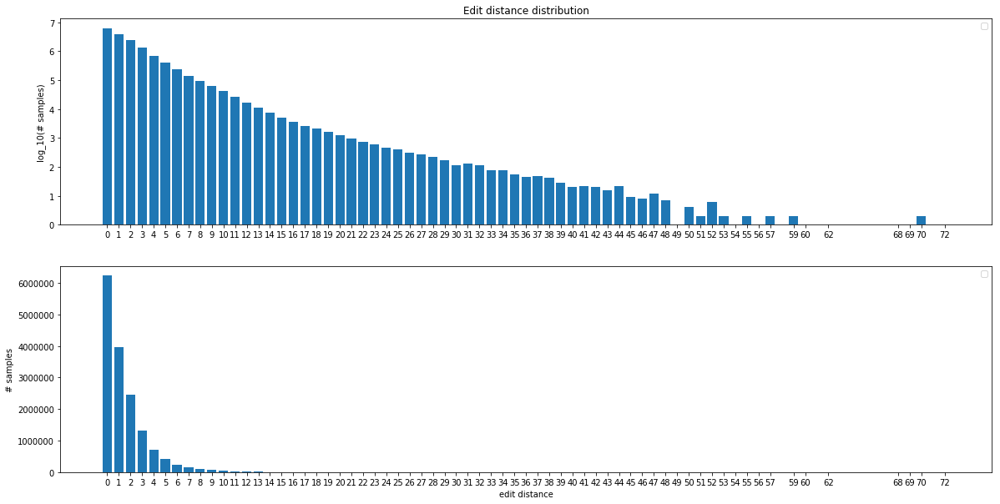

In [30]:
import math

wer = [x[0] for x in sorted_wer_dict][1:]

fig, axes = plt.subplots(ncols=1, nrows=2, figsize=(20,10))

for r, ax in enumerate(axes):
    if r == 0:       
        nsample = [math.log10(x[1]) for x in sorted_wer_dict][1:]
    else:
        nsample = [x[1] for x in sorted_wer_dict][1:]
    
    rects = ax.bar(wer, nsample)

    # Add some text for labels, title and custom x-axis tick labels, etc.
    if r == 0:
        ax.set_ylabel('log_10(# samples)')
        ax.set_title('Edit distance distribution')
    else:
        ax.set_ylabel('# samples')
        ax.set_xlabel('edit distance')
    ax.set_xticks(wer)
    ax.legend()

In [34]:
cnt = 0

for k, v in trans_dic.items():
    if "wer" not in v:
        continue
    if v["wer"] < 20:
        continue
        
    cnt += 1
    if cnt == 10:
        break
        
    print(k)
    print('trans_w2l: ', v["w2l"])
    print('trans_w2v: ', v["w2v"])
    print("---")

/datasets01/speech/112519/librivox-36s/librivox/10018/12/10018_11863_12_0147.wav
trans_w2l:  ['name', 'but', 'a', 'good', 'lord', 'honey', 'they', 'never', 'see', 'style', 'before', 'a', 'woman', 'say', 'you', 'got', 'more', 'fixing', 'in', 'a', 'minute', 'than', 'the', 'whole', 'rest', 'of', 'got', 'in', 'the', 'year', 'she', 'said', 'when', 'she', 'ever', 'you', 'unpacked', 'she', 'went', 'to', 'see', "more'n", 'a', 'hundred', 'pair', 'of', 'slippers', 'alone', 'and', 'the', 'good', 'man', 'know', 'what', 'i', 'remember', 'when', 'you', 'run', 'round', 'back', 'yard', 'enough', 'to', 'have', 'a', 'rope', 'with', 'two', 'loud', 'and', 'save', 'you', 'a', 'boy']
trans_w2v:  ['name', 'of', 'the', 'good', 'lord', 'honey', 'they', 'never', 'see', 'style', 'before', 'my', 'woman', 'say', 'you', 'got', 'more', 'fixing', 'in', 'a', 'minute', 'and', 'the', 'whole', 'rest', 'of', 'em', 'got', 'in', 'a', 'year', 'she', 'said', 'when', 'she', 'having', 'you', 'unpack', 'she', 'must', 'have', 'se

In [56]:
asd = [{1:1, 2:2}, {1:1, 2:2}, {1:1, 2:2}]

for i in asd:
    i[2] = 100

print(asd)

[{1: 1, 2: 100}, {1: 1, 2: 100}, {1: 1, 2: 100}]


In [143]:
length_cnt = {}
with open('/private/home/qiantong/CAPIO_LM/data/librispeech/train.txt.rank') as f:
    for i, line in enumerate(f):
        i += 1
        if i % 500000 == 0:
            print(i, '55915471')
        sp = line.strip().split()
        n = int(sp[0])
        length = len(sp) - 1
        if length not in length_cnt:
            length_cnt[length] = 0
        length_cnt[length] += n

500000 55915471
1000000 55915471
1500000 55915471
2000000 55915471
2500000 55915471
3000000 55915471
3500000 55915471
4000000 55915471
4500000 55915471
5000000 55915471
5500000 55915471
6000000 55915471
6500000 55915471
7000000 55915471
7500000 55915471
8000000 55915471
8500000 55915471
9000000 55915471
9500000 55915471
10000000 55915471
10500000 55915471
11000000 55915471
11500000 55915471
12000000 55915471
12500000 55915471
13000000 55915471
13500000 55915471
14000000 55915471
14500000 55915471
15000000 55915471
15500000 55915471
16000000 55915471
16500000 55915471
17000000 55915471
17500000 55915471
18000000 55915471
18500000 55915471
19000000 55915471
19500000 55915471
20000000 55915471
20500000 55915471
21000000 55915471
21500000 55915471
22000000 55915471
22500000 55915471
23000000 55915471
23500000 55915471
24000000 55915471
24500000 55915471
25000000 55915471
25500000 55915471
26000000 55915471
26500000 55915471
27000000 55915471
27500000 55915471
28000000 55915471
28500000 559

Text(0.5, 0, 'senten length')

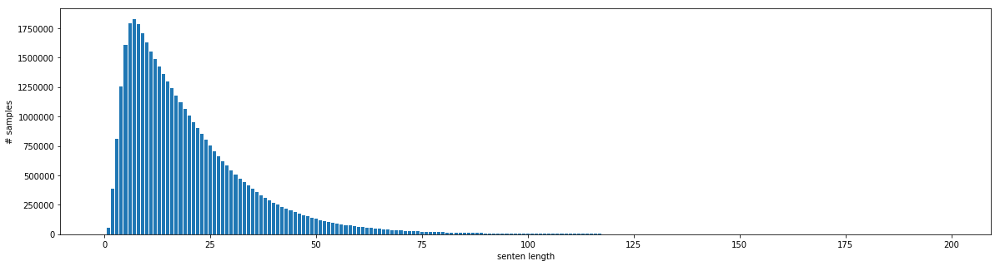

In [146]:
fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(20, 5))
sorted_d = sorted(length_cnt.items(), key=lambda x: x[0])
y = [x[1] for x in sorted_d]
x = [x[0] for x in sorted_d]

ntop = 200
rects = ax.bar(x[:ntop], y[:ntop])
ax.set_ylabel('# samples')
ax.set_xlabel('senten length')

In [86]:
import random

template = """python examples/speech_recognition/infer.py /private/home/qiantong/w2v/data/lower_case  --task speech_pretraining --seed 1 --nbest 1 \
--path /checkpoint/qiantong/w2v/models/vox_960h_ft_lv_pl_reset.fp16.ltr.u480000.savg.ft_bert.mask10.mprob0.2.ld0.1.tran0.maskc64.mcprob0.0.fn0.0.nt_gaussian.fgm0.0.ffu10000.lr2e-05.warmup48000.hld192000.dec240000.frs0.05.fd0.0.drop0.0.ad0.1.atd0.0.sd1337.uf1.ngpu24/checkpoint_last.3.70.pt \
--gen-subset dev_other \
--w2l-decoder kenlm --lm-model /checkpoint/antares/experiments/librispeech_lms/kenlm/nooverlap_librispeech_unique_4gram_200kvocab.bin \
--lexicon /private/home/qiantong/w2v/data/lower_case/lexicon.lst --beam 800 --beam-threshold 80 --beam-size-token 80 \
--lm-weight {} --word-score {} --sil-weight 0.0 --criterion ctc  --labels ltr --max-tokens 4000000 --remove-bpe "$bpe" \
--load-emissions /checkpoint/qiantong/w2v/emissions/vox2_3n.ems.npy
"""

# template = """python examples/speech_recognition/infer.py \
# /checkpoint/abaevski/data/speech/libri/10h/wav2vec/raw --task speech_pretraining --seed 1 --nbest 1 \
# --path /checkpoint/abaevski/asr/aws/ft/vox2_3n.pt \
# --gen-subset dev_other \
# --w2l-decoder kenlm --kenlm-model /checkpoint/abaevski/data/speech/libri/4-gram.bin \
# --lexicon /checkpoint/abaevski/data/speech/libri/10h/wav2vec/raw/lexicon_ltr2.lst \
# --lm-weight {} --word-score {} --sil-weight 0 --criterion ctc --criterion ctc --labels ltr --max-tokens 4000000 --remove-bpe "$bpe" \
# --load-emissions /checkpoint/qiantong/w2v/emissions/vox2_3n.ems.npy
# """

template = """python examples/speech_recognition/infer.py /private/home/qiantong/w2v/data/lower_case  --task speech_pretraining --seed 1 --nbest 1 \
--path /checkpoint/abaevski/asr/aws/ft/vox2_3n.pt \
--gen-subset dev_other \
--w2l-decoder kenlm --lm-model /checkpoint/antares/experiments/librispeech_lms/kenlm/nooverlap_librispeech_unique_4gram_200kvocab.bin \
--lexicon /private/home/qiantong/w2v/data/lower_case/lexicon.lst --beam 2000 --beam-threshold 800 --beam-size-token 100 \
--lm-weight {} --word-score {} --sil-weight 0.0 --criterion ctc  --labels ltr --max-tokens 4000000 --remove-bpe "$bpe" \
--load-emissions /checkpoint/qiantong/w2v/emissions/vox2_3n.ems.npy
"""

lmw_lb = 0
lmw_ub = 1.5
ws_lb = -3
ws_ub = 3

for i in range(128):
    lmw = (random.random() * (lmw_ub - lmw_lb) + lmw_lb)
    ws = (random.random() * (ws_ub - ws_lb) + ws_lb)
    
    with open('/private/home/qiantong/w2v/script/vox2_3n_tr_rescore.auto_ml/sub_{}.sh'.format(i), 'w') as f:
        f.write(template.format(lmw, ws))


In [90]:
# root_path = '/checkpoint/qiantong/w2v/decoder/vox2_3n_ls-lv_tr_rescore.auto_ml/28690536_' ## 3.36
# root_path = '/checkpoint/qiantong/w2v/decoder/vox2_3n_tr_rescore.auto_ml/28692838_'  ## 3.34
root_path = '/checkpoint/qiantong/w2v/decoder/vox2_3n_tr_rescore_ltr_len.auto_ml/28721935_' ## 3.26
# root_path = '/checkpoint/qiantong/w2v/decoder/vox2_3n_tr_rescore.auto_ml/28721152_' ## 3.29


best_wer = 100
best_run = -1
for i in range(128):
    with open(root_path + '{}.err'.format(i)) as f:
        for line in f:
            if line.startswith('INFO:__main__:WER:'):
                wer = float(line.strip().split()[-1])
                print(i, wer)
                if wer < best_wer:
                    best_wer = wer
                    best_run = i
print(best_run, best_wer)

0 3.9667896678966788
1 4.1454031561592215
2 4.808824683991521
3 3.8549108895344273
5 3.3661772787940647
6 4.147365941744524
7 4.096333516526655
8 3.6095626913715946
9 3.9824919525791
10 3.3465494229410377
11 3.527125696788883
12 3.4525398445473816
13 3.6586323310041613
14 4.110073015623773
15 3.7999528931459525
16 4.598806626364136
17 3.4407631310355655
18 3.3033681400643795
19 4.147365941744524
20 3.9648268823113764
21 4.636099552484887
23 4.899112820915443
24 3.3465494229410377
25 3.7508832535133863
26 3.4309492031090523
27 3.266075213943629
28 4.080631231844233
29 4.000157022846825
30 3.9746408102378896
31 3.7646227526105047
32 3.6056371202009894
47 3.9196828138494153
48 4.198398366962393
49 3.699850828295517
50 3.3897307058176964
51 3.31121928240559
52 3.4898327706681322
55 3.37010284996467
56 4.051189448064694
57 4.641987909240795
58 3.7646227526105047
59 3.82743189134019
60 4.07081730391772
61 3.9707152390672844
62 3.5546046949831203
63 3.3995446337442097
64 3.3838423490617884
65

In [107]:
datd = '/private/home/qiantong/w2v/data/lower_case/'

for part in ['dev_other', 'test_other']:
    with open(datd + part + '.cap.ltr') as f, open(datd + part + '.ltr', 'w') as fout:
        for line in f:
            fout.write(line.lower())

In [110]:
wers = []

directory = '/checkpoint/qiantong/w2v/decoder/10m_best.auto_ml/'
for root, dirs, files in os.walk(directory):
    for file in files:
        if file.endswith('.out'):
            with open(directory + file) as f:
                for line in f:
                    if line.startswith('INFO:examples.speech_recognition.infer:WER:'):
                        sp = line.split()
                        wer = float(sp[-1])
                        print(wer)
                        wers.append(wer)

11.664834733453718
11.030854989400957
11.048520059668682
10.0298343408966
10.018057627384785
10.57548873361074
10.814948575017665
10.239852398523984
15.286174138337127
10.061238910261443
10.583339875951951
10.39098688859229
10.120122477820523
10.157415403941274
10.127973620161734
10.365470675983355
10.765878935385098
10.035722697652508
10.006280913872969
10.232001256182775
22.468006594959565
13.806233807018922
10.286959252571249
11.511737457800109
10.265368611132919
10.799246290335244
10.3988380309335
10.644186229096334
10.226112899426866
10.155452618355971
10.275182539059433
11.8002669388396
10.11815969223522
10.104420193138102
10.204522257988538
10.650074585852241
10.312475465180183
10.208447829159143
14.222344351103086
10.436130957054251
10.396875245348198
10.261443039962314
10.540158593075292
10.498940095783936
10.290884823741855
10.75213943628798
10.033759912067206
10.116196906649918
10.025908769725994
10.112271335479312
10.477349454345607
10.27910811023004
10.885608856088561
10.1

In [119]:
letter_set = set([])
with open('/checkpoint/wav2letter/data/swbd_lists/fisher+swbd-train-all-unigram-5000.vocab-filtered') as f:
    for line in f:
        for c in line.strip():
            letter_set.add(c)
print(sorted(list(letter_set)))

with open('/checkpoint/wav2letter/data/swbd_lists/fisher+swbd-train-all-unigram.ltr', 'w') as f:
    for c in sorted(list(letter_set)):
        f.write(c + '\n')

["'", 'L', 'N', '_', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z']


In [125]:
lexicon = {}
with open('/checkpoint/wav2letter/data/swbd_lists/fisher+swbd-train-all-unigram-5000-nbest10.dict') as f:
    for line in f:
        sp = line.strip().split(' ')
        if sp[0] not in lexicon:
            lexicon[sp[0]] = ''.join(sp[1:])

In [128]:
with open('/checkpoint/wav2letter/data/swbd_lists/fisher+swbd-train-all-unigram.lex', 'w') as f:
    for k, v in lexicon.items():
        spelling = list(v[1:]) + ['_']
        f.write(k + '\t' + ' '.join(spelling) + '\n')

In [136]:
a = ['um', 'uh', 'mm']
b = ['hum', 'huh', 'hm']
for i in a:
    for j in b:
        print(i + ' ' + j)

um hum
um huh
um hm
uh hum
uh huh
uh hm
mm hum
mm huh
mm hm


In [150]:
!sort -n -k 3,3 /checkpoint/vineelkpratap/hub05/lists/hub05-switchboard.lst > /tmp/new.lst
!sort -n -k 3,3 /checkpoint/wav2letter/data/swbd_lists/hub05_switchboard.lst > /tmp/old.lst

In [152]:
!wc -l /tmp/new.lst
!wc -l /tmp/old.lst

1831 /tmp/new.lst
1831 /tmp/old.lst


In [155]:
with open('/tmp/new.lst') as fnew, open('/tmp/old.lst') as fold:
    new_lines = fnew.readlines()
    old_lines = fold.readlines()
    
    new_total = 0
    old_total = 0
    for i in range(1831):
        nl = new_lines[i].strip().split('\t')[-1].split()
        ol = old_lines[i].strip().split('\t')[-1].split()
        print(nl)
        new_total += len(nl)
        old_total += len(ol)
#         if len(nl) != len(ol):
#             print(ol)
#             print(nl)
#             print('---')
            
    print(new_total, old_total)

['(a-)']
['aw']
['(darn)']
['yeah']
['i', '(s-)']
['yeah']
['um-hum']
['(e-)']
['(%hesitation)']
['yeah']
['(%hesitation)']
['but']
['that', 'it']
['and']
['(tha-)']
['(%hesitation)']
['yeah']
['(uh-)', '(uh-)']
['oh', 'really']
['(%hesitation)']
['(yeah)']
['like']
['-anier', 'or', 'burton']
['um-hum']
['right']
['(co-)']
['but']
['yeah']
['yep']
['(eh)']
['right']
['because']
['yeah']
['um-hum']
['yes']
['well', '(y-)']
['um-hum']
['to', '(%hesitation)']
['umm']
['(%hesitation)']
['yeah']
['yeah']
['yeah', '(i-)']
['um-hum']
['yeah']
['(%hesitation)']
['to', 'public', '(s-)']
['yeah']
['okay']
['yeah']
['do', 'you']
['um-hum']
['(so)', '(it)', '(is)']
['i', 'mean']
['but', 'i', '(ge-)']
['okay']
['yeah']
['pardon']
['you', 'see', 'what', 'i', 'am', 'saying']
['yeah', '(i-)']
['i', 'am', 'always']
['really']
['(%hesitation)']
['but', '(%hesitation)']
['really']
['yeah']
['um-hum']
['(%hesitation)']
['well']
['(%hesitation)']
['right']
['um-hum']
['to', 'the', 'point', 'where']
['um-hu

## SWBD LM

In [5]:
import re

In [11]:
## word lm

def process_trans(trans):
    trans = re.sub(r'\[.*\]', '', trans)
    trans = re.sub(r'^-', '', trans)
    trans = re.sub(r'-$', '', trans)

    trans = trans.replace("._", " ")
    trans = trans.replace(".", " ")
    trans = trans.replace("_1", "")
    trans = trans.replace(" -", " ")
    trans = trans.replace("- ", " ")
    trans = trans.replace("~", " ")
    trans = trans.replace("*", " ")
    
    trans = re.sub(r'  +', ' ', trans)
    return trans.strip()
    
    
with open('/checkpoint/wav2letter/data/swbd_lm/train_word_lm.txt', 'w') as fout:
    with open('/checkpoint/wav2letter/data/swbd_lists/switchboard.lst') as f:
        for line in f:
            trans = line.split('\t')[-1].strip()
            trans = process_trans(trans)
            if len(trans) > 0:
#                 print(trans)
                fout.write(trans + '\n')
    
    with open('/checkpoint/wav2letter/data/swbd_lists/fisher.lst') as f:
        for line in f:
            trans = line.split('\t')[-1].strip()
            trans = process_trans(trans)
            if len(trans) > 0:
#                 print(trans)
                fout.write(trans + '\n')

In [66]:
dic = {}

with open('/checkpoint/wav2letter/data/swbd_lists/noNL/fisher+swbd-train-all-unigram.lex') as f:
    for line in f:
        sp = line.strip().split('\t')
        dic[sp[0]] = sp[1]

with open('/checkpoint/wav2letter/data/swbd_lm/train_word_lm.txt') as f:
    for line in f:
        for word in line.strip().split():
            test_w = re.sub(r'[0-9\~\&\*]', '', word)
            if len(test_w) != len(word):
                continue
            if word in dic:
                continue
            new_w = re.sub(r'[\.\-\_0-9]', '', word)
            dic[word] = ' '.join(list(new_w + '_'))

with open('/checkpoint/wav2letter/data/swbd_lists/noNL/fisher+swbd-train-all-unigram.decoder.lex', 'w') as f:
    for k, v in dic.items():
        f.write('{}\t{}\n'.format(k, v))

In [67]:
with open('/checkpoint/wav2letter/data/swbd_lists/noNL/fisher+swbd-train-all-unigram.decoder.lex') as f:
    with open('/checkpoint/wav2letter/data/swbd_lists/noNL/fisher+swbd-train-all-unigram.decodereos.lex', 'w') as fout:
        for line in f:
            fout.write(line[:-2] + '$\n')

In [15]:
with open('/checkpoint/vineelkpratap/rt03s_eval/extended/lists/rt03s_eval.8KHz.lst') as f:
    with open('/checkpoint/qiantong/wav2letter_experiments/sclites/rt03_list.ref', 'w') as fout:
        for line in f:
            sp = line.split('\t')
            fout.write('{} ({})\n'.format(sp[-1].strip(), sp[0]))

In [24]:
a = 'asd- asd-- asdw- a4fds asd._ ad->-w'
b = re.sub(r'[\.\-\_0-9]', '', a)
print(b)

asd asd asdw afds asd ad>w


In [42]:
## letter lm

def process_trans(trans):
    trans = re.sub(r'\[.*\]', '', trans)
    trans = re.sub(r'^-', '', trans)
    trans = re.sub(r'-$', '', trans)

    trans = trans.replace("._", " ")
    trans = trans.replace(".", " ")
    trans = trans.replace("_1", "")
    trans = trans.replace(" -", " ")
    trans = trans.replace("- ", " ")
    trans = trans.replace("~", " ")
    trans = trans.replace("*", " ")
    
    trans = re.sub(r'  +', ' ', trans)
    return trans.strip()
    
    
with open('/checkpoint/wav2letter/data/swbd_lm/train_letter_lm.txt', 'w') as fout:
    with open('/checkpoint/wav2letter/data/swbd_lists/switchboard.lst') as f:
        for line in f:
            trans = line.split('\t')[-1].strip()
            trans = process_trans(trans)
            if len(trans) > 0:
                trans = trans.replace(" ", "_")
                trans += '_'
#                 print(' '.join(list(trans)))
                fout.write(' '.join(list(trans)) + '\n')
#             break
        
    
    with open('/checkpoint/wav2letter/data/swbd_lists/fisher.lst') as f:
        for line in f:
            trans = line.split('\t')[-1].strip()
            trans = process_trans(trans)
            if len(trans) > 0:
                trans = trans.replace(" ", "_")
                trans += '_'
                fout.write(' '.join(list(trans)) + '\n')


In [68]:
with open('/checkpoint/wav2letter/data/swbd_lm/train_letter_lm.txt') as f:
    with open('/checkpoint/wav2letter/data/swbd_lm/train_letter_lm.nosrd.txt', 'w') as fout:
        for line in f:
            fout.write(line[:-2] + '\n')

In [48]:
swbd_lex = '/checkpoint/wav2letter/data/swbd_lists/noNL/fisher+swbd-train-all-unigram.lex'
ls_lex = '/private/home/qiantong/push_numbers/lists/lexicon_letters.txt'
cv_lex = '/checkpoint/wav2letter/transfer_learning/tokens/common_voice/cv-train-dev-letters.lexicon'

out_path = '/private/home/qiantong/wav2letter_experiments/256_GPU/letters.lex'

word_set = {}

with open(out_path, 'w') as fout:
    with open(swbd_lex) as f:
        for line in f:
            sp = line.split('\t')
            sp[1] = sp[1].replace('_', "|")
            word_set[sp[0]] = sp[1]
            fout.write('\t'.join(sp))
            
    with open(ls_lex) as f:
        for line in f:
            sp = line.split('\t')
            if sp[0] in word_set:
                if word_set[sp[0]] != sp[1]:
                    print(word_set[sp[0]], sp[1])
                continue
            word_set[sp[0]] = sp[1]
            fout.write(line)
            
    with open(cv_lex) as f:
        for line in f:
            sp = line.split('\t')
            if sp[0] in word_set:
                if word_set[sp[0]] != sp[1]:
                    print(word_set[sp[0]], sp[1])
                continue
            word_set[sp[0]] = sp[1]
            fout.write(line)

In [57]:
total_duration = 0.

for file in ['/checkpoint/jacobkahn/data/lists/librispeech/train-clean-100.lst','/checkpoint/jacobkahn/data/lists/librispeech/train-clean-360.lst','/checkpoint/jacobkahn/data/lists/librispeech/train-other-500.lst','/checkpoint/wav2letter/data/swbd_lists/noNL/switchboard.16khz.lst','/checkpoint/wav2letter/data/swbd_lists/noNL/fisher.16khz.lst']:#,'/checkpoint/wav2letter/data/commonvoice/lists/train.lst']:
    print(file)
    with open(file) as f:
        for line in f:
            try:
                sp = line.split('\t')
                duration = float(sp[2])
            except:
                sp = line.split(' ')
                duration = float(sp[2])
                
            total_duration += duration
            
print(total_duration / 3600000)

/checkpoint/jacobkahn/data/lists/librispeech/train-clean-100.lst
/checkpoint/jacobkahn/data/lists/librispeech/train-clean-360.lst
/checkpoint/jacobkahn/data/lists/librispeech/train-other-500.lst
/checkpoint/wav2letter/data/swbd_lists/noNL/switchboard.16khz.lst
/checkpoint/wav2letter/data/swbd_lists/noNL/fisher.16khz.lst
3210.4524009252787


In [58]:
root = '/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/{}.lst'
a = [root.format(i) for i in range(256)]
print(','.join(a))

/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/0.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/1.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/2.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/3.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/4.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/5.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/6.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/7.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/8.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/9.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/10.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/11.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/12.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_380/13.lst,/checkpoint/qiantong/ls_200M/100h/168/generated_pl/epoch_3

In [80]:
with open('/checkpoint/qiantong/wav2letter_experiments/sclites/rt03_list.ref', 'w') as fout:
    with open('/checkpoint/qiantong/wav2letter_experiments/sclites/rt03_list.ref.old') as f:
        for line in f:
            line = line.replace('.', '')
            sp = line.strip().split(' ')
#             if len(sp) < 2:
#                 print(sp)
#                 continue
                
            fout.write(line)

In [77]:
cnt = 0
with open('/checkpoint/vineelkpratap/rt03s_eval/original.stm') as f:
    for line in f:
        sp = line.split()
        if len(sp) < 7:
            cnt += 1
#         print(sp[6:])
#         break
print(cnt)

174


In [122]:
for lang in ['Dutch',  'English',  'French',  'German',  'Italian',  'Polish',  'Portuguese', 'Spanish']:
    speakers = {}
    chapters = {}

    print(' ----------------- {} -----------------'.format(lang))

    with open('/checkpoint/vineelkpratap/mls2/{}/METAINFO.TXT'.format(lang)) as f:
        for line in f.readlines()[1:]:
            sp = line.strip().split('|')
            speaker = sp[0].strip()
            partition = sp[2].strip()
            chapter = sp[-2].strip() + ' ' + sp[-1].strip()
            #print(speaker, partition, chapter)
            if partition not in speakers:
                speakers[partition] = set([])
            if partition not in chapters:
                chapters[partition] = set([])

            speakers[partition].add(speaker)
            chapters[partition].add(chapter)

    for k, v in speakers.items():
        print(k, len(v))
    for k, v in chapters.items():
        print(k, len(v))

    for k, v in speakers.items():
        for k1, v1 in speakers.items():
            if k1 == k:
                continue
            print(k, k1, v1 & v)

    print('---')
    for k, v in chapters.items():
        for k1, v1 in chapters.items():
            if k1 == k:
                continue
            print(k, k1, v1 & v)

 ----------------- Dutch -----------------
train 40
dev 6
test 6
train 3834
dev 89
test 55
train dev set()
train test set()
dev train set()
dev test set()
test train set()
test dev set()
---
train dev set()
train test set()
dev train set()
dev test set()
test train set()
test dev set()
 ----------------- English -----------------
secret 46
dev 42
test 42
train 5490
secret 103
dev 201
test 153
train 179765
secret dev set()
secret test set()
secret train set()
dev secret set()
dev test set()
dev train set()
test secret set()
test dev set()
test train set()
train secret set()
train dev set()
train test set()
---
secret dev set()
secret test set()
secret train set()
dev secret set()
dev test set()
dev train {'Son At The Front Chapter XXIV'}
test secret set()
test dev set()
test train {'English Fairy Tales The Black Bull of Norroway'}
train secret set()
train dev {'Son At The Front Chapter XXIV'}
train test {'English Fairy Tales The Black Bull of Norroway'}
 ----------------- French -------

In [118]:
for k, v in speakers.items():
    print(k, len(v))
for k, v in chapters.items():
    print(k, len(v))

train 3
train 1853


In [119]:
for k, v in speakers.items():
    for k1, v1 in speakers.items():
        if k1 == k:
            continue
        print(k, k1, v1 & v)
        
print('---')
for k, v in chapters.items():
    for k1, v1 in chapters.items():
        if k1 == k:
            continue
        print(k, k1, v1 & v)

---


# Prepare WSJ

In [127]:
cnt = 0
with open('/checkpoint/antares/datasets/wsj/lists/nov92.lst') as f:
    for line in f:
        sp = line.strip().split(' ')
        cnt += len(sp) - 3
#         print(sp)
print(cnt, cnt/ 100. * 7.6, 400.0 / cnt)

5643 428.868 0.0708842814105972


In [129]:
words = {}

with open('/checkpoint/antares/datasets/wsj/lists/si284.lst') as f:
    for line in f:
        sp = line.strip().split(' ')
        for word in sp[3:]:
            words[word] = 1

In [130]:
sorted_d = sorted(words.items(), key=lambda x: x[0])
for k, v in sorted_d:
    print(k)

!exclamation-point
"close-quote
"double-quote
"end-of-quote
"end-quote
"in-quotes
"quote
"unquote
&ampersand
'single-quote
(begin-parens
(brace
(in-parentheses
(left-paren
(paren
(parentheses
(parenthetically
)close-brace
)close-paren
)close_paren
)end-of-paren
)end-parens
)end-the-paren
)paren
)right-paren
)un-parentheses
,comma
-(a)merican
-(b)ussi
-(b)ut
-(bu)t
-(de)termined
-(exa)cerbate
-(final)ly
-(in)vestigating
-(it)s
-(l)ike
-(re)linquish
-(re)publicans
-(th)e
-(to)ronto
-a
-and
-certain
-communicado
-dash
-hyphen
-i
-k
-lysmic
-once
-or
-s
-so
-stanley
-t
-to
-true
-u
-we
...ellipsis
.decimal
.dot
.percent
.period
/slash
:colon
;semi-colon
?question-mark
a
a(re)-
a-
a.
a.'s
a.s
abandon
abandoned
abandoning
abanto
abate
abbenhaus
abboud
abbreviated
aberration
aberrations
abhor
abhorrent
ability
ablaze
able
aboard
abolished
abominable
aborted
abortion
abound
abounds
about
about's
above
abraham
abrams
abrasive
abroad
absence
absentee
absenteeism
abshire
absolute
absolutely
absor

cooperation
cooperative
cooperatives
cooperman
coordinate
coordinated
cop-
cope
copenhagen
copied
copies
copper
copy
copying
copyrights
corbett
cordobas
core
corintio
corinto
corn
corneas
cornell
cornell's
corner
corners
corniche
cornucopia
corona
corp
corp.
corp.'s
corporate
corporation
corporation's
corporations
corps
corpse
corpus
corrado
correct
correcting
correction
correctional
correctly
correspond
correspondent
corrigan
corrupt
corruption
corsair
corvette
cosby
cosmetic
cosmic
cost
costa
costlier
costly
costs
cotton
coughing
could
couldn't
council
council's
counsel
counseled
count
countenance
counter
counterclaim
counterculture
countered
counterfeit
counterfeiters
countermeasures
counterpart
counterparts
counterproductive
counters
countersuit
counting
countless
countries
country
country's
countryside
counts
county
coup
coupe
couple
coupled
coupon
coupons
courant
course
court
court's
courthouse
courtroom
courts
covenant
covenants
cover
coverage
covered
covering
covers
covert
cove

illegitimacy
illegitimate
illinois
illinois'
illinois's
illiteracy
illness
illusion
illustrated
illustrates
illustrating
illustrator
image
images
imaginable
imagination
imagine
imagined
imaging
imbalance
imbalances
imelda
imitators
immediate
immediately
immense
immigrant
immigrants
immigrate
immigration
imminent
immoral
immune
immunity
immunodeficiency
impact
impacted
impasse
impatient
impede
impending
imperial
imperialism
imperialists
impetus
implants
implement
implementation
implementing
implication
implications
implicitly
implied
imply
implying
import
importance
important
imported
importers
importing
imports
impose
imposed
imposes
imposition
impossible
impotent
impress
impressed
impression
impressive
imprimatur
imprisonment
improbable
improper
improperly
improve
improved
improvement
improvements
improves
improving
imprudent
impulse
impulsively
impunity
in
in-
in.
inability
inaccurate
inacomp
inaction
inadequate
inadvertent
inaugurated
inc.
inc.'s
incalculable
incapable
incarcerate
i

plaintiffs'
plan
plane
plane's
planes
planet's
planetarium
planned
planners
planning
plans
plant
plant's
planting
plants
plaskett
plasminogen
plastic
plastics
plated
platform
platforms
platinum
platoon
plausible
play
playboy
played
player
players
playing
plays
playtex
plaza
plea
plead
pleaded
pleas
pleased
plebiscite
pledge
pledged
pledges
plenty
plessey
plethora
plight
plodding
plop
plot
plough
plucking
plug
plugged
plugs
plummeted
plummeting
plunge
plunged
plunging
plus
plymouth
plywood
pneumonia
pocket
pocketbook
pockets
poehl
poehl's
pogo
poindexter
poindexter's
point
pointed
pointing
points
poised
poison
poisonous
poke
poland
poland's
polarization
polaroid
polce
poles
police
policeman
policemen
policies
policies-
policy
policyholders
polish
political
politically
politician
politicians
politicize
politics
polk
poll
polled
polls
pollsters
polo
polyester
polymers
polysar
polyvinyl
ponder
pondering
pont
pont's
pool
pooled
pooling
pools
poolside
poor
poor's
poorest
poorly
pop
pope
pope

repurchases
repurchasing
reputation
reputed
request
requested
requests
require
required
requirement
requirements
requires
requiring
reruns
reschedule
rescheduled
rescheduling
rescue
rescuing
research
researched
researcher
researchers
researching
resell
resent
reservations
reserve
reserved
reserves
reshaped
residence
residency
resident
residential
residents
resides
resign
resignation
resignations
resigned
resigning
resilience
resist
resistance
resistant
resisted
resisting
resistiveness
resists
resler
resnick
resolute
resolution
resolutions
resolve
resolved
resolving
resort
resorting
resorts
resource
resources
respect
respected
respects
respond
responded
responding
response
responses
responsibilities
responsibility
responsible
rest
restarting
restated
restaurant
restaurants
rested
restiveness
restoration
restore
restored
restrain
restraining
restraint
restraints
restrict
restricted
restricting
restrictions
restrictive
restructure
restructured
restructuring
restructurings
rests
resubmitte

wagered
wages
wagner
wagon
wait
waited
waiter
waiting
waive
waiver
wake
wakefield
waldman
wales
walesa
walk
walked
walkers
walking
walks
wall
wallace
wallace's
wallich
walls
walsh
walsh's
walt
walter
walters
wanda
wanderers
wandering
wane
waning
want
wanted
wanting
wants
war
warburg
ward
ward's
wardley
warehouse
warehouses
warehousing
wares
warfare
warheads
warm
warmed
warming
warn
warned
warner
warner's
warning
warnings
warns
warplanes
warrant
warrants
warranty
warren
warriors
wars
warsaw
warships
wary
was
washington
washington's
wasn't
waste
wasteful
wastes
wasting
watch
watched
watchers
watches
watching
water
waterfalls
watergate
waterloo
waters
watershed
watson
watt
wave
waves
waving
way
wayne
ways
we
we'd
we'll
we're
we've
weak
weakened
weakening
weakens
weaker
weakness
wealth
wealthy
weapon
weapons
wear
wearever
wearing
weather
weave
weaver
weber
webster
wedge
wednesday
wednesday's
weeds
week
week's
weekend
weekly
weeks
weighed
weighing
weighs
weight
weil
weild
weill
weill's
wein

In [179]:
lex_words = {}

with open('/private/home/qiantong/wav2letter_experiments/256_GPU/letters.lex') as f:
    for line in f:
        sp = line.strip().split('\t')
#         if '.' in sp[0]:
#             print(sp[0])
        lex_words[sp[0]] = sp[1]
# print('---')

with open('/checkpoint/qiantong/wsj/lexicon_si284+nov93dev.txt') as f:
    for line in f:
        sp = line.strip().split('\t')
        if '.' in sp[0]:
            print(sp[0])
        if sp[0] in lex_words:
            if not sp[1] == lex_words[sp[0]]:
                print(sp[0], sp[1], lex_words[sp[0]])
        else:
            lex_words[sp[0]] = sp[1]
print('---')

with open('/private/home/qiantong/wav2letter_experiments/256_GPU/letters+wsj.lex', 'w') as f:
    for k, v in lex_words.items():
        if '.' in v:
            print(k, v)
            continue
        f.write('{}\t{}\n'.format(k, v))

corp.'s
mrs.
mrs. m r s . | m r s |
o.
o. o . | o |
v.
v. v . | v |
f.
f. f . | f |
gen.
o.'s
k.'s
k.'s k . ' s | k | ' s |
.dot
co.
o.s
o.s o . s | o | s |
rep.
inc.
inc. i n c . | i n c |
t.
t. t . | t |
v.'s
v.'s v . ' s | v | ' s |
p.s
p.s p . s | p | s |
j.
j. j . | j |
ms.
l.'s
l.'s l . ' s | l | ' s |
b.
b. b . | b |
y.
y. y . | y |
g.'s
p.'s
p.'s p . ' s | p | ' s |
d.
d. d . | d |
conn.
i.
i. i . | i |
z.
z. z . | z |
m.
m. m . | m |
c.
c. c . | c |
a.
a. a . | a |
t.'s
t.'s t . ' s | t | ' s |
in.
mr.
.percent
w.'s
corp.
e.
e. e . | e |
c.'s
c.'s c . ' s | c | ' s |
inc.'s
x.
x. x . | x |
m.'s
m.'s m . ' s | m | ' s |
mass.
s.'s
n.
n. n . | n |
b.'s
b.'s b . ' s | b | ' s |
s.
s. s . | s |
e.'s
e.'s e . ' s | e | ' s |
m.s
a.s
a.s a . s | a | s |
w.
w. w . | w |
d.'s
d.'s d . ' s | d | ' s |
g.
g. g . | g |
p.
p. p . | p |
h.
h. h . | h |
x.'s
x.'s x . ' s | x | ' s |
...ellipsis
calif.
u.
u. u . | u |
c.s
c.s c . s | c | s |
h.'s
n.'s
n.'s n . ' s | n | ' s |
d.s
d.s d . s |

In [170]:
sorted_d = sorted(lex_words.items(), key=lambda x: x[0])
# for k, v in sorted_d:
#     print(k, v)

In [180]:
with open('/checkpoint/qiantong/wsj/si284.lst') as f:
    for line in f:
        sp = line.strip().split()
        for word in sp[3:]:
            if not word in lex_words:
                print(word)

In [150]:
letters = ['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', '\'']

with open('/checkpoint/antares/datasets/wsj/lists/nov92.lst') as f:
    for line in f:
        sp = line.strip().split(' ')
        for word in sp[3:]:
            if not word in lex_words:
                for c in word:
                    if not c in letters:
                        print(word)
                        break

In [153]:
for k, v in sorted_d:
    if '.' in v or '.' in k:

        print(k, v)

...ellipsis . . . e l l i p s i s |
.decimal . d e c i m a l |
.dot . d o t |
.percent . p e r c e n t |
.period . p e r i o d |
a. a . |
a.'s a . ' s |
a.s a . s |
b. b . |
b.'s b . ' s |
c. c . |
c.'s c . ' s |
c.s c . s |
calif. c a l i f . |
co. c o . |
conn. c o n n . |
corp. c o r p . |
corp.'s c o r p . ' s |
d. d . |
d.'s d . ' s |
d.s d . s |
e. e . |
e.'s e . ' s |
f. f . |
g. g . |
g.'s g . ' s |
gen. g e n . |
h. h . |
h.'s h . ' s |
i. i . |
in. i n . |
inc. i n c . |
inc.'s i n c . ' s |
j. j . |
k. k . |
k.'s k . ' s |
l. l . |
l.'s l . ' s |
m. m . |
m.'s m . ' s |
m.s m . s |
mass. m a s s . |
messrs. m e s s r s . |
mr. m r . |
mrs. m r s . |
ms. m s . |
n. n . |
n.'s n . ' s |
o. o . |
o.'s o . ' s |
o.s o . s |
p. p . |
p.'s p . ' s |
p.s p . s |
r. r . |
r.'s r . ' s |
rep. r e p . |
reps. r e p s . |
s. s . |
s.'s s . ' s |
t. t . |
t.'s t . ' s |
u. u . |
v. v . |
v.'s v . ' s |
w. w . |
w.'s w . ' s |
x. x . |
x.'s x . ' s |
y. y . |
z. z . |


In [164]:
def process_dot_word(word):
    if word == 'mr.':
        return 'mister'
    elif word == 'ms.':
        return 'miss'
    return word.replace('.', '')

with open('/checkpoint/antares/datasets/wsj/lists/nov92.lst') as f:
    with open('/checkpoint/qiantong/wsj/nov92.lst', 'w') as fout:
        for line in f:
            sp = line.strip().split()
            for i in range(3, len(sp)):
                word = sp[i]
                if '.' in word:
                    sp[i] = process_dot_word(word)
                    
            fout.write(' '.join(sp) + '\n')
#             break

In [166]:
def process_dot_word(word):
    if word == 'mr.':
        return 'mister'
    elif word == 'ms.':
        return 'miss'
    elif word == 'mrs.':
        return 'misses'
    return word.replace('.', '')

with open('/checkpoint/qiantong/wsj/si284.lst.remap') as f:
    with open('/checkpoint/qiantong/wsj/si284.lst', 'w') as fout:
        for line in f:
            sp = line.strip().split()
            for i in range(3, len(sp)):
                word = sp[i]
                if '.' in word:
                    sp[i] = process_dot_word(word)
                    
            fout.write(' '.join(sp) + '\n')

In [9]:
letters = ['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', '\'']

ml = 0

with open('/checkpoint/qiantong/wsj/si284.lst') as f:
    for line in f:
        sp = line.split(' ')
        trans = ' '.join(sp[3:]).strip()
        for c in trans:
            if c not in letters:
                print(line)
        ml = max(ml, len(trans))
#         print(trans)
#         break
print(ml)

11-1.1/wsj0/si_tr_s/011/011c0201.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000000.flac 6544.437 the sale of the hotels is part of holiday's strategy to sell off assets and concentrate on property management

11-1.1/wsj0/si_tr_s/011/011c0201.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000000.flac 6544.437 the sale of the hotels is part of holiday's strategy to sell off assets and concentrate on property management

11-1.1/wsj0/si_tr_s/011/011c0201.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000000.flac 6544.437 the sale of the hotels is part of holiday's strategy to sell off assets and concentrate on property management

11-1.1/wsj0/si_tr_s/011/011c0201.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000000.flac 6544.437 the sale of the hotels is part of holiday's strategy to sell off assets and concentrate on property management

11-1.1/wsj0/si_tr_s/011/011c0201.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000000.flac 6544.437 the sale of the hotels


11-1.1/wsj0/si_tr_s/011/011c020i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000017.flac 6867.0 following the wilson affair the panel did conduct several staff inquiries in reaction to news stories

11-1.1/wsj0/si_tr_s/011/011c020i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000017.flac 6867.0 following the wilson affair the panel did conduct several staff inquiries in reaction to news stories

11-1.1/wsj0/si_tr_s/011/011c020i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000017.flac 6867.0 following the wilson affair the panel did conduct several staff inquiries in reaction to news stories

11-1.1/wsj0/si_tr_s/011/011c020i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000017.flac 6867.0 following the wilson affair the panel did conduct several staff inquiries in reaction to news stories

11-1.1/wsj0/si_tr_s/011/011c020i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000017.flac 6867.0 following the wilson affair the panel did conduct several staff inq

11-1.1/wsj0/si_tr_s/013/013c021f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000151.flac 7962.438 each is different but usually involves a combination of stock option purchases arranged by the home office in new york

11-1.1/wsj0/si_tr_s/013/013c021f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000151.flac 7962.438 each is different but usually involves a combination of stock option purchases arranged by the home office in new york

11-1.1/wsj0/si_tr_s/013/013c021f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000151.flac 7962.438 each is different but usually involves a combination of stock option purchases arranged by the home office in new york

11-1.1/wsj0/si_tr_s/013/013c021f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000151.flac 7962.438 each is different but usually involves a combination of stock option purchases arranged by the home office in new york

11-1.1/wsj0/si_tr_s/013/013c021f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000151.flac


11-1.1/wsj0/si_tr_s/013/013o0313.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000190.flac 10157.312 although sandinista officials say the document was faked by the contras ,comma two of the ambassadors have since received new foreign postings period

11-1.1/wsj0/si_tr_s/013/013o0313.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000190.flac 10157.312 although sandinista officials say the document was faked by the contras ,comma two of the ambassadors have since received new foreign postings period

11-1.1/wsj0/si_tr_s/013/013o0314.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000191.flac 11076.0 and norman miranda ,comma a mid -hyphen ranking foreign ministry representative who defected in november in geneva ,comma contends that it is genuine period

11-1.1/wsj0/si_tr_s/013/013o0314.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000191.flac 11076.0 and norman miranda ,comma a mid -hyphen ranking foreign ministry representative who defected in november in geneva 


11-1.1/wsj0/si_tr_s/015/015c020l.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000325.flac 4641.188 the difference lies in britain's use of ads to urge people to apply for shares

11-1.1/wsj0/si_tr_s/015/015c020l.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000325.flac 4641.188 the difference lies in britain's use of ads to urge people to apply for shares

11-1.1/wsj0/si_tr_s/015/015c020l.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000325.flac 4641.188 the difference lies in britain's use of ads to urge people to apply for shares

11-1.1/wsj0/si_tr_s/015/015c020l.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000325.flac 4641.188 the difference lies in britain's use of ads to urge people to apply for shares

11-1.1/wsj0/si_tr_s/015/015c020l.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000325.flac 4641.188 the difference lies in britain's use of ads to urge people to apply for shares

11-1.1/wsj0/si_tr_s/015/015c020l.wv1 /checkpoint/antares/datasets/wsj

11-1.1/wsj0/si_tr_s/015/015o030c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000370.flac 6278.562 breakfast also helps ,comma as does jumping into a hot shower on awakening period

11-1.1/wsj0/si_tr_s/015/015o030c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000370.flac 6278.562 breakfast also helps ,comma as does jumping into a hot shower on awakening period

11-1.1/wsj0/si_tr_s/015/015o030c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000370.flac 6278.562 breakfast also helps ,comma as does jumping into a hot shower on awakening period

11-1.1/wsj0/si_tr_s/015/015o030c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000370.flac 6278.562 breakfast also helps ,comma as does jumping into a hot shower on awakening period

11-1.1/wsj0/si_tr_s/015/015o030c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000370.flac 6278.562 breakfast also helps ,comma as does jumping into a hot shower on awakening period

11-1.1/wsj0/si_tr_s/015/015o030c.wv1 /checkpoint/antare


11-1.1/wsj0/si_tr_s/016/016o0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000489.flac 6597.563 the real question on the ballot is ,comma should the reagan years continue beyond the reagan years ?question-mark

11-1.1/wsj0/si_tr_s/016/016o0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000489.flac 6597.563 the real question on the ballot is ,comma should the reagan years continue beyond the reagan years ?question-mark

11-1.1/wsj0/si_tr_s/016/016o0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000489.flac 6597.563 the real question on the ballot is ,comma should the reagan years continue beyond the reagan years ?question-mark

11-1.1/wsj0/si_tr_s/016/016o0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000489.flac 6597.563 the real question on the ballot is ,comma should the reagan years continue beyond the reagan years ?question-mark

11-1.1/wsj0/si_tr_s/016/016o0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000489.flac 6597.563 the real 


11-1.1/wsj0/si_tr_s/017/017o030d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000564.flac 6101.125 "double-quote if we're using revlon assets ,comma the suits could be troublesome period "double-quote

11-1.1/wsj0/si_tr_s/017/017o030d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000564.flac 6101.125 "double-quote if we're using revlon assets ,comma the suits could be troublesome period "double-quote

11-1.1/wsj0/si_tr_s/017/017o030d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000564.flac 6101.125 "double-quote if we're using revlon assets ,comma the suits could be troublesome period "double-quote

11-1.1/wsj0/si_tr_s/017/017o030d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000564.flac 6101.125 "double-quote if we're using revlon assets ,comma the suits could be troublesome period "double-quote

11-1.1/wsj0/si_tr_s/017/017o030d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000564.flac 6101.125 "double-quote if we're using revlon assets ,comma the sui


11-1.1/wsj0/si_tr_s/018/018o030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000673.flac 9536.75 "double-quote from our point of view ,comma we already have a permissive policy ,comma "double-quote he says period

11-1.1/wsj0/si_tr_s/018/018o030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000673.flac 9536.75 "double-quote from our point of view ,comma we already have a permissive policy ,comma "double-quote he says period

11-1.1/wsj0/si_tr_s/018/018o030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000673.flac 9536.75 "double-quote from our point of view ,comma we already have a permissive policy ,comma "double-quote he says period

11-1.1/wsj0/si_tr_s/018/018o030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000673.flac 9536.75 "double-quote from our point of view ,comma we already have a permissive policy ,comma "double-quote he says period

11-1.1/wsj0/si_tr_s/018/018o030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000000673.flac 9536.75 "doubl

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




11-1.1/wsj0/si_tr_s/020/020c020r.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002627.flac 3440.0 building sizes included in the data also vary from market to market

11-1.1/wsj0/si_tr_s/020/020c020r.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002627.flac 3440.0 building sizes included in the data also vary from market to market

11-1.1/wsj0/si_tr_s/020/020c020r.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002627.flac 3440.0 building sizes included in the data also vary from market to market

11-1.1/wsj0/si_tr_s/020/020c020r.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002627.flac 3440.0 building sizes included in the data also vary from market to market

11-1.1/wsj0/si_tr_s/020/020c020r.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002627.flac 3440.0 building sizes included in the data also vary from market to market

11-1.1/wsj0/si_tr_s/020/020c020r.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002627.flac 3440.0 building sizes included in the


11-1.1/wsj0/si_tr_s/020/020o030o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002669.flac 5721.25 hardliners ,comma for instance ,comma want a law that bans all obscene and indecent speech over the telephone period

11-1.1/wsj0/si_tr_s/020/020o030p.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002670.flac 7622.312 "double-quote the battle should be carried to the supreme court ,comma "double-quote argues representative william dannemeyer ,comma a california republican period

11-1.1/wsj0/si_tr_s/020/020o030p.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002670.flac 7622.312 "double-quote the battle should be carried to the supreme court ,comma "double-quote argues representative william dannemeyer ,comma a california republican period

11-1.1/wsj0/si_tr_s/020/020o030p.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002670.flac 7622.312 "double-quote the battle should be carried to the supreme court ,comma "double-quote argues representative william dannemeyer ,c


11-1.1/wsj0/si_tr_s/024/024c020g.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002809.flac 9562.125 in truth the c e os who appeared before the committee are themselves institutional investors through their companies' employee benefit plans

11-1.1/wsj0/si_tr_s/024/024c020g.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002809.flac 9562.125 in truth the c e os who appeared before the committee are themselves institutional investors through their companies' employee benefit plans

11-1.1/wsj0/si_tr_s/024/024c020g.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002809.flac 9562.125 in truth the c e os who appeared before the committee are themselves institutional investors through their companies' employee benefit plans

11-1.1/wsj0/si_tr_s/024/024c020g.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002809.flac 9562.125 in truth the c e os who appeared before the committee are themselves institutional investors through their companies' employee benefit plans

11-1.1/


11-1.1/wsj0/si_tr_s/024/024c0214.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002833.flac 8700.688 chevron paid a total of five hundred fifty five million dollars for the stake but it already has taken write offs to reflect possible losses

11-1.1/wsj0/si_tr_s/024/024c0214.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002833.flac 8700.688 chevron paid a total of five hundred fifty five million dollars for the stake but it already has taken write offs to reflect possible losses

11-1.1/wsj0/si_tr_s/024/024c0215.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002834.flac 4113.437 mister dukakis is in fact a first generation american

11-1.1/wsj0/si_tr_s/024/024c0215.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002834.flac 4113.437 mister dukakis is in fact a first generation american

11-1.1/wsj0/si_tr_s/024/024c0215.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002834.flac 4113.437 mister dukakis is in fact a first generation american

11-1.1/wsj0/si_tr_s/

11-1.1/wsj0/si_tr_s/026/026o030f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002961.flac 9797.0 perhaps the most popular diversionary tactic is a deferred -hyphen compensation plan in which the employer puts money into a separate account for the employee period

11-1.1/wsj0/si_tr_s/026/026o030f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002961.flac 9797.0 perhaps the most popular diversionary tactic is a deferred -hyphen compensation plan in which the employer puts money into a separate account for the employee period

11-1.1/wsj0/si_tr_s/026/026o030f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002961.flac 9797.0 perhaps the most popular diversionary tactic is a deferred -hyphen compensation plan in which the employer puts money into a separate account for the employee period

11-1.1/wsj0/si_tr_s/026/026o030g.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002962.flac 5643.063 compared with qualified pension plans ,comma these trusts have some disadvantages


11-1.1/wsj0/si_tr_s/027/027c0203.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002997.flac 13500.125 they can underwrite japanese government bonds but the share of such business remains very small

11-1.1/wsj0/si_tr_s/027/027c0203.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002997.flac 13500.125 they can underwrite japanese government bonds but the share of such business remains very small

11-1.1/wsj0/si_tr_s/027/027c0203.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002997.flac 13500.125 they can underwrite japanese government bonds but the share of such business remains very small

11-1.1/wsj0/si_tr_s/027/027c0203.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002997.flac 13500.125 they can underwrite japanese government bonds but the share of such business remains very small

11-1.1/wsj0/si_tr_s/027/027c0203.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000002997.flac 13500.125 they can underwrite japanese government bonds but the share of such business

11-1.1/wsj0/si_tr_s/028/028c020x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003127.flac 5711.563 if the modern daedalus lets up even for a few seconds he will plunge into the sea

11-1.1/wsj0/si_tr_s/028/028c020x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003127.flac 5711.563 if the modern daedalus lets up even for a few seconds he will plunge into the sea

11-1.1/wsj0/si_tr_s/028/028c020x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003127.flac 5711.563 if the modern daedalus lets up even for a few seconds he will plunge into the sea

11-1.1/wsj0/si_tr_s/028/028c020x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003127.flac 5711.563 if the modern daedalus lets up even for a few seconds he will plunge into the sea

11-1.1/wsj0/si_tr_s/028/028c020x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003127.flac 5711.563 if the modern daedalus lets up even for a few seconds he will plunge into the sea

11-1.1/wsj0/si_tr_s/028/028c020x.wv1 /checkpoint/antare

11-1.1/wsj0/si_tr_s/028/028o030c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003157.flac 14101.313 leaders in tehran also renewed a pledge to launch a "double-quote final and fateful "double-quote offensive in the six -hyphen year -hyphen old persian gulf war period

11-1.1/wsj0/si_tr_s/028/028o030c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003157.flac 14101.313 leaders in tehran also renewed a pledge to launch a "double-quote final and fateful "double-quote offensive in the six -hyphen year -hyphen old persian gulf war period

11-1.1/wsj0/si_tr_s/028/028o030c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003157.flac 14101.313 leaders in tehran also renewed a pledge to launch a "double-quote final and fateful "double-quote offensive in the six -hyphen year -hyphen old persian gulf war period

11-1.1/wsj0/si_tr_s/028/028o030c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003157.flac 14101.313 leaders in tehran also renewed a pledge to launch a "double-quote

11-1.1/wsj0/si_tr_s/029/029o030n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003269.flac 14192.0 discussing the proposed agreement ,comma norman bailey ,comma a washington -hyphen based consultant and former member of the national security council ,comma said ,comma "double-quote it's ridiculous period

11-1.1/wsj0/si_tr_s/029/029o030n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003269.flac 14192.0 discussing the proposed agreement ,comma norman bailey ,comma a washington -hyphen based consultant and former member of the national security council ,comma said ,comma "double-quote it's ridiculous period

11-1.1/wsj0/si_tr_s/029/029o030n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000003269.flac 14192.0 discussing the proposed agreement ,comma norman bailey ,comma a washington -hyphen based consultant and former member of the national security council ,comma said ,comma "double-quote it's ridiculous period

11-1.1/wsj0/si_tr_s/029/029o030n.wv1 /checkpoint/antares/data

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



11-2.1/wsj0/si_tr_s/403/403o030z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005009.flac 11583.187 more than sixty ballot measures -dash ranging from open -hyphen pit mining to government ethics to parole reform -dash will confront voters in more than half the states period

11-2.1/wsj0/si_tr_s/403/403o030z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005009.flac 11583.187 more than sixty ballot measures -dash ranging from open -hyphen pit mining to government ethics to parole reform -dash will confront voters in more than half the states period

11-2.1/wsj0/si_tr_s/403/403o030z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005009.flac 11583.187 more than sixty ballot measures -dash ranging from open -hyphen pit mining to government ethics to parole reform -dash will confront voters in more than half the states period

11-2.1/wsj0/si_tr_s/403/403o030z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005009.flac 11583.187 more than sixty ballot measures -dash ran


11-2.1/wsj0/si_tr_s/403/403o0316.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005016.flac 11049.875 but he's got to pinpoint it to make it effective ,comma and that's really difficult to do ,comma inning after inning and game after game ,comma "double-quote said dempsey period

11-2.1/wsj0/si_tr_s/403/403o0317.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005017.flac 5262.562 "double-quote he was able to stay in a groove longer than any pitcher i've seen period

11-2.1/wsj0/si_tr_s/403/403o0317.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005017.flac 5262.562 "double-quote he was able to stay in a groove longer than any pitcher i've seen period

11-2.1/wsj0/si_tr_s/403/403o0317.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005017.flac 5262.562 "double-quote he was able to stay in a groove longer than any pitcher i've seen period

11-2.1/wsj0/si_tr_s/403/403o0317.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005017.flac 5262.562 "double-quote he was able

11-2.1/wsj0/si_tr_s/405/405c020o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005145.flac 8151.0 he expects to see only about seven billion dollars of additional spending not the thirty six billion dollars that mister nakasone is talking about

11-2.1/wsj0/si_tr_s/405/405c020o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005145.flac 8151.0 he expects to see only about seven billion dollars of additional spending not the thirty six billion dollars that mister nakasone is talking about

11-2.1/wsj0/si_tr_s/405/405c020o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005145.flac 8151.0 he expects to see only about seven billion dollars of additional spending not the thirty six billion dollars that mister nakasone is talking about

11-2.1/wsj0/si_tr_s/405/405c020o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005145.flac 8151.0 he expects to see only about seven billion dollars of additional spending not the thirty six billion dollars that mister nakasone is talking

11-2.1/wsj0/si_tr_s/405/405c0210.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005157.flac 5244.313 the purchasing managers sounded more optimistic than most economists in several recent surveys

11-2.1/wsj0/si_tr_s/405/405c0210.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005157.flac 5244.313 the purchasing managers sounded more optimistic than most economists in several recent surveys

11-2.1/wsj0/si_tr_s/405/405c0210.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005157.flac 5244.313 the purchasing managers sounded more optimistic than most economists in several recent surveys

11-2.1/wsj0/si_tr_s/405/405c0210.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005157.flac 5244.313 the purchasing managers sounded more optimistic than most economists in several recent surveys

11-2.1/wsj0/si_tr_s/405/405c0211.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005158.flac 8770.437 many economists fear the stock market's collapse on october nineteenth will make shopp

11-2.1/wsj0/si_tr_s/406/406o030n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005296.flac 11170.5 also providing some solace for municipal bond professionals is the fact that commercial banks are becoming more active as underwriters ,comma rather than as investors period

11-2.1/wsj0/si_tr_s/406/406o030n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005296.flac 11170.5 also providing some solace for municipal bond professionals is the fact that commercial banks are becoming more active as underwriters ,comma rather than as investors period

11-2.1/wsj0/si_tr_s/406/406o030n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005296.flac 11170.5 also providing some solace for municipal bond professionals is the fact that commercial banks are becoming more active as underwriters ,comma rather than as investors period

11-2.1/wsj0/si_tr_s/406/406o030n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005296.flac 11170.5 also providing some solace for municipal bond professio

11-2.1/wsj0/si_tr_s/406/406o030x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005306.flac 6230.062 last week ,comma common cause called for an investigation of mister wright's finances period

11-2.1/wsj0/si_tr_s/406/406o030x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005306.flac 6230.062 last week ,comma common cause called for an investigation of mister wright's finances period

11-2.1/wsj0/si_tr_s/406/406o030x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005306.flac 6230.062 last week ,comma common cause called for an investigation of mister wright's finances period

11-2.1/wsj0/si_tr_s/406/406o030x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005306.flac 6230.062 last week ,comma common cause called for an investigation of mister wright's finances period

11-2.1/wsj0/si_tr_s/406/406o030y.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005307.flac 8268.375 the speaker retaliated in a public statement and his minions in the leadership said the group 


11-2.1/wsj0/si_tr_s/408/408c020t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005451.flac 4384.437 each of first interstate's floors are about sixteen thousand square feet

11-2.1/wsj0/si_tr_s/408/408c020t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005451.flac 4384.437 each of first interstate's floors are about sixteen thousand square feet

11-2.1/wsj0/si_tr_s/408/408c020t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005451.flac 4384.437 each of first interstate's floors are about sixteen thousand square feet

11-2.1/wsj0/si_tr_s/408/408c020t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005451.flac 4384.437 each of first interstate's floors are about sixteen thousand square feet

11-2.1/wsj0/si_tr_s/408/408c020t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005451.flac 4384.437 each of first interstate's floors are about sixteen thousand square feet

11-2.1/wsj0/si_tr_s/408/408c020t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005451.flac 43

11-2.1/wsj0/si_tr_s/408/408c0216.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005463.flac 6476.187000000001 the problems he said are the traditional after summer blues in the local car market and the strong japanese yen

11-2.1/wsj0/si_tr_s/408/408c0216.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005463.flac 6476.187000000001 the problems he said are the traditional after summer blues in the local car market and the strong japanese yen

11-2.1/wsj0/si_tr_s/408/408c0216.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005463.flac 6476.187000000001 the problems he said are the traditional after summer blues in the local car market and the strong japanese yen

11-2.1/wsj0/si_tr_s/408/408c0216.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005463.flac 6476.187000000001 the problems he said are the traditional after summer blues in the local car market and the strong japanese yen

11-2.1/wsj0/si_tr_s/408/408c0216.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005

11-2.1/wsj0/si_tr_s/409/409o0311.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005611.flac 9093.0 yesterday people close to federated's board said that the company was still open to yet another friendly merger proposal from campeau period

11-2.1/wsj0/si_tr_s/409/409o0311.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005611.flac 9093.0 yesterday people close to federated's board said that the company was still open to yet another friendly merger proposal from campeau period

11-2.1/wsj0/si_tr_s/409/409o0311.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005611.flac 9093.0 yesterday people close to federated's board said that the company was still open to yet another friendly merger proposal from campeau period

11-2.1/wsj0/si_tr_s/409/409o0311.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000005611.flac 9093.0 yesterday people close to federated's board said that the company was still open to yet another friendly merger proposal from campeau period

11-2.1/wsj0/si_t

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13-1.1/wsj1/si_tr_s/462/462c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007518.flac 9319.937 mister lipsky isn't certain how many wall street refugees have come into the glorious food fold but he says we're very pleased to have them

13-1.1/wsj1/si_tr_s/462/462c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007518.flac 9319.937 mister lipsky isn't certain how many wall street refugees have come into the glorious food fold but he says we're very pleased to have them

13-1.1/wsj1/si_tr_s/462/462c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007518.flac 9319.937 mister lipsky isn't certain how many wall street refugees have come into the glorious food fold but he says we're very pleased to have them

13-1.1/wsj1/si_tr_s/462/462c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007518.flac 9319.937 mister lipsky isn't certain how many wall street refugees have come into the glorious food fold but he says we're very pleased to have them

13-1.1/wsj1/

13-1.1/wsj1/si_tr_s/462/462c0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007531.flac 4540.125 we take the position that the more people in the cable market the better

13-1.1/wsj1/si_tr_s/462/462c0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007531.flac 4540.125 we take the position that the more people in the cable market the better

13-1.1/wsj1/si_tr_s/462/462c0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007531.flac 4540.125 we take the position that the more people in the cable market the better

13-1.1/wsj1/si_tr_s/462/462c0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007531.flac 4540.125 we take the position that the more people in the cable market the better

13-1.1/wsj1/si_tr_s/462/462c0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007531.flac 4540.125 we take the position that the more people in the cable market the better

13-1.1/wsj1/si_tr_s/462/462c0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007531.flac 454

13-1.1/wsj1/si_tr_s/463/463c0318.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007686.flac 8648.062 and in fact microscopic blood clots and bits of l p a are found in the mishmash of the deposits

13-1.1/wsj1/si_tr_s/463/463c0318.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007686.flac 8648.062 and in fact microscopic blood clots and bits of l p a are found in the mishmash of the deposits

13-1.1/wsj1/si_tr_s/463/463c0318.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007686.flac 8648.062 and in fact microscopic blood clots and bits of l p a are found in the mishmash of the deposits

13-1.1/wsj1/si_tr_s/463/463c0318.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007686.flac 8648.062 and in fact microscopic blood clots and bits of l p a are found in the mishmash of the deposits

13-1.1/wsj1/si_tr_s/463/463c0318.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007686.flac 8648.062 and in fact microscopic blood clots and bits of l p a are found in the mishmash of


13-1.1/wsj1/si_tr_s/463/463c031f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007693.flac 11514.25 the new ten year notes were quoted in when issued trading at about ninety nine and fourteen and thirty seconds to yield eight point zero six five percent

13-1.1/wsj1/si_tr_s/463/463c031f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007693.flac 11514.25 the new ten year notes were quoted in when issued trading at about ninety nine and fourteen and thirty seconds to yield eight point zero six five percent

13-1.1/wsj1/si_tr_s/463/463c031f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007693.flac 11514.25 the new ten year notes were quoted in when issued trading at about ninety nine and fourteen and thirty seconds to yield eight point zero six five percent

13-1.1/wsj1/si_tr_s/463/463c031f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007693.flac 11514.25 the new ten year notes were quoted in when issued trading at about ninety nine and fourteen and thirty seconds


13-1.1/wsj1/si_tr_s/464/464c031e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007845.flac 12816.812 its policy for state judges the biggest clients costs eight hundred dollars a year for a one million dollar policy with no deductible

13-1.1/wsj1/si_tr_s/464/464c031e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007845.flac 12816.812 its policy for state judges the biggest clients costs eight hundred dollars a year for a one million dollar policy with no deductible

13-1.1/wsj1/si_tr_s/464/464c031e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007845.flac 12816.812 its policy for state judges the biggest clients costs eight hundred dollars a year for a one million dollar policy with no deductible

13-1.1/wsj1/si_tr_s/464/464c031e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007845.flac 12816.812 its policy for state judges the biggest clients costs eight hundred dollars a year for a one million dollar policy with no deductible

13-1.1/wsj1/si_tr_s/464/464c031

13-1.1/wsj1/si_tr_s/464/464c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007857.flac 11214.937000000002 it is a tool of national policy and as with any tool it is supposed to be used with a specific objective in mind

13-1.1/wsj1/si_tr_s/464/464c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007857.flac 11214.937000000002 it is a tool of national policy and as with any tool it is supposed to be used with a specific objective in mind

13-1.1/wsj1/si_tr_s/464/464c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007857.flac 11214.937000000002 it is a tool of national policy and as with any tool it is supposed to be used with a specific objective in mind

13-1.1/wsj1/si_tr_s/464/464c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000007857.flac 11214.937000000002 it is a tool of national policy and as with any tool it is supposed to be used with a specific objective in mind

13-1.1/wsj1/si_tr_s/464/464c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si28


13-1.1/wsj1/si_tr_s/465/465c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008008.flac 7009.688 at nine oh three a m the first of the day's big news headlines hits the screen

13-1.1/wsj1/si_tr_s/465/465c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008008.flac 7009.688 at nine oh three a m the first of the day's big news headlines hits the screen

13-1.1/wsj1/si_tr_s/465/465c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008008.flac 7009.688 at nine oh three a m the first of the day's big news headlines hits the screen

13-1.1/wsj1/si_tr_s/465/465c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008008.flac 7009.688 at nine oh three a m the first of the day's big news headlines hits the screen

13-1.1/wsj1/si_tr_s/465/465c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008008.flac 7009.688 at nine oh three a m the first of the day's big news headlines hits the screen

13-1.1/wsj1/si_tr_s/465/465c040b.wv1 /checkpoint/antares/datasets/wsj

13-1.1/wsj1/si_tr_s/465/465c040p.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008022.flac 13325.625 mister garvey doesn't stress a nymex merger nearly as much as his opponent but says he's "double-quote one hundred percent in favor "double-quote of merger

13-1.1/wsj1/si_tr_s/465/465c040p.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008022.flac 13325.625 mister garvey doesn't stress a nymex merger nearly as much as his opponent but says he's "double-quote one hundred percent in favor "double-quote of merger

13-1.1/wsj1/si_tr_s/465/465c040p.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008022.flac 13325.625 mister garvey doesn't stress a nymex merger nearly as much as his opponent but says he's "double-quote one hundred percent in favor "double-quote of merger

13-1.1/wsj1/si_tr_s/465/465c040q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008023.flac 9969.563 the fed will remain "double-quote vigilant against a re acceleration of inflation "double-quote mister


13-1.1/wsj1/si_tr_s/466/466c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008173.flac 4953.688 it's true as a metaphor for the human and cosmic mysteries

13-1.1/wsj1/si_tr_s/466/466c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008173.flac 4953.688 it's true as a metaphor for the human and cosmic mysteries

13-1.1/wsj1/si_tr_s/466/466c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008173.flac 4953.688 it's true as a metaphor for the human and cosmic mysteries

13-1.1/wsj1/si_tr_s/466/466c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008173.flac 4953.688 it's true as a metaphor for the human and cosmic mysteries

13-1.1/wsj1/si_tr_s/466/466c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008173.flac 4953.688 it's true as a metaphor for the human and cosmic mysteries

13-1.1/wsj1/si_tr_s/466/466c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000008173.flac 4953.688 it's true as a metaphor for the human and cosmic mysteries

13-

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13-1.1/wsj1/si_tr_s/46l/46lc020a.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010333.flac 5314.312 it costs kuwait about a dollar to pump a barrel of oil and another fifty cents to bring it to europe

13-1.1/wsj1/si_tr_s/46l/46lc020a.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010333.flac 5314.312 it costs kuwait about a dollar to pump a barrel of oil and another fifty cents to bring it to europe

13-1.1/wsj1/si_tr_s/46l/46lc020a.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010333.flac 5314.312 it costs kuwait about a dollar to pump a barrel of oil and another fifty cents to bring it to europe

13-1.1/wsj1/si_tr_s/46l/46lc020a.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010333.flac 5314.312 it costs kuwait about a dollar to pump a barrel of oil and another fifty cents to bring it to europe

13-1.1/wsj1/si_tr_s/46l/46lc020a.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010333.flac 5314.312 it costs kuwait about a dollar to pump a barrel of oil and ano

13-1.1/wsj1/si_tr_s/46l/46lc020o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010347.flac 7163.188 in addition laurentian said bernhard m koch thirty three was named vice president and chief financial officer

13-1.1/wsj1/si_tr_s/46l/46lc020o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010347.flac 7163.188 in addition laurentian said bernhard m koch thirty three was named vice president and chief financial officer

13-1.1/wsj1/si_tr_s/46l/46lc020o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010347.flac 7163.188 in addition laurentian said bernhard m koch thirty three was named vice president and chief financial officer

13-1.1/wsj1/si_tr_s/46l/46lc020o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010347.flac 7163.188 in addition laurentian said bernhard m koch thirty three was named vice president and chief financial officer

13-1.1/wsj1/si_tr_s/46l/46lc020o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010347.flac 7163.188 in addition laurentian sai

13-1.1/wsj1/si_tr_s/46m/46mc020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010505.flac 7104.625 it has become a kind of private club which dole supporters say is basically elitist

13-1.1/wsj1/si_tr_s/46m/46mc020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010505.flac 7104.625 it has become a kind of private club which dole supporters say is basically elitist

13-1.1/wsj1/si_tr_s/46m/46mc020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010505.flac 7104.625 it has become a kind of private club which dole supporters say is basically elitist

13-1.1/wsj1/si_tr_s/46m/46mc020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010505.flac 7104.625 it has become a kind of private club which dole supporters say is basically elitist

13-1.1/wsj1/si_tr_s/46m/46mc020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010505.flac 7104.625 it has become a kind of private club which dole supporters say is basically elitist

13-1.1/wsj1/si_tr_s/46m/46mc020w.wv1 /checkpo

13-1.1/wsj1/si_tr_s/46m/46mc0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010518.flac 6968.562000000001 they worry that a college degree could be reduced to a few trips to the notes supermarket

13-1.1/wsj1/si_tr_s/46m/46mc0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010518.flac 6968.562000000001 they worry that a college degree could be reduced to a few trips to the notes supermarket

13-1.1/wsj1/si_tr_s/46m/46mc0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010518.flac 6968.562000000001 they worry that a college degree could be reduced to a few trips to the notes supermarket

13-1.1/wsj1/si_tr_s/46m/46mc0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010518.flac 6968.562000000001 they worry that a college degree could be reduced to a few trips to the notes supermarket

13-1.1/wsj1/si_tr_s/46m/46mc0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010518.flac 6968.562000000001 they worry that a college degree could be reduced to a few tr

13-1.1/wsj1/si_tr_s/46n/46nc0217.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010668.flac 7755.5 fleet norstar retains headquarters in providence rhode island and in albany

13-1.1/wsj1/si_tr_s/46n/46nc0218.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010669.flac 15809.625 one of the four businesses included in the lockup option granted to k k r is macmillan's directory division which consists of who's who and national register publishing

13-1.1/wsj1/si_tr_s/46n/46nc0218.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010669.flac 15809.625 one of the four businesses included in the lockup option granted to k k r is macmillan's directory division which consists of who's who and national register publishing

13-1.1/wsj1/si_tr_s/46n/46nc0218.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010669.flac 15809.625 one of the four businesses included in the lockup option granted to k k r is macmillan's directory division which consists of who's who and national register 

13-1.1/wsj1/si_tr_s/46n/46nc021f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010676.flac 13331.0 in nineteen eighty eight sales of premarin largely to prevent osteoporosis jumped twenty six percent to two hundred thirty six million dollars

13-1.1/wsj1/si_tr_s/46n/46nc021f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010676.flac 13331.0 in nineteen eighty eight sales of premarin largely to prevent osteoporosis jumped twenty six percent to two hundred thirty six million dollars

13-1.1/wsj1/si_tr_s/46n/46nc021f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010676.flac 13331.0 in nineteen eighty eight sales of premarin largely to prevent osteoporosis jumped twenty six percent to two hundred thirty six million dollars

13-1.1/wsj1/si_tr_s/46n/46nc021f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010676.flac 13331.0 in nineteen eighty eight sales of premarin largely to prevent osteoporosis jumped twenty six percent to two hundred thirty six million dollars

13-1

13-1.1/wsj1/si_tr_s/46o/46oc0307.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010832.flac 9451.625 kidder peabody was fined twenty five point three million dollars by the s e c to settle insider trading and other charges

13-1.1/wsj1/si_tr_s/46o/46oc0307.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010832.flac 9451.625 kidder peabody was fined twenty five point three million dollars by the s e c to settle insider trading and other charges

13-1.1/wsj1/si_tr_s/46o/46oc0307.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010832.flac 9451.625 kidder peabody was fined twenty five point three million dollars by the s e c to settle insider trading and other charges

13-1.1/wsj1/si_tr_s/46o/46oc0307.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010832.flac 9451.625 kidder peabody was fined twenty five point three million dollars by the s e c to settle insider trading and other charges

13-1.1/wsj1/si_tr_s/46o/46oc0307.wv1 /checkpoint/antares/datasets/wsj/audio/si284/00


13-1.1/wsj1/si_tr_s/46o/46oc030q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010851.flac 4647.812 in my original squad i am the only one left unharmed

13-1.1/wsj1/si_tr_s/46o/46oc030q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010851.flac 4647.812 in my original squad i am the only one left unharmed

13-1.1/wsj1/si_tr_s/46o/46oc030q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010851.flac 4647.812 in my original squad i am the only one left unharmed

13-1.1/wsj1/si_tr_s/46o/46oc030q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010851.flac 4647.812 in my original squad i am the only one left unharmed

13-1.1/wsj1/si_tr_s/46o/46oc030q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010851.flac 4647.812 in my original squad i am the only one left unharmed

13-1.1/wsj1/si_tr_s/46o/46oc030q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010851.flac 4647.812 in my original squad i am the only one left unharmed

13-1.1/wsj1/si_tr_s/46o/46oc030q.wv1 /c

13-1.1/wsj1/si_tr_s/46p/46pc030d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010989.flac 6747.125 trustcorp incorporated is a holding company with assets of four point six billion dollars

13-1.1/wsj1/si_tr_s/46p/46pc030d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010989.flac 6747.125 trustcorp incorporated is a holding company with assets of four point six billion dollars

13-1.1/wsj1/si_tr_s/46p/46pc030d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010989.flac 6747.125 trustcorp incorporated is a holding company with assets of four point six billion dollars

13-1.1/wsj1/si_tr_s/46p/46pc030d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010989.flac 6747.125 trustcorp incorporated is a holding company with assets of four point six billion dollars

13-1.1/wsj1/si_tr_s/46p/46pc030d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000010989.flac 6747.125 trustcorp incorporated is a holding company with assets of four point six billion dollars

13-1.1/wsj1/si_

13-1.1/wsj1/si_tr_s/46p/46pc030o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000011000.flac 11284.687999999998 when stocks are falling portfolio insurers sell stock index futures in effect cushioning the values of their stock portfolios from the full brunt of a dropping market

13-1.1/wsj1/si_tr_s/46p/46pc030o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000011000.flac 11284.687999999998 when stocks are falling portfolio insurers sell stock index futures in effect cushioning the values of their stock portfolios from the full brunt of a dropping market

13-1.1/wsj1/si_tr_s/46p/46pc030o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000011000.flac 11284.687999999998 when stocks are falling portfolio insurers sell stock index futures in effect cushioning the values of their stock portfolios from the full brunt of a dropping market

13-1.1/wsj1/si_tr_s/46p/46pc030o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000011000.flac 11284.687999999998 when stocks are falling portfoli

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13-3.1/wsj1/si_tr_s/472/472c020q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000012919.flac 10230.313 the real challenge he says is whether philips du pont optical can get there and stay ahead

13-3.1/wsj1/si_tr_s/472/472c020q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000012919.flac 10230.313 the real challenge he says is whether philips du pont optical can get there and stay ahead

13-3.1/wsj1/si_tr_s/472/472c020q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000012919.flac 10230.313 the real challenge he says is whether philips du pont optical can get there and stay ahead

13-3.1/wsj1/si_tr_s/472/472c020q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000012919.flac 10230.313 the real challenge he says is whether philips du pont optical can get there and stay ahead

13-3.1/wsj1/si_tr_s/472/472c020q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000012919.flac 10230.313 the real challenge he says is whether philips du pont optical can get there and stay ahead

13-3.

13-3.1/wsj1/si_tr_s/472/472c0211.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000012930.flac 10033.312 when mister siegel started leaving violent messages on the family answering machine last year she saw her opening

13-3.1/wsj1/si_tr_s/472/472c0211.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000012930.flac 10033.312 when mister siegel started leaving violent messages on the family answering machine last year she saw her opening

13-3.1/wsj1/si_tr_s/472/472c0211.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000012930.flac 10033.312 when mister siegel started leaving violent messages on the family answering machine last year she saw her opening

13-3.1/wsj1/si_tr_s/472/472c0212.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000012931.flac 5533.375 she erased them

13-3.1/wsj1/si_tr_s/472/472c0212.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000012931.flac 5533.375 she erased them

13-3.1/wsj1/si_tr_s/472/472c0213.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000012

13-3.1/wsj1/si_tr_s/473/473c020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013075.flac 6027.563 money to promote a flagging global corporate computer service is becoming available

13-3.1/wsj1/si_tr_s/473/473c020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013075.flac 6027.563 money to promote a flagging global corporate computer service is becoming available

13-3.1/wsj1/si_tr_s/473/473c020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013075.flac 6027.563 money to promote a flagging global corporate computer service is becoming available

13-3.1/wsj1/si_tr_s/473/473c020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013075.flac 6027.563 money to promote a flagging global corporate computer service is becoming available

13-3.1/wsj1/si_tr_s/473/473c020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013075.flac 6027.563 money to promote a flagging global corporate computer service is becoming available

13-3.1/wsj1/si_tr_s/473/473c020w.wv1 /checkpo

13-3.1/wsj1/si_tr_s/473/473c0216.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013085.flac 8510.0 reacting to the erosion of confucian values many koreans are turning to religion especially christianity

13-3.1/wsj1/si_tr_s/473/473c0216.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013085.flac 8510.0 reacting to the erosion of confucian values many koreans are turning to religion especially christianity

13-3.1/wsj1/si_tr_s/473/473c0216.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013085.flac 8510.0 reacting to the erosion of confucian values many koreans are turning to religion especially christianity

13-3.1/wsj1/si_tr_s/473/473c0216.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013085.flac 8510.0 reacting to the erosion of confucian values many koreans are turning to religion especially christianity

13-3.1/wsj1/si_tr_s/473/473c0216.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013085.flac 8510.0 reacting to the erosion of confucian values many koreans

13-3.1/wsj1/si_tr_s/474/474c020z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013232.flac 8360.188 some economists say inflationary pressures could continue to push up u s interest rates this year

13-3.1/wsj1/si_tr_s/474/474c020z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013232.flac 8360.188 some economists say inflationary pressures could continue to push up u s interest rates this year

13-3.1/wsj1/si_tr_s/474/474c020z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013232.flac 8360.188 some economists say inflationary pressures could continue to push up u s interest rates this year

13-3.1/wsj1/si_tr_s/474/474c020z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013232.flac 8360.188 some economists say inflationary pressures could continue to push up u s interest rates this year

13-3.1/wsj1/si_tr_s/474/474c020z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013232.flac 8360.188 some economists say inflationary pressures could continue to push up u s i

13-3.1/wsj1/si_tr_s/474/474c0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013242.flac 10485.0 but the revelations have already raised eyebrows in hollywood where m c a is considered part of the bedrock of the entertainment industry

13-3.1/wsj1/si_tr_s/474/474c0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013242.flac 10485.0 but the revelations have already raised eyebrows in hollywood where m c a is considered part of the bedrock of the entertainment industry

13-3.1/wsj1/si_tr_s/474/474c0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013242.flac 10485.0 but the revelations have already raised eyebrows in hollywood where m c a is considered part of the bedrock of the entertainment industry

13-3.1/wsj1/si_tr_s/474/474c0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013242.flac 10485.0 but the revelations have already raised eyebrows in hollywood where m c a is considered part of the bedrock of the entertainment industry

13-3.1/wsj1/si_tr_s/474/

13-3.1/wsj1/si_tr_s/475/475c0212.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013387.flac 5510.5 mister zehnder plays down this criticism

13-3.1/wsj1/si_tr_s/475/475c0212.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013387.flac 5510.5 mister zehnder plays down this criticism

13-3.1/wsj1/si_tr_s/475/475c0212.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013387.flac 5510.5 mister zehnder plays down this criticism

13-3.1/wsj1/si_tr_s/475/475c0212.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013387.flac 5510.5 mister zehnder plays down this criticism

13-3.1/wsj1/si_tr_s/475/475c0212.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013387.flac 5510.5 mister zehnder plays down this criticism

13-3.1/wsj1/si_tr_s/475/475c0213.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013388.flac 10315.0 he points to the fact that credit suisse leads in the number of publicly listed bonds launched but lags in the number of unlisted notes it issued

13-3.1/wsj1/si_tr_

13-3.1/wsj1/si_tr_s/475/475c021c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013397.flac 7914.313 but what he notices at the fifth grade science fair seems more significant

13-3.1/wsj1/si_tr_s/475/475c021c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013397.flac 7914.313 but what he notices at the fifth grade science fair seems more significant

13-3.1/wsj1/si_tr_s/475/475c021c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013397.flac 7914.313 but what he notices at the fifth grade science fair seems more significant

13-3.1/wsj1/si_tr_s/475/475c021c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013397.flac 7914.313 but what he notices at the fifth grade science fair seems more significant

13-3.1/wsj1/si_tr_s/475/475c021c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013397.flac 7914.313 but what he notices at the fifth grade science fair seems more significant

13-3.1/wsj1/si_tr_s/475/475c021c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/00001339

13-3.1/wsj1/si_tr_s/476/476c021d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013548.flac 5471.625 because of drugs he is dead

13-3.1/wsj1/si_tr_s/476/476c021d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013548.flac 5471.625 because of drugs he is dead

13-3.1/wsj1/si_tr_s/476/476c021d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013548.flac 5471.625 because of drugs he is dead

13-3.1/wsj1/si_tr_s/476/476c021d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013548.flac 5471.625 because of drugs he is dead

13-3.1/wsj1/si_tr_s/476/476c021e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013549.flac 6851.562000000001 and every day my heart breaks a little more

13-3.1/wsj1/si_tr_s/476/476c021e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013549.flac 6851.562000000001 and every day my heart breaks a little more

13-3.1/wsj1/si_tr_s/476/476c021e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013549.flac 6851.562000000001 and every day my heart br

13-3.1/wsj1/si_tr_s/476/476c0305.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013557.flac 14437.062 with the change of government last year a mild improvement in military behavior and the detection of the mindanao slaughters some filipinos are changing their minds

13-3.1/wsj1/si_tr_s/476/476c0305.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013557.flac 14437.062 with the change of government last year a mild improvement in military behavior and the detection of the mindanao slaughters some filipinos are changing their minds

13-3.1/wsj1/si_tr_s/476/476c0305.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013557.flac 14437.062 with the change of government last year a mild improvement in military behavior and the detection of the mindanao slaughters some filipinos are changing their minds

13-3.1/wsj1/si_tr_s/476/476c0305.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000013557.flac 14437.062 with the change of government last year a mild improvement in military beh

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13-3.1/wsj1/si_tr_s/47l/47lc020n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015794.flac 3829.75 who got her vote last september

13-3.1/wsj1/si_tr_s/47l/47lc020n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015794.flac 3829.75 who got her vote last september

13-3.1/wsj1/si_tr_s/47l/47lc020n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015794.flac 3829.75 who got her vote last september

13-3.1/wsj1/si_tr_s/47l/47lc020n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015794.flac 3829.75 who got her vote last september

13-3.1/wsj1/si_tr_s/47l/47lc020n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015794.flac 3829.75 who got her vote last september

13-3.1/wsj1/si_tr_s/47l/47lc020p.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015796.flac 3743.625 bussi she says

13-3.1/wsj1/si_tr_s/47l/47lc020p.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015796.flac 3743.625 bussi she says

13-3.1/wsj1/si_tr_s/47l/47lc020q.wv1 /checkpoint/antares/datasets/


13-3.1/wsj1/si_tr_s/47l/47lc0214.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015811.flac 10920.25 though the kurds outnumber the palestinians by a ratio of five to one the kurdish cause has attracted little global attention

13-3.1/wsj1/si_tr_s/47l/47lc0214.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015811.flac 10920.25 though the kurds outnumber the palestinians by a ratio of five to one the kurdish cause has attracted little global attention

13-3.1/wsj1/si_tr_s/47l/47lc0214.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015811.flac 10920.25 though the kurds outnumber the palestinians by a ratio of five to one the kurdish cause has attracted little global attention

13-3.1/wsj1/si_tr_s/47l/47lc0214.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015811.flac 10920.25 though the kurds outnumber the palestinians by a ratio of five to one the kurdish cause has attracted little global attention

13-3.1/wsj1/si_tr_s/47l/47lc0214.wv1 /checkpoint/antares/datasets/w

13-3.1/wsj1/si_tr_s/47m/47mc030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015991.flac 10549.562999999998 that depends on two things whether management can gain the trust of the workers and whether union leaders can control the rank and file

13-3.1/wsj1/si_tr_s/47m/47mc030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015991.flac 10549.562999999998 that depends on two things whether management can gain the trust of the workers and whether union leaders can control the rank and file

13-3.1/wsj1/si_tr_s/47m/47mc030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015991.flac 10549.562999999998 that depends on two things whether management can gain the trust of the workers and whether union leaders can control the rank and file

13-3.1/wsj1/si_tr_s/47m/47mc030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015991.flac 10549.562999999998 that depends on two things whether management can gain the trust of the workers and whether union leaders can control the ran


13-3.1/wsj1/si_tr_s/47m/47mc030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015999.flac 8166.124999999999 it seems everyday another young guy eighteen to nineteen years old like myself is killed in action

13-3.1/wsj1/si_tr_s/47m/47mc030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015999.flac 8166.124999999999 it seems everyday another young guy eighteen to nineteen years old like myself is killed in action

13-3.1/wsj1/si_tr_s/47m/47mc030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015999.flac 8166.124999999999 it seems everyday another young guy eighteen to nineteen years old like myself is killed in action

13-3.1/wsj1/si_tr_s/47m/47mc030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000015999.flac 8166.124999999999 it seems everyday another young guy eighteen to nineteen years old like myself is killed in action

13-3.1/wsj1/si_tr_s/47m/47mc030t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016000.flac 6369.75 we seem to be ready to take a litt

13-3.1/wsj1/si_tr_s/47n/47nc030u.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016152.flac 8843.563 december silver fell thirty three point three cents to six point six four five dollars

13-3.1/wsj1/si_tr_s/47n/47nc030v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016153.flac 9358.187 january platinum was down thirteen point six zero dollars to four nine zero point four zero dollars

13-3.1/wsj1/si_tr_s/47n/47nc030v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016153.flac 9358.187 january platinum was down thirteen point six zero dollars to four nine zero point four zero dollars

13-3.1/wsj1/si_tr_s/47n/47nc030v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016153.flac 9358.187 january platinum was down thirteen point six zero dollars to four nine zero point four zero dollars

13-3.1/wsj1/si_tr_s/47n/47nc030v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016153.flac 9358.187 january platinum was down thirteen point six zero dollars to four nine zero poi


13-3.1/wsj1/si_tr_s/47n/47nc040g.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016187.flac 14253.25 located in major metropolitan areas they will be totally distinct from the current operations of both companies a prepared statement said

13-3.1/wsj1/si_tr_s/47n/47nc040g.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016187.flac 14253.25 located in major metropolitan areas they will be totally distinct from the current operations of both companies a prepared statement said

13-3.1/wsj1/si_tr_s/47n/47nc040g.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016187.flac 14253.25 located in major metropolitan areas they will be totally distinct from the current operations of both companies a prepared statement said

13-3.1/wsj1/si_tr_s/47n/47nc040g.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016187.flac 14253.25 located in major metropolitan areas they will be totally distinct from the current operations of both companies a prepared statement said

13-3.1/wsj1/si_tr_s

13-3.1/wsj1/si_tr_s/47o/47oc040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016344.flac 13183.063 jewel lafontant had to reach a threatened boycott of revlon to testify for a judge bork

13-3.1/wsj1/si_tr_s/47o/47oc040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016344.flac 13183.063 jewel lafontant had to reach a threatened boycott of revlon to testify for a judge bork

13-3.1/wsj1/si_tr_s/47o/47oc040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016344.flac 13183.063 jewel lafontant had to reach a threatened boycott of revlon to testify for a judge bork

13-3.1/wsj1/si_tr_s/47o/47oc040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016344.flac 13183.063 jewel lafontant had to reach a threatened boycott of revlon to testify for a judge bork

13-3.1/wsj1/si_tr_s/47o/47oc040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016344.flac 13183.063 jewel lafontant had to reach a threatened boycott of revlon to testify for a judge bork

13-3.1/wsj1/si_tr_s/


13-3.1/wsj1/si_tr_s/47o/47oc041b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016369.flac 12043.25 people close to the situation say the company and pilots' union were hoping to hammer out an agreement that the other labor groups would find acceptable

13-3.1/wsj1/si_tr_s/47o/47oc041c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016370.flac 21380.938000000002 but mister schroeder's letter said the mechanics will neither accept a fait accompli nor be stamped into unnecessary or imprudent action

13-3.1/wsj1/si_tr_s/47o/47oc041c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016370.flac 21380.938000000002 but mister schroeder's letter said the mechanics will neither accept a fait accompli nor be stamped into unnecessary or imprudent action

13-3.1/wsj1/si_tr_s/47o/47oc041c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016370.flac 21380.938000000002 but mister schroeder's letter said the mechanics will neither accept a fait accompli nor be stamped into unnecessar

13-3.1/wsj1/si_tr_s/47q/47qc020f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016539.flac 6080.687 citicorp slated another fifty million dollar sale next tuesday

13-3.1/wsj1/si_tr_s/47q/47qc020f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016539.flac 6080.687 citicorp slated another fifty million dollar sale next tuesday

13-3.1/wsj1/si_tr_s/47q/47qc020f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016539.flac 6080.687 citicorp slated another fifty million dollar sale next tuesday

13-3.1/wsj1/si_tr_s/47q/47qc020f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016539.flac 6080.687 citicorp slated another fifty million dollar sale next tuesday

13-3.1/wsj1/si_tr_s/47q/47qc020f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016539.flac 6080.687 citicorp slated another fifty million dollar sale next tuesday

13-3.1/wsj1/si_tr_s/47q/47qc020f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000016539.flac 6080.687 citicorp slated another fifty million dollar

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13-5.1/wsj1/si_tr_s/484/484c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018756.flac 5435.375 agencies traditionally have taken fifteen percent of billings as a commission

13-5.1/wsj1/si_tr_s/484/484c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018756.flac 5435.375 agencies traditionally have taken fifteen percent of billings as a commission

13-5.1/wsj1/si_tr_s/484/484c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018756.flac 5435.375 agencies traditionally have taken fifteen percent of billings as a commission

13-5.1/wsj1/si_tr_s/484/484c040b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018756.flac 5435.375 agencies traditionally have taken fifteen percent of billings as a commission

13-5.1/wsj1/si_tr_s/484/484c040c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018757.flac 9975.625 l t v has said repeatedly since its filing that it would fight any creditor move to either reorganize the unit separately or force its sale

13-5.1/wsj1/s


13-5.1/wsj1/si_tr_s/485/485c0202.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018800.flac 10983.125 in a narrowly drawn statement vice chairman herbert freiman denied shearson had offered a block to salomon brothers which managed the selling brokers' floor operation

13-5.1/wsj1/si_tr_s/485/485c0202.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018800.flac 10983.125 in a narrowly drawn statement vice chairman herbert freiman denied shearson had offered a block to salomon brothers which managed the selling brokers' floor operation

13-5.1/wsj1/si_tr_s/485/485c0202.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018800.flac 10983.125 in a narrowly drawn statement vice chairman herbert freiman denied shearson had offered a block to salomon brothers which managed the selling brokers' floor operation

13-5.1/wsj1/si_tr_s/485/485c0202.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018800.flac 10983.125 in a narrowly drawn statement vice chairman herbert freiman denied 

13-5.1/wsj1/si_tr_s/485/485c0416.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018941.flac 5969.313 it won't be clear until after the weekend how many commitments have been received

13-5.1/wsj1/si_tr_s/485/485c0416.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018941.flac 5969.313 it won't be clear until after the weekend how many commitments have been received

13-5.1/wsj1/si_tr_s/485/485c0416.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018941.flac 5969.313 it won't be clear until after the weekend how many commitments have been received

13-5.1/wsj1/si_tr_s/485/485c0416.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018941.flac 5969.313 it won't be clear until after the weekend how many commitments have been received

13-5.1/wsj1/si_tr_s/485/485c0416.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018941.flac 5969.313 it won't be clear until after the weekend how many commitments have been received

13-5.1/wsj1/si_tr_s/485/485c0416.wv1 /checkpoint/antare

13-5.1/wsj1/si_tr_s/486/486c020v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018979.flac 7048.813 outdoor organ music blares lawrence welk tunes one day as two boys skate alone on the ice with hockey sticks

13-5.1/wsj1/si_tr_s/486/486c020v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018979.flac 7048.813 outdoor organ music blares lawrence welk tunes one day as two boys skate alone on the ice with hockey sticks

13-5.1/wsj1/si_tr_s/486/486c020v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018979.flac 7048.813 outdoor organ music blares lawrence welk tunes one day as two boys skate alone on the ice with hockey sticks

13-5.1/wsj1/si_tr_s/486/486c020v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018979.flac 7048.813 outdoor organ music blares lawrence welk tunes one day as two boys skate alone on the ice with hockey sticks

13-5.1/wsj1/si_tr_s/486/486c020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000018980.flac 4706.938 it looks nice doesn't it a she

13-5.1/wsj1/si_tr_s/487/487c020c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019111.flac 13748.375 he added that the paragraphs of the order that were upheld continue to prohibit emulex from using trade secrets that digital says were stolen from it

13-5.1/wsj1/si_tr_s/487/487c020c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019111.flac 13748.375 he added that the paragraphs of the order that were upheld continue to prohibit emulex from using trade secrets that digital says were stolen from it

13-5.1/wsj1/si_tr_s/487/487c020c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019111.flac 13748.375 he added that the paragraphs of the order that were upheld continue to prohibit emulex from using trade secrets that digital says were stolen from it

13-5.1/wsj1/si_tr_s/487/487c020c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019111.flac 13748.375 he added that the paragraphs of the order that were upheld continue to prohibit emulex from using trade secrets that di

13-5.1/wsj1/si_tr_s/487/487c021d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019148.flac 13240.875 the volkswagen fox subcompact was originally brought to the u s from brazil in nineteen eighty six as v w's latest attempt to market an entry level car

13-5.1/wsj1/si_tr_s/487/487c021d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019148.flac 13240.875 the volkswagen fox subcompact was originally brought to the u s from brazil in nineteen eighty six as v w's latest attempt to market an entry level car

13-5.1/wsj1/si_tr_s/487/487c021d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019148.flac 13240.875 the volkswagen fox subcompact was originally brought to the u s from brazil in nineteen eighty six as v w's latest attempt to market an entry level car

13-5.1/wsj1/si_tr_s/487/487c021d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019148.flac 13240.875 the volkswagen fox subcompact was originally brought to the u s from brazil in nineteen eighty six as v w's lates

13-5.1/wsj1/si_tr_s/488/488c020t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019278.flac 8316.562 but union officials said the company has tossed around numbers from one thousand six hundred to two thousand

13-5.1/wsj1/si_tr_s/488/488c020t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019278.flac 8316.562 but union officials said the company has tossed around numbers from one thousand six hundred to two thousand

13-5.1/wsj1/si_tr_s/488/488c020t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019278.flac 8316.562 but union officials said the company has tossed around numbers from one thousand six hundred to two thousand

13-5.1/wsj1/si_tr_s/488/488c020t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019278.flac 8316.562 but union officials said the company has tossed around numbers from one thousand six hundred to two thousand

13-5.1/wsj1/si_tr_s/488/488c020t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019278.flac 8316.562 but union officials said the c

13-5.1/wsj1/si_tr_s/488/488c030i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019321.flac 7210.937999999999 by early nineteen eighty six kimberly clark's resilience was being tested again

13-5.1/wsj1/si_tr_s/488/488c030i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019321.flac 7210.937999999999 by early nineteen eighty six kimberly clark's resilience was being tested again

13-5.1/wsj1/si_tr_s/488/488c030i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019321.flac 7210.937999999999 by early nineteen eighty six kimberly clark's resilience was being tested again

13-5.1/wsj1/si_tr_s/488/488c030i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019321.flac 7210.937999999999 by early nineteen eighty six kimberly clark's resilience was being tested again

13-5.1/wsj1/si_tr_s/488/488c030i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019321.flac 7210.937999999999 by early nineteen eighty six kimberly clark's resilience was being tested again

13-5.1/wsj1/si_tr_s/

13-5.1/wsj1/si_tr_s/489/489c0303.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019459.flac 10933.687000000002 there needs to be clarification of exactly what conduct is to be prohibited by the concept of insider trading said mister brady

13-5.1/wsj1/si_tr_s/489/489c0303.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019459.flac 10933.687000000002 there needs to be clarification of exactly what conduct is to be prohibited by the concept of insider trading said mister brady

13-5.1/wsj1/si_tr_s/489/489c0303.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019459.flac 10933.687000000002 there needs to be clarification of exactly what conduct is to be prohibited by the concept of insider trading said mister brady

13-5.1/wsj1/si_tr_s/489/489c0303.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000019459.flac 10933.687000000002 there needs to be clarification of exactly what conduct is to be prohibited by the concept of insider trading said mister brady

13-5.1/wsj1/si_tr_s/

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




13-5.1/wsj1/si_tr_s/48l/48lc0405.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021325.flac 9959.375 among other incentives the new tax law phases out the deductibility of interest payments to the i r s

13-5.1/wsj1/si_tr_s/48l/48lc0405.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021325.flac 9959.375 among other incentives the new tax law phases out the deductibility of interest payments to the i r s

13-5.1/wsj1/si_tr_s/48l/48lc0405.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021325.flac 9959.375 among other incentives the new tax law phases out the deductibility of interest payments to the i r s

13-5.1/wsj1/si_tr_s/48l/48lc0405.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021325.flac 9959.375 among other incentives the new tax law phases out the deductibility of interest payments to the i r s

13-5.1/wsj1/si_tr_s/48l/48lc0405.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021325.flac 9959.375 among other incentives the new tax law phases out the ded

13-5.1/wsj1/si_tr_s/48m/48mc0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021478.flac 9001.875 mister junger previously has denied any wrongdoing and has said he isn't responsible for the currency loss

13-5.1/wsj1/si_tr_s/48m/48mc0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021478.flac 9001.875 mister junger previously has denied any wrongdoing and has said he isn't responsible for the currency loss

13-5.1/wsj1/si_tr_s/48m/48mc0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021478.flac 9001.875 mister junger previously has denied any wrongdoing and has said he isn't responsible for the currency loss

13-5.1/wsj1/si_tr_s/48m/48mc0408.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021479.flac 10651.5 he was summarily dismissed by the company when the currency loss came to light ending his severance contract that was to run until september

13-5.1/wsj1/si_tr_s/48m/48mc0408.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021479.flac 10651.5 he was


13-5.1/wsj1/si_tr_s/48m/48mc040h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021488.flac 6359.25 then we will face the challenge of consolidating our positions

13-5.1/wsj1/si_tr_s/48m/48mc040h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021488.flac 6359.25 then we will face the challenge of consolidating our positions

13-5.1/wsj1/si_tr_s/48m/48mc040h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021488.flac 6359.25 then we will face the challenge of consolidating our positions

13-5.1/wsj1/si_tr_s/48m/48mc040h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021488.flac 6359.25 then we will face the challenge of consolidating our positions

13-5.1/wsj1/si_tr_s/48m/48mc040h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021488.flac 6359.25 then we will face the challenge of consolidating our positions

13-5.1/wsj1/si_tr_s/48m/48mc040h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021488.flac 6359.25 then we will face the challenge of consolidating 

13-5.1/wsj1/si_tr_s/48n/48nc040k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021645.flac 15172.125 the issue has produced a spate of lawsuits claims that individuals and businesses have been taken for millions of dollars and cries of coverup by some irate customers

13-5.1/wsj1/si_tr_s/48n/48nc040k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021645.flac 15172.125 the issue has produced a spate of lawsuits claims that individuals and businesses have been taken for millions of dollars and cries of coverup by some irate customers

13-5.1/wsj1/si_tr_s/48n/48nc040k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021645.flac 15172.125 the issue has produced a spate of lawsuits claims that individuals and businesses have been taken for millions of dollars and cries of coverup by some irate customers

13-5.1/wsj1/si_tr_s/48n/48nc040k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021645.flac 15172.125 the issue has produced a spate of lawsuits claims that individuals a


13-5.1/wsj1/si_tr_s/48n/48nc040v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021656.flac 14549.937999999998 the country has refused to sign the nuclear non proliferation treaty unless rival india which exploded its first nuclear device in nineteen seventy four does so

13-5.1/wsj1/si_tr_s/48n/48nc040v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021656.flac 14549.937999999998 the country has refused to sign the nuclear non proliferation treaty unless rival india which exploded its first nuclear device in nineteen seventy four does so

13-5.1/wsj1/si_tr_s/48n/48nc040v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021656.flac 14549.937999999998 the country has refused to sign the nuclear non proliferation treaty unless rival india which exploded its first nuclear device in nineteen seventy four does so

13-5.1/wsj1/si_tr_s/48n/48nc040v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021656.flac 14549.937999999998 the country has refused to sign the nuclear non p

13-5.1/wsj1/si_tr_s/48o/48oc040z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021809.flac 5050.063 it's a fashionable number said mister chandross of lloyd's bank new york

13-5.1/wsj1/si_tr_s/48o/48oc040z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021809.flac 5050.063 it's a fashionable number said mister chandross of lloyd's bank new york

13-5.1/wsj1/si_tr_s/48o/48oc040z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021809.flac 5050.063 it's a fashionable number said mister chandross of lloyd's bank new york

13-5.1/wsj1/si_tr_s/48o/48oc040z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021809.flac 5050.063 it's a fashionable number said mister chandross of lloyd's bank new york

13-5.1/wsj1/si_tr_s/48o/48oc040z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021809.flac 5050.063 it's a fashionable number said mister chandross of lloyd's bank new york

13-5.1/wsj1/si_tr_s/48o/48oc040z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021809.flac 505

13-5.1/wsj1/si_tr_s/48o/48oc0419.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021819.flac 15016.75 the second lowest bidder recently filed a civil rico action claiming that misrepresentations were made by the successful bidders using the telephone thereby committing federal wire fraud

13-5.1/wsj1/si_tr_s/48o/48oc0419.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021819.flac 15016.75 the second lowest bidder recently filed a civil rico action claiming that misrepresentations were made by the successful bidders using the telephone thereby committing federal wire fraud

13-5.1/wsj1/si_tr_s/48o/48oc0419.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021819.flac 15016.75 the second lowest bidder recently filed a civil rico action claiming that misrepresentations were made by the successful bidders using the telephone thereby committing federal wire fraud

13-5.1/wsj1/si_tr_s/48o/48oc0419.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021819.flac 15016.75 the second l

13-5.1/wsj1/si_tr_s/48p/48pc041e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021975.flac 9009.625 apparently the three nations are focusing on a u s proposal that would get cuban troops out of angola in two years

13-5.1/wsj1/si_tr_s/48p/48pc041e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021975.flac 9009.625 apparently the three nations are focusing on a u s proposal that would get cuban troops out of angola in two years

13-5.1/wsj1/si_tr_s/48p/48pc041e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021975.flac 9009.625 apparently the three nations are focusing on a u s proposal that would get cuban troops out of angola in two years

13-5.1/wsj1/si_tr_s/48p/48pc041e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021975.flac 9009.625 apparently the three nations are focusing on a u s proposal that would get cuban troops out of angola in two years

13-5.1/wsj1/si_tr_s/48p/48pc041e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000021975.flac 9009.625 appare

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13-5.1/wsj1/si_tr_s/492/492c0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000023886.flac 9204.0 these mixed feelings of frustration with and gratitude toward the authorities are part of the everyday life of a foreigner doing business in korea

13-5.1/wsj1/si_tr_s/492/492c0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000023886.flac 9204.0 these mixed feelings of frustration with and gratitude toward the authorities are part of the everyday life of a foreigner doing business in korea

13-5.1/wsj1/si_tr_s/492/492c0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000023886.flac 9204.0 these mixed feelings of frustration with and gratitude toward the authorities are part of the everyday life of a foreigner doing business in korea

13-5.1/wsj1/si_tr_s/492/492c0315.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000023886.flac 9204.0 these mixed feelings of frustration with and gratitude toward the authorities are part of the everyday life of a foreigner doing business in

13-5.1/wsj1/si_tr_s/493/493c0313.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024034.flac 5516.25 trade books are all books sold directly to consumers in book stores and through mail orders

13-5.1/wsj1/si_tr_s/493/493c0313.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024034.flac 5516.25 trade books are all books sold directly to consumers in book stores and through mail orders

13-5.1/wsj1/si_tr_s/493/493c0313.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024034.flac 5516.25 trade books are all books sold directly to consumers in book stores and through mail orders

13-5.1/wsj1/si_tr_s/493/493c0313.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024034.flac 5516.25 trade books are all books sold directly to consumers in book stores and through mail orders

13-5.1/wsj1/si_tr_s/493/493c0313.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024034.flac 5516.25 trade books are all books sold directly to consumers in book stores and through mail orders

13-5.1/wsj

13-5.1/wsj1/si_tr_s/493/493c031e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024045.flac 7703.5 company officials notified federal authorities two years ago that the iranians had access to the documents and requested an investigation

13-5.1/wsj1/si_tr_s/493/493c031e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024045.flac 7703.5 company officials notified federal authorities two years ago that the iranians had access to the documents and requested an investigation

13-5.1/wsj1/si_tr_s/493/493c031e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024045.flac 7703.5 company officials notified federal authorities two years ago that the iranians had access to the documents and requested an investigation

13-5.1/wsj1/si_tr_s/493/493c031e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024045.flac 7703.5 company officials notified federal authorities two years ago that the iranians had access to the documents and requested an investigation

13-5.1/wsj1/si_tr_s/493/493c


13-6.1/wsj1/si_tr_s/494/494c040f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024212.flac 6332.75 if one accepts the show on that basis it is successful despite its gaps

13-6.1/wsj1/si_tr_s/494/494c040f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024212.flac 6332.75 if one accepts the show on that basis it is successful despite its gaps

13-6.1/wsj1/si_tr_s/494/494c040f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024212.flac 6332.75 if one accepts the show on that basis it is successful despite its gaps

13-6.1/wsj1/si_tr_s/494/494c040f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024212.flac 6332.75 if one accepts the show on that basis it is successful despite its gaps

13-6.1/wsj1/si_tr_s/494/494c040f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024212.flac 6332.75 if one accepts the show on that basis it is successful despite its gaps

13-6.1/wsj1/si_tr_s/494/494c040f.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024212.flac 6332.75 if o

13-6.1/wsj1/si_tr_s/494/494c040r.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024224.flac 9885.813 pillsbury's loss compares with earnings of forty eight point five million dollars or fifty six cents a share in the year earlier quarter

13-6.1/wsj1/si_tr_s/494/494c040r.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024224.flac 9885.813 pillsbury's loss compares with earnings of forty eight point five million dollars or fifty six cents a share in the year earlier quarter

13-6.1/wsj1/si_tr_s/494/494c040r.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024224.flac 9885.813 pillsbury's loss compares with earnings of forty eight point five million dollars or fifty six cents a share in the year earlier quarter

13-6.1/wsj1/si_tr_s/494/494c040r.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024224.flac 9885.813 pillsbury's loss compares with earnings of forty eight point five million dollars or fifty six cents a share in the year earlier quarter

13-6.1/wsj1/si_tr_s/494/

13-6.1/wsj1/si_tr_s/495/495c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024373.flac 5851.0 it promotes blandness and nothingness by chilling the very speech it was meant to foster

13-6.1/wsj1/si_tr_s/495/495c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024373.flac 5851.0 it promotes blandness and nothingness by chilling the very speech it was meant to foster

13-6.1/wsj1/si_tr_s/495/495c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024373.flac 5851.0 it promotes blandness and nothingness by chilling the very speech it was meant to foster

13-6.1/wsj1/si_tr_s/495/495c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024373.flac 5851.0 it promotes blandness and nothingness by chilling the very speech it was meant to foster

13-6.1/wsj1/si_tr_s/495/495c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024373.flac 5851.0 it promotes blandness and nothingness by chilling the very speech it was meant to foster

13-6.1/wsj1/si_tr_s/495/495c04

13-6.1/wsj1/si_tr_s/495/495c040z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024384.flac 9465.0 overall sales of durable goods which are intended to last three years or more fell point nine percent after rising three point one percent in august

13-6.1/wsj1/si_tr_s/495/495c040z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024384.flac 9465.0 overall sales of durable goods which are intended to last three years or more fell point nine percent after rising three point one percent in august

13-6.1/wsj1/si_tr_s/495/495c040z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024384.flac 9465.0 overall sales of durable goods which are intended to last three years or more fell point nine percent after rising three point one percent in august

13-6.1/wsj1/si_tr_s/495/495c040z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024384.flac 9465.0 overall sales of durable goods which are intended to last three years or more fell point nine percent after rising three point one per

13-6.1/wsj1/si_tr_s/496/496c040y.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024534.flac 12907.25 however the good will charges are in large measure tax deductible which gives companies from these countries a cash flow advantage over a u s purchaser

13-6.1/wsj1/si_tr_s/496/496c040y.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024534.flac 12907.25 however the good will charges are in large measure tax deductible which gives companies from these countries a cash flow advantage over a u s purchaser

13-6.1/wsj1/si_tr_s/496/496c040y.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024534.flac 12907.25 however the good will charges are in large measure tax deductible which gives companies from these countries a cash flow advantage over a u s purchaser

13-6.1/wsj1/si_tr_s/496/496c040y.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024534.flac 12907.25 however the good will charges are in large measure tax deductible which gives companies from these countries a cash f

13-6.1/wsj1/si_tr_s/496/496c041a.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024546.flac 9570.063 her responsibility is to the voters who recognized the nation's desperate need for reform and gave her their mandate

13-6.1/wsj1/si_tr_s/496/496c041a.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024546.flac 9570.063 her responsibility is to the voters who recognized the nation's desperate need for reform and gave her their mandate

13-6.1/wsj1/si_tr_s/496/496c041a.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024546.flac 9570.063 her responsibility is to the voters who recognized the nation's desperate need for reform and gave her their mandate

13-6.1/wsj1/si_tr_s/496/496c041a.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024546.flac 9570.063 her responsibility is to the voters who recognized the nation's desperate need for reform and gave her their mandate

13-6.1/wsj1/si_tr_s/496/496c041a.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024546.flac 9570.06

13-6.1/wsj1/si_tr_s/497/497c0419.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024698.flac 7628.063 there's a school of thought that says if you've got that word in your name you're a target for trouble a monsanto official says

13-6.1/wsj1/si_tr_s/497/497c0419.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024698.flac 7628.063 there's a school of thought that says if you've got that word in your name you're a target for trouble a monsanto official says

13-6.1/wsj1/si_tr_s/497/497c0419.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024698.flac 7628.063 there's a school of thought that says if you've got that word in your name you're a target for trouble a monsanto official says

13-6.1/wsj1/si_tr_s/497/497c0419.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000024698.flac 7628.063 there's a school of thought that says if you've got that word in your name you're a target for trouble a monsanto official says

13-6.1/wsj1/si_tr_s/497/497c0419.wv1 /checkpoint/antares/dat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13-6.1/wsj1/si_tr_s/49j/49jc0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026473.flac 5844.875 we're winning more than we're losing the i r s chief points out

13-6.1/wsj1/si_tr_s/49j/49jc0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026473.flac 5844.875 we're winning more than we're losing the i r s chief points out

13-6.1/wsj1/si_tr_s/49j/49jc0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026473.flac 5844.875 we're winning more than we're losing the i r s chief points out

13-6.1/wsj1/si_tr_s/49j/49jc0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026473.flac 5844.875 we're winning more than we're losing the i r s chief points out

13-6.1/wsj1/si_tr_s/49j/49jc0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026473.flac 5844.875 we're winning more than we're losing the i r s chief points out

13-6.1/wsj1/si_tr_s/49j/49jc0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026473.flac 5844.875 we're winning more than we're losing th

13-6.1/wsj1/si_tr_s/49j/49jc040i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026484.flac 8376.25 what's more a further drop in the dollar could have the very result mister baker seeks to avoid higher interest rates

13-6.1/wsj1/si_tr_s/49j/49jc040i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026484.flac 8376.25 what's more a further drop in the dollar could have the very result mister baker seeks to avoid higher interest rates

13-6.1/wsj1/si_tr_s/49j/49jc040i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026484.flac 8376.25 what's more a further drop in the dollar could have the very result mister baker seeks to avoid higher interest rates

13-6.1/wsj1/si_tr_s/49j/49jc040i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026484.flac 8376.25 what's more a further drop in the dollar could have the very result mister baker seeks to avoid higher interest rates

13-6.1/wsj1/si_tr_s/49j/49jc040i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026484.flac 8376.25

13-6.1/wsj1/si_tr_s/49k/49kc040e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026631.flac 10448.5 new england utility and energy officials said the decision isn't a cause for serious concern yet because of the appeal

13-6.1/wsj1/si_tr_s/49k/49kc040e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026631.flac 10448.5 new england utility and energy officials said the decision isn't a cause for serious concern yet because of the appeal

13-6.1/wsj1/si_tr_s/49k/49kc040e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026631.flac 10448.5 new england utility and energy officials said the decision isn't a cause for serious concern yet because of the appeal

13-6.1/wsj1/si_tr_s/49k/49kc040e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026631.flac 10448.5 new england utility and energy officials said the decision isn't a cause for serious concern yet because of the appeal

13-6.1/wsj1/si_tr_s/49k/49kc040e.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026631.flac 104

13-6.1/wsj1/si_tr_s/49k/49kc040q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026643.flac 10427.812 that large jump enabled ford to increase its share of the u s new car market to twenty point two percent from eighteen point two percent

13-6.1/wsj1/si_tr_s/49k/49kc040q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026643.flac 10427.812 that large jump enabled ford to increase its share of the u s new car market to twenty point two percent from eighteen point two percent

13-6.1/wsj1/si_tr_s/49k/49kc040q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026643.flac 10427.812 that large jump enabled ford to increase its share of the u s new car market to twenty point two percent from eighteen point two percent

13-6.1/wsj1/si_tr_s/49k/49kc040q.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026643.flac 10427.812 that large jump enabled ford to increase its share of the u s new car market to twenty point two percent from eighteen point two percent

13-6.1/wsj1/si_tr_s/

13-6.1/wsj1/si_tr_s/49l/49lc040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026793.flac 9219.687 it has been shown repeatedly that the public supports the basic idea of defending the u s from incoming ballistic missiles

13-6.1/wsj1/si_tr_s/49l/49lc040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026793.flac 9219.687 it has been shown repeatedly that the public supports the basic idea of defending the u s from incoming ballistic missiles

13-6.1/wsj1/si_tr_s/49l/49lc040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026793.flac 9219.687 it has been shown repeatedly that the public supports the basic idea of defending the u s from incoming ballistic missiles

13-6.1/wsj1/si_tr_s/49l/49lc040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026793.flac 9219.687 it has been shown repeatedly that the public supports the basic idea of defending the u s from incoming ballistic missiles

13-6.1/wsj1/si_tr_s/49l/49lc040m.wv1 /checkpoint/antares/datasets/wsj/audio/si28

13-6.1/wsj1/si_tr_s/49l/49lc040t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026800.flac 8985.563 "quote but at least they won't be asking what's this weird tasting stuff "unquote says mister thompson

13-6.1/wsj1/si_tr_s/49l/49lc040t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026800.flac 8985.563 "quote but at least they won't be asking what's this weird tasting stuff "unquote says mister thompson

13-6.1/wsj1/si_tr_s/49l/49lc040t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026800.flac 8985.563 "quote but at least they won't be asking what's this weird tasting stuff "unquote says mister thompson

13-6.1/wsj1/si_tr_s/49l/49lc040t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026800.flac 8985.563 "quote but at least they won't be asking what's this weird tasting stuff "unquote says mister thompson

13-6.1/wsj1/si_tr_s/49l/49lc040t.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026800.flac 8985.563 "quote but at least they won't be asking what's this w

13-6.1/wsj1/si_tr_s/49m/49mc040u.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026950.flac 4426.437 and some pet psychics claim they can chat with pets from a distance

13-6.1/wsj1/si_tr_s/49m/49mc040u.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026950.flac 4426.437 and some pet psychics claim they can chat with pets from a distance

13-6.1/wsj1/si_tr_s/49m/49mc040u.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026950.flac 4426.437 and some pet psychics claim they can chat with pets from a distance

13-6.1/wsj1/si_tr_s/49m/49mc040u.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026950.flac 4426.437 and some pet psychics claim they can chat with pets from a distance

13-6.1/wsj1/si_tr_s/49m/49mc040v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026951.flac 8725.938 for example gay travers a former publicist called pet psychic penelope smith when her cat sebastian was very ill

13-6.1/wsj1/si_tr_s/49m/49mc040v.wv1 /checkpoint/antares/datasets/wsj/audio/si28

13-6.1/wsj1/si_tr_s/49m/49mc0415.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026961.flac 6587.438 since october nineteen eighty six prices have risen three times by a total of about twenty one percent

13-6.1/wsj1/si_tr_s/49m/49mc0415.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026961.flac 6587.438 since october nineteen eighty six prices have risen three times by a total of about twenty one percent

13-6.1/wsj1/si_tr_s/49m/49mc0415.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026961.flac 6587.438 since october nineteen eighty six prices have risen three times by a total of about twenty one percent

13-6.1/wsj1/si_tr_s/49m/49mc0415.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026961.flac 6587.438 since october nineteen eighty six prices have risen three times by a total of about twenty one percent

13-6.1/wsj1/si_tr_s/49m/49mc0415.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000026961.flac 6587.438 since october nineteen eighty six prices have risen th

13-6.1/wsj1/si_tr_s/49n/49nc040w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027103.flac 6259.563 the tigers don't like to stress the source of their baseball prowess

13-6.1/wsj1/si_tr_s/49n/49nc040w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027103.flac 6259.563 the tigers don't like to stress the source of their baseball prowess

13-6.1/wsj1/si_tr_s/49n/49nc040x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027104.flac 8047.625 the team's press releases say the team has english born and bred players

13-6.1/wsj1/si_tr_s/49n/49nc040x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027104.flac 8047.625 the team's press releases say the team has english born and bred players

13-6.1/wsj1/si_tr_s/49n/49nc040x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027104.flac 8047.625 the team's press releases say the team has english born and bred players

13-6.1/wsj1/si_tr_s/49n/49nc040x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027104.flac 8047.625 th

13-6.1/wsj1/si_tr_s/49n/49nc0415.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027112.flac 11197.938 for hundreds of years the kurds have struggled to establish an independent kurdistan in a territory that straddles parts of turkey iraq and iran

13-6.1/wsj1/si_tr_s/49n/49nc0415.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027112.flac 11197.938 for hundreds of years the kurds have struggled to establish an independent kurdistan in a territory that straddles parts of turkey iraq and iran

13-6.1/wsj1/si_tr_s/49n/49nc0415.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027112.flac 11197.938 for hundreds of years the kurds have struggled to establish an independent kurdistan in a territory that straddles parts of turkey iraq and iran

13-6.1/wsj1/si_tr_s/49n/49nc0415.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027112.flac 11197.938 for hundreds of years the kurds have struggled to establish an independent kurdistan in a territory that straddles parts of turkey ira

13-6.1/wsj1/si_tr_s/49o/49oc040u.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027253.flac 7315.938 if you did a cash flow chart it looked awful until way out in the future

13-6.1/wsj1/si_tr_s/49o/49oc040u.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027253.flac 7315.938 if you did a cash flow chart it looked awful until way out in the future

13-6.1/wsj1/si_tr_s/49o/49oc040u.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027253.flac 7315.938 if you did a cash flow chart it looked awful until way out in the future

13-6.1/wsj1/si_tr_s/49o/49oc040u.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027253.flac 7315.938 if you did a cash flow chart it looked awful until way out in the future

13-6.1/wsj1/si_tr_s/49o/49oc040u.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027253.flac 7315.938 if you did a cash flow chart it looked awful until way out in the future

13-6.1/wsj1/si_tr_s/49o/49oc040u.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000027253.flac 731

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13-6.1/wsj1/si_tr_s/4a1/4a1c0306.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029146.flac 4294.5 critics say he is captivated by his own eloquence

13-6.1/wsj1/si_tr_s/4a1/4a1c0307.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029147.flac 4385.125 true he says sometimes i don't know when to shut up

13-6.1/wsj1/si_tr_s/4a1/4a1c0307.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029147.flac 4385.125 true he says sometimes i don't know when to shut up

13-6.1/wsj1/si_tr_s/4a1/4a1c0307.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029147.flac 4385.125 true he says sometimes i don't know when to shut up

13-6.1/wsj1/si_tr_s/4a1/4a1c0307.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029147.flac 4385.125 true he says sometimes i don't know when to shut up

13-6.1/wsj1/si_tr_s/4a1/4a1c0307.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029147.flac 4385.125 true he says sometimes i don't know when to shut up

13-6.1/wsj1/si_tr_s/4a1/4a1c0307.wv1 /checkpoint/a

13-6.1/wsj1/si_tr_s/4a1/4a1c030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029160.flac 8737.312 nairobi which said the ugandan troops were unprovoked filed a protest over the unwarranted violation of its border

13-6.1/wsj1/si_tr_s/4a1/4a1c030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029160.flac 8737.312 nairobi which said the ugandan troops were unprovoked filed a protest over the unwarranted violation of its border

13-6.1/wsj1/si_tr_s/4a1/4a1c030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029160.flac 8737.312 nairobi which said the ugandan troops were unprovoked filed a protest over the unwarranted violation of its border

13-6.1/wsj1/si_tr_s/4a1/4a1c030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029160.flac 8737.312 nairobi which said the ugandan troops were unprovoked filed a protest over the unwarranted violation of its border

13-6.1/wsj1/si_tr_s/4a1/4a1c030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029160.flac 8737.312 nairob

13-6.1/wsj1/si_tr_s/4a2/4a2c030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029308.flac 8001.061999999999 mister rhines held a number of positions in the company's semiconductor operations before taking the data systems job in early nineteen eighty five

13-6.1/wsj1/si_tr_s/4a2/4a2c030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029308.flac 8001.061999999999 mister rhines held a number of positions in the company's semiconductor operations before taking the data systems job in early nineteen eighty five

13-6.1/wsj1/si_tr_s/4a2/4a2c030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029308.flac 8001.061999999999 mister rhines held a number of positions in the company's semiconductor operations before taking the data systems job in early nineteen eighty five

13-6.1/wsj1/si_tr_s/4a2/4a2c030k.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029308.flac 8001.061999999999 mister rhines held a number of positions in the company's semiconductor operations before tak

13-6.1/wsj1/si_tr_s/4a2/4a2c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029316.flac 8860.5 thomas gallagher head of equity trading at oppenheimer and co in new york said investors have been finding reasons to buy stocks again

13-6.1/wsj1/si_tr_s/4a2/4a2c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029316.flac 8860.5 thomas gallagher head of equity trading at oppenheimer and co in new york said investors have been finding reasons to buy stocks again

13-6.1/wsj1/si_tr_s/4a2/4a2c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029316.flac 8860.5 thomas gallagher head of equity trading at oppenheimer and co in new york said investors have been finding reasons to buy stocks again

13-6.1/wsj1/si_tr_s/4a2/4a2c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029316.flac 8860.5 thomas gallagher head of equity trading at oppenheimer and co in new york said investors have been finding reasons to buy stocks again

13-6.1/wsj1/si_tr_s/4a2/4a2c030t.wv1 /ch

13-6.1/wsj1/si_tr_s/4a3/4a3c030o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029469.flac 8406.75 they don't expect any big gains however unless the u s announces significant cuts in its budget deficit

13-6.1/wsj1/si_tr_s/4a3/4a3c030o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029469.flac 8406.75 they don't expect any big gains however unless the u s announces significant cuts in its budget deficit

13-6.1/wsj1/si_tr_s/4a3/4a3c030p.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029470.flac 5733.062 that is what the world is waiting for a british trader said

13-6.1/wsj1/si_tr_s/4a3/4a3c030p.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029470.flac 5733.062 that is what the world is waiting for a british trader said

13-6.1/wsj1/si_tr_s/4a3/4a3c030p.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029470.flac 5733.062 that is what the world is waiting for a british trader said

13-6.1/wsj1/si_tr_s/4a3/4a3c030p.wv1 /checkpoint/antares/datasets/wsj/audio/si2

13-6.1/wsj1/si_tr_s/4a3/4a3c0310.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029481.flac 10829.062 before inflation adjustment average hourly earnings rose point seven percent but the average number of hours worked each week fell point six percent

13-6.1/wsj1/si_tr_s/4a3/4a3c0310.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029481.flac 10829.062 before inflation adjustment average hourly earnings rose point seven percent but the average number of hours worked each week fell point six percent

13-6.1/wsj1/si_tr_s/4a3/4a3c0310.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029481.flac 10829.062 before inflation adjustment average hourly earnings rose point seven percent but the average number of hours worked each week fell point six percent

13-6.1/wsj1/si_tr_s/4a3/4a3c0310.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029481.flac 10829.062 before inflation adjustment average hourly earnings rose point seven percent but the average number of hours worked each w

13-6.1/wsj1/si_tr_s/4a4/4a4c0318.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029639.flac 6186.813 that's yet another symptom of mister darman's national now now ism

13-6.1/wsj1/si_tr_s/4a4/4a4c0318.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029639.flac 6186.813 that's yet another symptom of mister darman's national now now ism

13-6.1/wsj1/si_tr_s/4a4/4a4c0318.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029639.flac 6186.813 that's yet another symptom of mister darman's national now now ism

13-6.1/wsj1/si_tr_s/4a4/4a4c0319.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029640.flac 11542.438 our problem is getting this very very advanced technology to actually work says anthony simonds gooding british satellite's chief executive officer

13-6.1/wsj1/si_tr_s/4a4/4a4c0319.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029640.flac 11542.438 our problem is getting this very very advanced technology to actually work says anthony simonds gooding british sat


13-6.1/wsj1/si_tr_s/4a4/4a4c0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029651.flac 9722.5 in addition the government has already been paid three hundred million dollars from conrail's cash reserves under provisions of the public offering

13-6.1/wsj1/si_tr_s/4a4/4a4c0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029651.flac 9722.5 in addition the government has already been paid three hundred million dollars from conrail's cash reserves under provisions of the public offering

13-6.1/wsj1/si_tr_s/4a4/4a4c0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029651.flac 9722.5 in addition the government has already been paid three hundred million dollars from conrail's cash reserves under provisions of the public offering

13-6.1/wsj1/si_tr_s/4a4/4a4c0407.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029651.flac 9722.5 in addition the government has already been paid three hundred million dollars from conrail's cash reserves under provisions of the publ

13-6.1/wsj1/si_tr_s/4a5/4a5c040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029817.flac 9504.5 at drepung they set to work crafting tibetan flags which they used in the initial pro independence march september twenty seventh

13-6.1/wsj1/si_tr_s/4a5/4a5c040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029817.flac 9504.5 at drepung they set to work crafting tibetan flags which they used in the initial pro independence march september twenty seventh

13-6.1/wsj1/si_tr_s/4a5/4a5c040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029817.flac 9504.5 at drepung they set to work crafting tibetan flags which they used in the initial pro independence march september twenty seventh

13-6.1/wsj1/si_tr_s/4a5/4a5c040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000029817.flac 9504.5 at drepung they set to work crafting tibetan flags which they used in the initial pro independence march september twenty seventh

13-6.1/wsj1/si_tr_s/4a5/4a5c040m.wv1 /checkpoint/antares/dat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13-11.1/wsj1/si_tr_s/4aj/4ajc0405.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000031922.flac 11217.187 it's tough to fight the tape says stanley salvigsen the still bearish chief investment strategist at merrill lynch and company

13-11.1/wsj1/si_tr_s/4aj/4ajc0405.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000031922.flac 11217.187 it's tough to fight the tape says stanley salvigsen the still bearish chief investment strategist at merrill lynch and company

13-11.1/wsj1/si_tr_s/4aj/4ajc0405.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000031922.flac 11217.187 it's tough to fight the tape says stanley salvigsen the still bearish chief investment strategist at merrill lynch and company

13-11.1/wsj1/si_tr_s/4aj/4ajc0405.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000031922.flac 11217.187 it's tough to fight the tape says stanley salvigsen the still bearish chief investment strategist at merrill lynch and company

13-11.1/wsj1/si_tr_s/4aj/4ajc0405.wv1 /checkpoint/antare

13-11.1/wsj1/si_tr_s/4aj/4ajc040i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000031935.flac 13599.75 congress charged the group with developing a plan for the expanded use of employee stock ownership plans as a means of broadening the capital ownership base there

13-11.1/wsj1/si_tr_s/4aj/4ajc040i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000031935.flac 13599.75 congress charged the group with developing a plan for the expanded use of employee stock ownership plans as a means of broadening the capital ownership base there

13-11.1/wsj1/si_tr_s/4aj/4ajc040i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000031935.flac 13599.75 congress charged the group with developing a plan for the expanded use of employee stock ownership plans as a means of broadening the capital ownership base there

13-11.1/wsj1/si_tr_s/4aj/4ajc040i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000031935.flac 13599.75 congress charged the group with developing a plan for the expanded use of employ

13-11.1/wsj1/si_tr_s/4ak/4akc040n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032091.flac 8163.625 also helene curtis limited a backer client is planning to leave because bates handles carter wallace incorporated mister spielvogel said

13-11.1/wsj1/si_tr_s/4ak/4akc040n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032091.flac 8163.625 also helene curtis limited a backer client is planning to leave because bates handles carter wallace incorporated mister spielvogel said

13-11.1/wsj1/si_tr_s/4ak/4akc040n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032091.flac 8163.625 also helene curtis limited a backer client is planning to leave because bates handles carter wallace incorporated mister spielvogel said

13-11.1/wsj1/si_tr_s/4ak/4akc040n.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032091.flac 8163.625 also helene curtis limited a backer client is planning to leave because bates handles carter wallace incorporated mister spielvogel said

13-11.1/wsj1/si_tr_s

13-11.1/wsj1/si_tr_s/4ak/4akc040x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032101.flac 6835.187 but it's like nuclear energy says john b carroll the vice president of g t e corporation's investment management unit

13-11.1/wsj1/si_tr_s/4ak/4akc040x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032101.flac 6835.187 but it's like nuclear energy says john b carroll the vice president of g t e corporation's investment management unit

13-11.1/wsj1/si_tr_s/4ak/4akc040x.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032101.flac 6835.187 but it's like nuclear energy says john b carroll the vice president of g t e corporation's investment management unit

13-11.1/wsj1/si_tr_s/4ak/4akc040y.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032102.flac 2516.75 it's there and it's not going to go away

13-11.1/wsj1/si_tr_s/4ak/4akc040y.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032102.flac 2516.75 it's there and it's not going to go away

13-11.1/wsj1/si_tr_s/4ak/4

13-11.1/wsj1/si_tr_s/4am/4amc020d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032283.flac 10960.625 tate and lyle's finance director james kerr muir said the stake was sold because we had no further commercial value for the shares

13-11.1/wsj1/si_tr_s/4am/4amc020d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032283.flac 10960.625 tate and lyle's finance director james kerr muir said the stake was sold because we had no further commercial value for the shares

13-11.1/wsj1/si_tr_s/4am/4amc020d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032283.flac 10960.625 tate and lyle's finance director james kerr muir said the stake was sold because we had no further commercial value for the shares

13-11.1/wsj1/si_tr_s/4am/4amc020d.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032283.flac 10960.625 tate and lyle's finance director james kerr muir said the stake was sold because we had no further commercial value for the shares

13-11.1/wsj1/si_tr_s/4am/4amc020d.wv1 /c

13-11.1/wsj1/si_tr_s/4am/4amc020v.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032301.flac 12167.25 japanese banks' securities subsidiaries typically have assets of between three hundred to five hundred million yen according to a bank of england survey

13-11.1/wsj1/si_tr_s/4am/4amc020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032302.flac 7866.688 the initial ugliness will be overwhelmed by the force of new ideas and a synthesis of old ones

13-11.1/wsj1/si_tr_s/4am/4amc020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032302.flac 7866.688 the initial ugliness will be overwhelmed by the force of new ideas and a synthesis of old ones

13-11.1/wsj1/si_tr_s/4am/4amc020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032302.flac 7866.688 the initial ugliness will be overwhelmed by the force of new ideas and a synthesis of old ones

13-11.1/wsj1/si_tr_s/4am/4amc020w.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032302.flac 7866.688 the initial ugliness wi

13-11.1/wsj1/si_tr_s/4an/4anc020z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032457.flac 3476.812 i'd love for all this stuff to just go away

13-11.1/wsj1/si_tr_s/4an/4anc0210.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032458.flac 9722.312 but it's like nuclear energy says john b carroll the vice president of g t e corporation's investment management unit

13-11.1/wsj1/si_tr_s/4an/4anc0210.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032458.flac 9722.312 but it's like nuclear energy says john b carroll the vice president of g t e corporation's investment management unit

13-11.1/wsj1/si_tr_s/4an/4anc0210.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032458.flac 9722.312 but it's like nuclear energy says john b carroll the vice president of g t e corporation's investment management unit

13-11.1/wsj1/si_tr_s/4an/4anc0210.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032458.flac 9722.312 but it's like nuclear energy says john b carroll the vice presi

13-11.1/wsj1/si_tr_s/4an/4anc021c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032470.flac 6289.5 an attorney for the shareholders said the group wants at least ten dollars a share

13-11.1/wsj1/si_tr_s/4an/4anc021c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032470.flac 6289.5 an attorney for the shareholders said the group wants at least ten dollars a share

13-11.1/wsj1/si_tr_s/4an/4anc021c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032470.flac 6289.5 an attorney for the shareholders said the group wants at least ten dollars a share

13-11.1/wsj1/si_tr_s/4an/4anc021c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032470.flac 6289.5 an attorney for the shareholders said the group wants at least ten dollars a share

13-11.1/wsj1/si_tr_s/4an/4anc021c.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032470.flac 6289.5 an attorney for the shareholders said the group wants at least ten dollars a share

13-11.1/wsj1/si_tr_s/4an/4anc021c.wv1 /checkpoint/antar

13-11.1/wsj1/si_tr_s/4ao/4aoc030h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032641.flac 7999.625 whatever we think about the current government in iran it is among the planet's most vital territories

13-11.1/wsj1/si_tr_s/4ao/4aoc030i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032642.flac 6002.375 our shared enemy has five divisions on iran's northern border

13-11.1/wsj1/si_tr_s/4ao/4aoc030i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032642.flac 6002.375 our shared enemy has five divisions on iran's northern border

13-11.1/wsj1/si_tr_s/4ao/4aoc030i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032642.flac 6002.375 our shared enemy has five divisions on iran's northern border

13-11.1/wsj1/si_tr_s/4ao/4aoc030i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032642.flac 6002.375 our shared enemy has five divisions on iran's northern border

13-11.1/wsj1/si_tr_s/4ao/4aoc030i.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000032642.flac 6002.375 ou

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



13-11.1/wsj1/si_tr_s/4b2/4b2c0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034732.flac 9077.625 that's not how they teach economics at hamburger u instead the big mac index simply looks at world wide prices of hamburgers at today's exchange rates

13-11.1/wsj1/si_tr_s/4b2/4b2c0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034732.flac 9077.625 that's not how they teach economics at hamburger u instead the big mac index simply looks at world wide prices of hamburgers at today's exchange rates

13-11.1/wsj1/si_tr_s/4b2/4b2c0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034732.flac 9077.625 that's not how they teach economics at hamburger u instead the big mac index simply looks at world wide prices of hamburgers at today's exchange rates

13-11.1/wsj1/si_tr_s/4b2/4b2c0219.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034732.flac 9077.625 that's not how they teach economics at hamburger u instead the big mac index simply looks at world wide prices of ha

13-11.1/wsj1/si_tr_s/4b2/4b2c0305.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034744.flac 5428.75 the one point eight billion dollar program involved the sale of seven companies including neptune

13-11.1/wsj1/si_tr_s/4b2/4b2c0305.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034744.flac 5428.75 the one point eight billion dollar program involved the sale of seven companies including neptune

13-11.1/wsj1/si_tr_s/4b2/4b2c0305.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034744.flac 5428.75 the one point eight billion dollar program involved the sale of seven companies including neptune

13-11.1/wsj1/si_tr_s/4b2/4b2c0305.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034744.flac 5428.75 the one point eight billion dollar program involved the sale of seven companies including neptune

13-11.1/wsj1/si_tr_s/4b2/4b2c0305.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034744.flac 5428.75 the one point eight billion dollar program involved the sale of seven comp

13-11.1/wsj1/si_tr_s/4b3/4b3c030h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034907.flac 5461.688 the s e c said that this plainly violated rule ten b thirteen

13-11.1/wsj1/si_tr_s/4b3/4b3c030h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034907.flac 5461.688 the s e c said that this plainly violated rule ten b thirteen

13-11.1/wsj1/si_tr_s/4b3/4b3c030h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034907.flac 5461.688 the s e c said that this plainly violated rule ten b thirteen

13-11.1/wsj1/si_tr_s/4b3/4b3c030h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034907.flac 5461.688 the s e c said that this plainly violated rule ten b thirteen

13-11.1/wsj1/si_tr_s/4b3/4b3c030h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034907.flac 5461.688 the s e c said that this plainly violated rule ten b thirteen

13-11.1/wsj1/si_tr_s/4b3/4b3c030h.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034907.flac 5461.688 the s e c said that this plainly violated r

13-11.1/wsj1/si_tr_s/4b3/4b3c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034918.flac 8251.875 current benefits to policyholders rose two point nine percent to fourteen point one billion dollars from thirteen point seven billion dollars

13-11.1/wsj1/si_tr_s/4b3/4b3c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034918.flac 8251.875 current benefits to policyholders rose two point nine percent to fourteen point one billion dollars from thirteen point seven billion dollars

13-11.1/wsj1/si_tr_s/4b3/4b3c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034918.flac 8251.875 current benefits to policyholders rose two point nine percent to fourteen point one billion dollars from thirteen point seven billion dollars

13-11.1/wsj1/si_tr_s/4b3/4b3c030s.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000034918.flac 8251.875 current benefits to policyholders rose two point nine percent to fourteen point one billion dollars from thirteen point seven billion dollars



13-11.1/wsj1/si_tr_s/4b4/4b4c030z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035079.flac 5213.938 but nevertheless it will have a financial impact on the results of the company

13-11.1/wsj1/si_tr_s/4b4/4b4c030z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035079.flac 5213.938 but nevertheless it will have a financial impact on the results of the company

13-11.1/wsj1/si_tr_s/4b4/4b4c030z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035079.flac 5213.938 but nevertheless it will have a financial impact on the results of the company

13-11.1/wsj1/si_tr_s/4b4/4b4c030z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035079.flac 5213.938 but nevertheless it will have a financial impact on the results of the company

13-11.1/wsj1/si_tr_s/4b4/4b4c030z.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035079.flac 5213.938 but nevertheless it will have a financial impact on the results of the company

13-11.1/wsj1/si_tr_s/4b4/4b4c0310.wv1 /checkpoint/antares/dataset

13-11.1/wsj1/si_tr_s/4b4/4b4c031a.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035090.flac 4701.937 mister lieberman's supporters are sporting buttons that read dead heat

13-11.1/wsj1/si_tr_s/4b4/4b4c031b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035091.flac 8697.625 beirut residents jammed a coastal highway leading south from the capital to escape artillery duels between christian and syrian forces

13-11.1/wsj1/si_tr_s/4b4/4b4c031b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035091.flac 8697.625 beirut residents jammed a coastal highway leading south from the capital to escape artillery duels between christian and syrian forces

13-11.1/wsj1/si_tr_s/4b4/4b4c031b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035091.flac 8697.625 beirut residents jammed a coastal highway leading south from the capital to escape artillery duels between christian and syrian forces

13-11.1/wsj1/si_tr_s/4b4/4b4c031b.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035091

13-11.1/wsj1/si_tr_s/4b5/4b5c0406.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035252.flac 9357.313 now mister robinson a drexel burnham lambert incorporated stockbroker in boca raton florida plans to visit west germany this june

13-11.1/wsj1/si_tr_s/4b5/4b5c0406.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035252.flac 9357.313 now mister robinson a drexel burnham lambert incorporated stockbroker in boca raton florida plans to visit west germany this june

13-11.1/wsj1/si_tr_s/4b5/4b5c0406.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035252.flac 9357.313 now mister robinson a drexel burnham lambert incorporated stockbroker in boca raton florida plans to visit west germany this june

13-11.1/wsj1/si_tr_s/4b5/4b5c0406.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035252.flac 9357.313 now mister robinson a drexel burnham lambert incorporated stockbroker in boca raton florida plans to visit west germany this june

13-11.1/wsj1/si_tr_s/4b5/4b5c0406.wv1 /checkpoin

13-11.1/wsj1/si_tr_s/4b5/4b5c040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035268.flac 5493.25 dominion had assets of seven point three billion as of june thirtieth

13-11.1/wsj1/si_tr_s/4b5/4b5c040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035268.flac 5493.25 dominion had assets of seven point three billion as of june thirtieth

13-11.1/wsj1/si_tr_s/4b5/4b5c040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035268.flac 5493.25 dominion had assets of seven point three billion as of june thirtieth

13-11.1/wsj1/si_tr_s/4b5/4b5c040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035268.flac 5493.25 dominion had assets of seven point three billion as of june thirtieth

13-11.1/wsj1/si_tr_s/4b5/4b5c040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035268.flac 5493.25 dominion had assets of seven point three billion as of june thirtieth

13-11.1/wsj1/si_tr_s/4b5/4b5c040m.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035268.flac 5493.25 dominion 


13-11.1/wsj1/si_tr_s/4b6/4b6c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035420.flac 9732.062000000002 holders of about two or three dozen of the initial run of three hundred fifty thousand ten dollar notes complained to the reserve bank that the cook portrait vanished

13-11.1/wsj1/si_tr_s/4b6/4b6c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035420.flac 9732.062000000002 holders of about two or three dozen of the initial run of three hundred fifty thousand ten dollar notes complained to the reserve bank that the cook portrait vanished

13-11.1/wsj1/si_tr_s/4b6/4b6c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035420.flac 9732.062000000002 holders of about two or three dozen of the initial run of three hundred fifty thousand ten dollar notes complained to the reserve bank that the cook portrait vanished

13-11.1/wsj1/si_tr_s/4b6/4b6c040o.wv1 /checkpoint/antares/datasets/wsj/audio/si284/000035420.flac 9732.062000000002 holders of about two or three d

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [11]:
!wc -l /private/home/qiantong/wav2letter_experiments/256_GPU/letters.lex
!wc -l /private/home/qiantong/wav2letter_experiments/256_GPU/letters+wsj.lex

316942 /private/home/qiantong/wav2letter_experiments/256_GPU/letters.lex
317691 /private/home/qiantong/wav2letter_experiments/256_GPU/letters+wsj.lex


In [14]:
a = set([])
with open('/private/home/qiantong/wav2letter_experiments/256_GPU/letters.lex') as f:
    for line in f:
        sp = line.split('\t')
        a.add(sp[0])
print(len(a))

b = set([])
with open('/private/home/qiantong/wav2letter_experiments/256_GPU/letters+wsj.lex') as f:
    for line in f:
        sp = line.split('\t')
        b.add(sp[0])
print(len(b))

316942
317691


In [15]:
print(b-a)

{'batus', 'lefrak', 'froehlich', 'ip-', "delta's", 'repurchases', "grossman's", 'xoma', 'bencsik', 'suchard', 'unhedged', 'comex', 'grundfest', 'breitschwerdt', 'negativism', 'nuveen', 'gribbon', "sumitomo's", 'commerciale', "utilities'", "staley's", 'purolator', 'taplin', 'proctorsilex', 'worseck', 'bilzerian', '?question-mark', 'eti-', 'jaruzelski', "ruder's", 'intercompany', 'investcorp', 'spethmann', 'rogaine', 'stagflation', "nomura's", '"double-quote', 'leming', "shareholder's", 'reauthorizing', '/slash', 'ferruzzi', 'zehnder', 'lilco', 'polysar', "noriega's", "thyssen's", 'armacost', "icahn's", 'litco', 'companywide', 'decontrol', 'margoshes', 'nonprofessional', '(brace', 'papageorge', 'shlenker', 'spielvogel', 'henleys', 'beachheads', 'flumenbaum', '-lysmic', 'renamo', "communications'", 'countersuit', '-ronto', 'kuhlenschmidt', 'rollbacks', "caesars'", '"end-quote', "bork's", "seow's", 'sffed', 'yaobang', 'benedelli', 'plessey', 'toyoo', 'swillinger', "natwest's", 'intelligen-